Arcady has a collected dataset of 1000 observed galaxies, which are described by 13 numerical features, the class label is known for them (0 - dwarf, 1 - ordinary).

Help Arkady train a binary classifier that will work as accurately as possible on real data — all galaxies.

P.S. The real data is a thousand times larger and confirms the theoretical distribution of ordinary and dwarf galaxies.

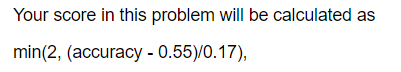

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from imblearn.over_sampling import SMOTE, ADASYN, RandomOverSampler, BorderlineSMOTE
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.pipeline import make_pipeline

import sklearn.model_selection as model_selection
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix

from sklearn.naive_bayes import GaussianNB 

from sklearn.svm import SVC
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import GridSearchCV
import statsmodels.api as sm

In [2]:
df = pd.read_csv("train.csv")
df

,target,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13
0,1,0.07,2.57,1.43,2.0,3.13,94.0,12.40,6.49,74.41,164,83,1,3
1,1,0.97,7.24,4.92,5.0,7.54,157.0,8.23,12.46,98.86,126,96,2,2
2,1,0.04,8.02,1.34,3.0,2.24,203.0,8.93,5.94,129.54,22,69,2,3
3,1,0.12,8.11,1.70,7.0,3.46,207.0,5.90,5.81,123.90,152,134,1,2
4,1,0.17,7.07,4.46,1.0,3.79,121.0,5.03,7.80,88.73,207,195,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0,0.97,0.85,1.64,0.0,7.46,111.0,13.17,18.01,84.24,61,90,1,2
996,1,0.72,5.38,4.70,5.0,6.03,132.0,6.69,22.22,90.27,204,26,3,2
997,1,0.96,0.58,4.28,1.0,7.64,149.0,16.69,21.64,104.09,180,88,2,3
998,1,0.39,4.26,2.01,6.0,4.55,105.0,5.42,11.07,73.66,63,11,1,1


### Dealing with NA

In [3]:
df.isna().sum()

target        0
feature1     26
feature2      0
feature3     24
feature4     21
feature5     25
feature6     76
feature7      0
feature8      0
feature9      0
feature10     0
feature11     0
feature12     0
feature13     0
dtype: int64

In [4]:
df = df.fillna(df.median())
df.isna().sum()

target       0
feature1     0
feature2     0
feature3     0
feature4     0
feature5     0
feature6     0
feature7     0
feature8     0
feature9     0
feature10    0
feature11    0
feature12    0
feature13    0
dtype: int64

### Finding dependencies

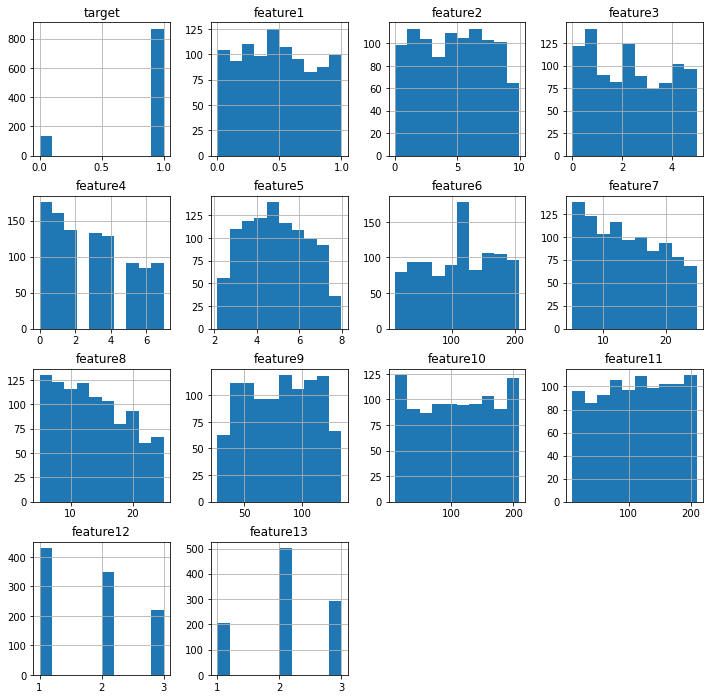

In [5]:
df.hist(figsize=(12,12));

### Feature 13 has skewed binomial distribution, feature12 resembles geometric, others look random

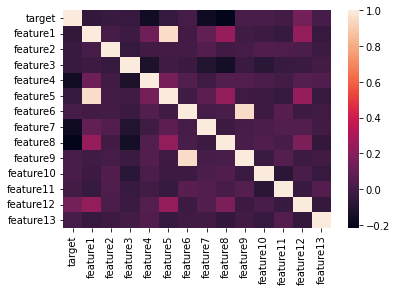

In [9]:
sns.heatmap(df.corr());

### None of features correlate with target; thus, feature engineering is needed.

### Futhermore, target class is disbalances, yet real data will confirm theoretical distribution.

In [11]:
df["target"].value_counts()

1    868
0    132
Name: target, dtype: int64

### Pairplot may give weak inference; however, let's apply oversampling techinque so we will see dependencies more clearly

### I will use SMOTE, ADASYN,  BorderlineSMOTE and RandomOversampling as smoothing bootstrap

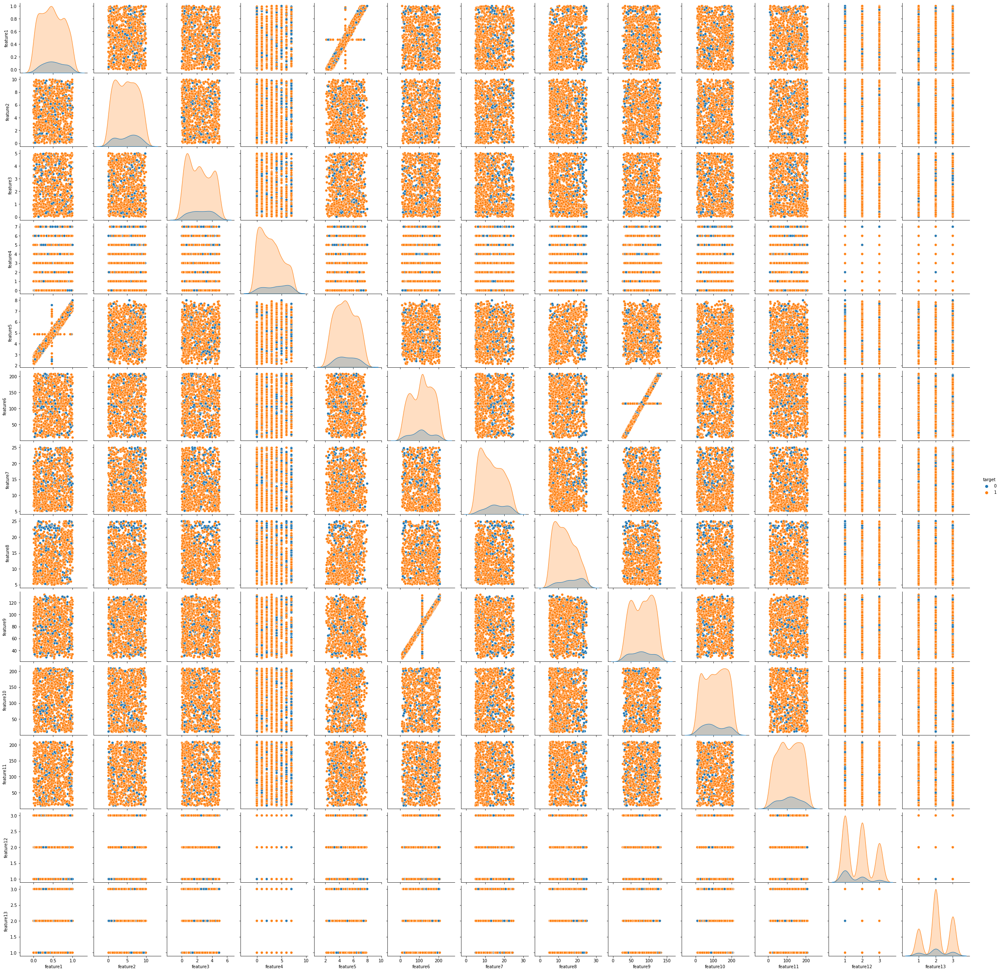

In [14]:
sns.pairplot(df, hue="target");

### no linear dependencies which seperate classes

### Creating 4 oversampling datasets

In [5]:
X = df.loc[:, df.columns != "target"]
y = df["target"]

ada = ADASYN()
smote = SMOTE()
borderSMOTE = BorderlineSMOTE()
randomSampling = RandomOverSampler(shrinkage=0.4, random_state=42)

X_ada, y_ada = ada.fit_resample(X, y)
X_smote, y_smote = ada.fit_resample(X, y)
X_border_smote, y_border_smote = ada.fit_resample(X, y)
X_rand, y_rand = ada.fit_resample(X, y)
print(y_ada.value_counts(), "\n", y_smote.value_counts(), "\n", y_border_smote.value_counts(), "\n", y_rand.value_counts())

0    886
1    868
Name: target, dtype: int64 
 0    886
1    868
Name: target, dtype: int64 
 0    886
1    868
Name: target, dtype: int64 
 0    886
1    868
Name: target, dtype: int64


In [6]:
df_ada = pd.concat([y_ada, X_ada], axis=1, join='inner')
df_smote = pd.concat([y_smote, X_smote], axis=1, join='inner')
df_bordersmote = pd.concat([y_border_smote, X_border_smote], axis=1, join='inner')
df_random = pd.concat([y_rand, X_rand], axis=1, join='inner')

### ADASYN

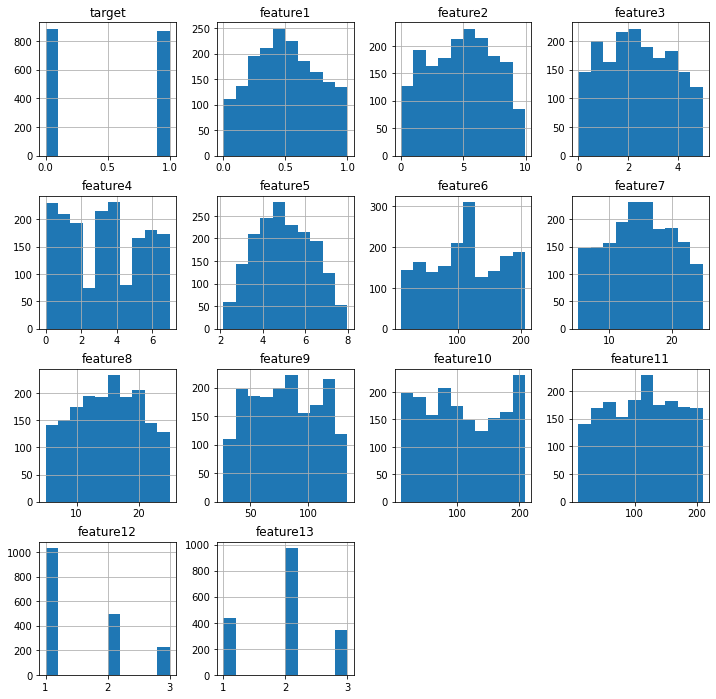

In [34]:
df_ada.hist(figsize=(12,12));

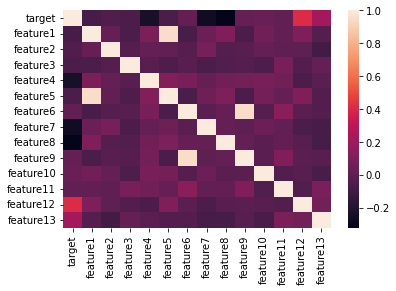

In [31]:
sns.heatmap(df_ada.corr());

In [167]:
df_ada.describe()

,target,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,feature10,feature11,feature12,feature13
count,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000
mean,0.494869,0.499044,4.887897,2.415576,3.326907,4.990586,111.601926,14.905748,15.020644,80.335968,108.312999,111.705245,1.540479,1.945838
std,0.500116,0.257803,2.595271,1.346057,2.167989,1.330314,54.481074,5.296746,5.304694,28.555941,60.009170,55.625493,0.713182,0.664414
min,0.000000,0.000000,0.010000,0.010000,0.000000,2.140000,10.000000,5.020000,5.000000,26.760000,10.000000,10.000000,1.000000,1.000000
25%,0.000000,0.300000,2.672500,1.300000,1.397213,3.950000,68.960729,10.848658,10.630000,55.246110,56.000000,65.000000,1.000000,2.000000
50%,0.000000,0.480000,5.009677,2.340000,3.075738,4.898209,113.952813,14.958539,15.141957,80.224119,101.000000,115.000000,1.000000,2.000000
75%,1.000000,0.704071,6.957500,3.543389,5.000000,6.052391,157.750000,19.104153,19.367500,105.697500,165.000000,157.750000,2.000000,2.000000
max,1.000000,1.000000,9.960000,5.000000,7.000000,7.990000,207.000000,24.970000,25.000000,133.430000,209.000000,209.000000,3.000000,3.000000


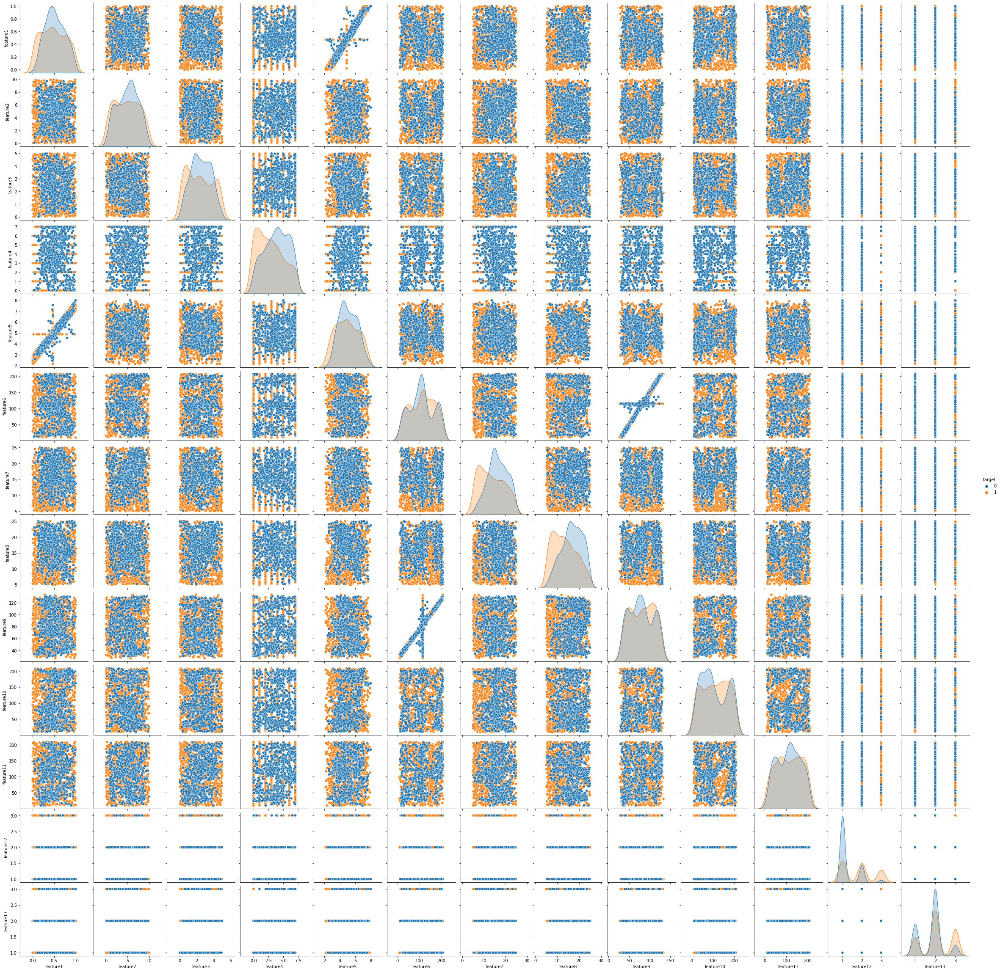

In [25]:
sns.pairplot(df_ada, hue="target");

### SMOTE

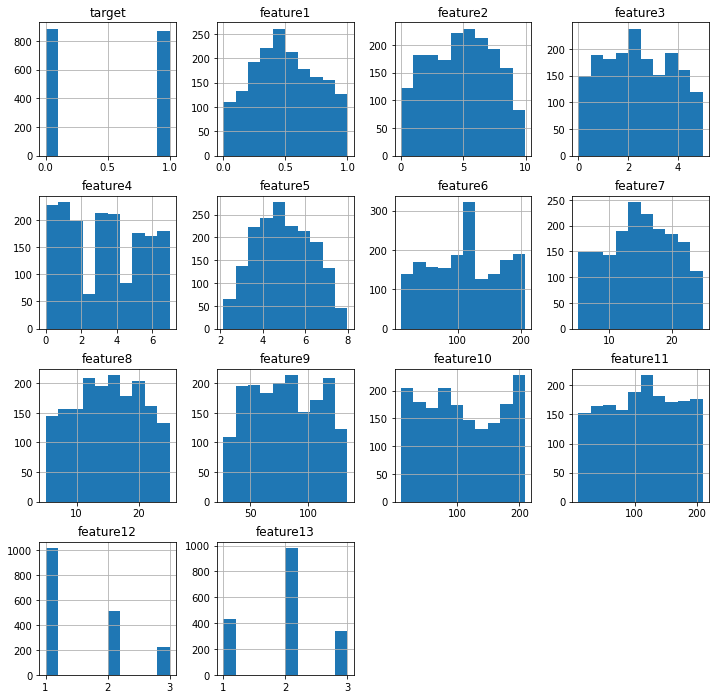

In [35]:
df_smote.hist(figsize=(12,12));

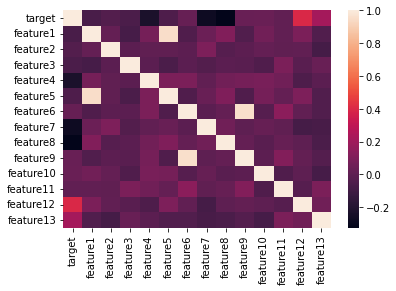

In [38]:
sns.heatmap(df_smote.corr());

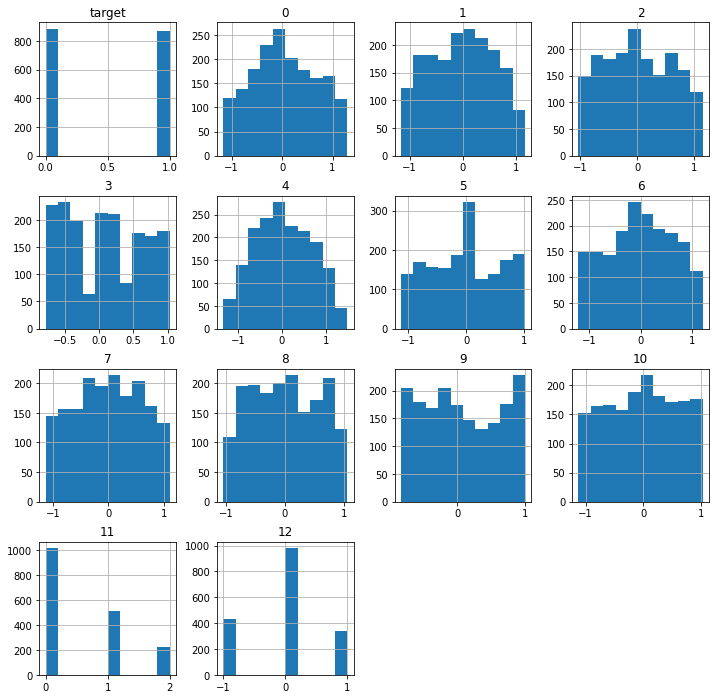

In [184]:
scaler_smote = RobustScaler()
df_smote_scaled = pd.DataFrame(scaler_smote.fit_transform(df_smote.loc[:, df.columns != "target"].to_numpy()))
df_smote_scaled = pd.concat([df_smote["target"], df_smote_scaled], axis=1, join='inner')
df_smote_scaled.hist(figsize=(12,12));

In [173]:
df_smote_scaled.describe()

,target,0,1,2,3,4,5,6,7,8,9,10,11,12
count,1754.000000,1.754000e+03,1.754000e+03,1754.000000,1.754000e+03,1.754000e+03,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000,1754.000000
mean,0.494869,5.804424e-02,-2.578955e-02,0.029612,7.674511e-02,3.908704e-02,-0.031239,-0.004841,-0.004979,0.009241,0.075571,-0.024151,0.548461,-0.053022
std,0.500116,6.337735e-01,6.043745e-01,0.592167,5.636527e-01,6.459425e-01,0.593912,0.640070,0.603119,0.565662,0.553789,0.603624,0.710279,0.661926
min,0.000000,-1.168622e+00,-1.164945e+00,-1.025632,-7.758613e-01,-1.335662e+00,-1.130435,-1.209814,-1.132494,-1.048833,-0.827586,-1.121294,0.000000,-1.000000
25%,0.000000,-4.280749e-01,-5.369197e-01,-0.466061,-4.887035e-01,-4.656920e-01,-0.532609,-0.486364,-0.490702,-0.487927,-0.411494,-0.528302,0.000000,0.000000
50%,0.000000,6.841316e-17,-1.041918e-16,0.000000,-5.716128e-17,2.149973e-16,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,5.719251e-01,4.630803e-01,0.533939,5.112965e-01,5.343080e-01,0.467391,0.513636,0.509298,0.512073,0.588506,0.471698,1.000000,0.000000
max,1.000000,1.295262e+00,1.169184e+00,1.151663,1.026160e+00,1.496832e+00,1.010870,1.205721,1.109002,1.063130,1.002299,1.024259,2.000000,1.000000


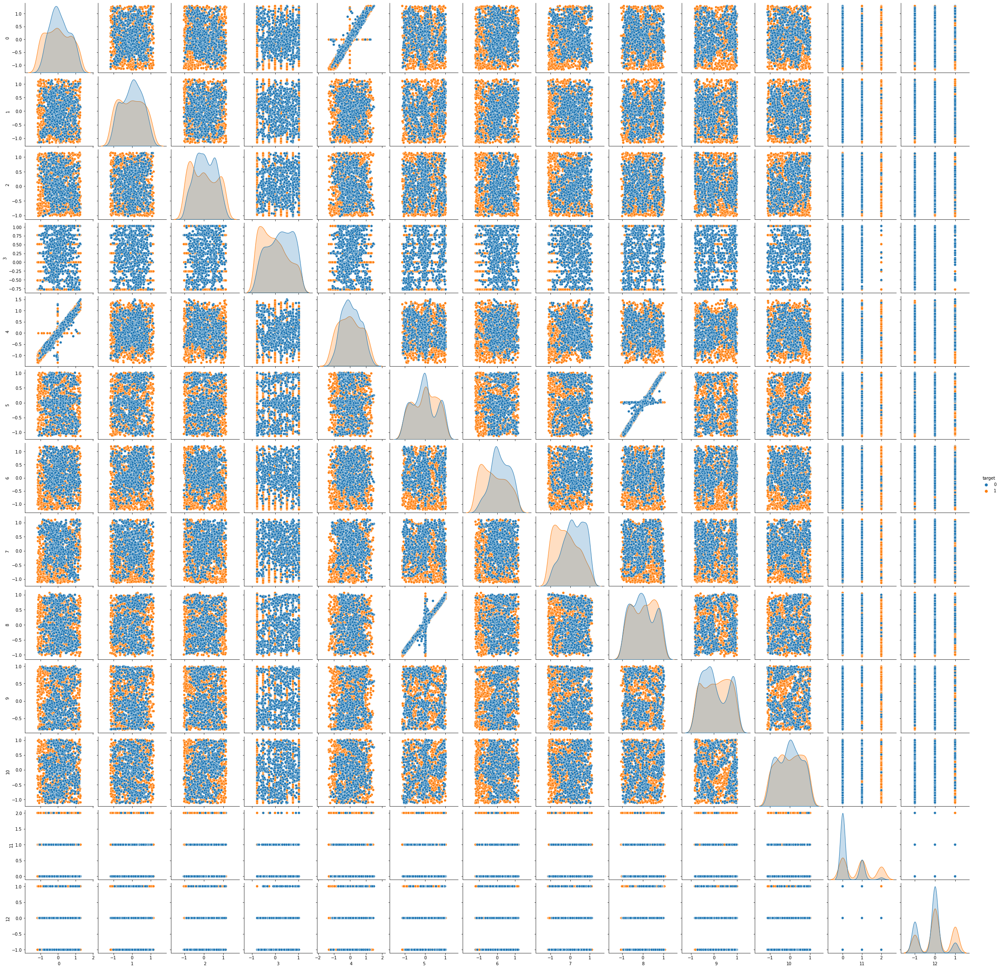

In [170]:
sns.pairplot(df_smote_scaled, hue="target");

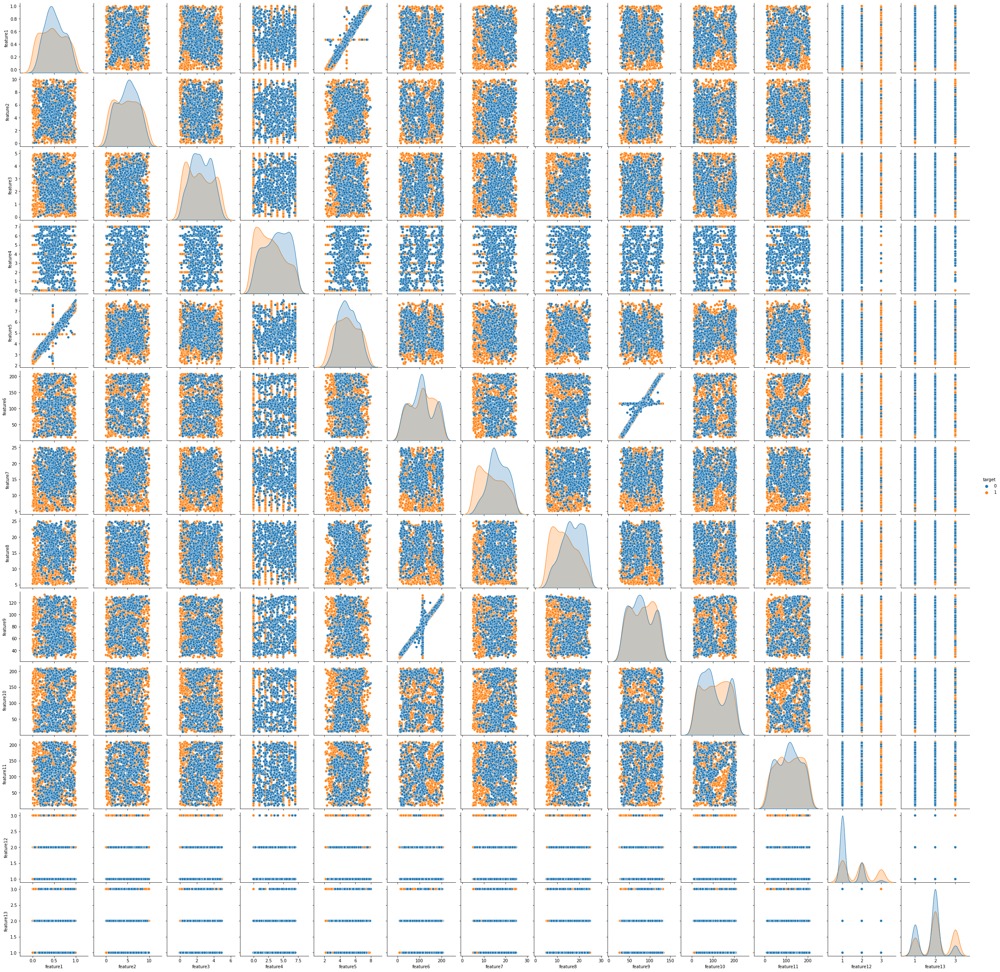

In [27]:
sns.pairplot(df_smote, hue="target");

In [223]:
df_smote_squared = df_smote.loc[:, df.columns != "target"] ** 2
df_smote_log = np.log(df_smote.loc[:, df.columns != "target"] + 1) 

df_smote_log.columns = df_smote_log.columns + " log"
df_smote_squared.columns = df_smote_squared.columns + " sqr"
df_smote_f = pd.concat([df_smote, df_smote_log, df_smote_squared], axis=1, join='inner')
df_smote_f

,target,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,...,feature4 sqr,feature5 sqr,feature6 sqr,feature7 sqr,feature8 sqr,feature9 sqr,feature10 sqr,feature11 sqr,feature12 sqr,feature13 sqr
0,1,0.070000,2.570000,1.430000,2.000000,3.130000,94.000000,12.400000,6.490000,74.410000,...,4.000000,9.796900,8836.000000,153.760000,42.120100,5536.848100,26896,6889,1,9
1,1,0.970000,7.240000,4.920000,5.000000,7.540000,157.000000,8.230000,12.460000,98.860000,...,25.000000,56.851600,24649.000000,67.732900,155.251600,9773.299600,15876,9216,4,4
2,1,0.040000,8.020000,1.340000,3.000000,2.240000,203.000000,8.930000,5.940000,129.540000,...,9.000000,5.017600,41209.000000,79.744900,35.283600,16780.611600,484,4761,4,9
3,1,0.120000,8.110000,1.700000,7.000000,3.460000,207.000000,5.900000,5.810000,123.900000,...,49.000000,11.971600,42849.000000,34.810000,33.756100,15351.210000,23104,17956,1,4
4,1,0.170000,7.070000,4.460000,1.000000,3.790000,121.000000,5.030000,7.800000,88.730000,...,1.000000,14.364100,14641.000000,25.300900,60.840000,7873.012900,42849,38025,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1749,0,0.649052,3.225845,2.306904,2.084075,5.642687,112.667260,14.933127,15.213172,88.262264,...,4.343368,31.839914,12693.911447,222.998291,231.440589,7790.227325,3025,6400,1,4
1750,0,0.970000,1.694133,0.945812,0.555350,7.465554,118.774907,17.573929,21.780830,85.656144,...,0.308414,55.734489,14107.478460,308.842991,474.404544,7336.974957,2401,6241,1,4
1751,0,0.969345,0.852600,1.638650,0.007054,7.456785,111.008062,13.173366,18.007723,84.235304,...,0.000050,55.603648,12322.789773,173.537566,324.278072,7095.586445,3721,8100,1,4
1752,0,0.453536,2.899963,0.575290,5.561916,4.925355,117.356475,15.823828,16.214296,80.537353,...,30.934909,24.259126,13772.542318,250.393548,262.903385,6486.265241,7569,10201,1,4


### BorderSmote

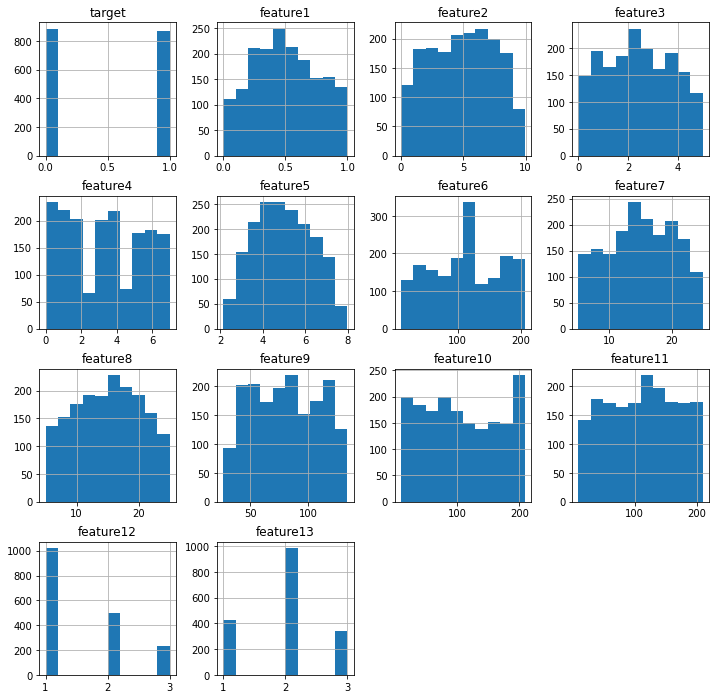

In [37]:
df_bordersmote.hist(figsize=(12,12));

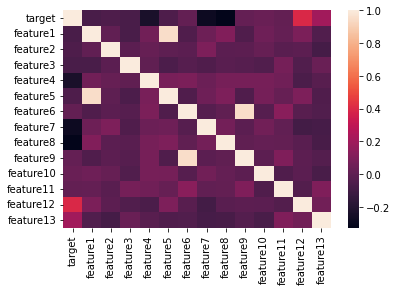

In [39]:
sns.heatmap(df_bordersmote.corr());

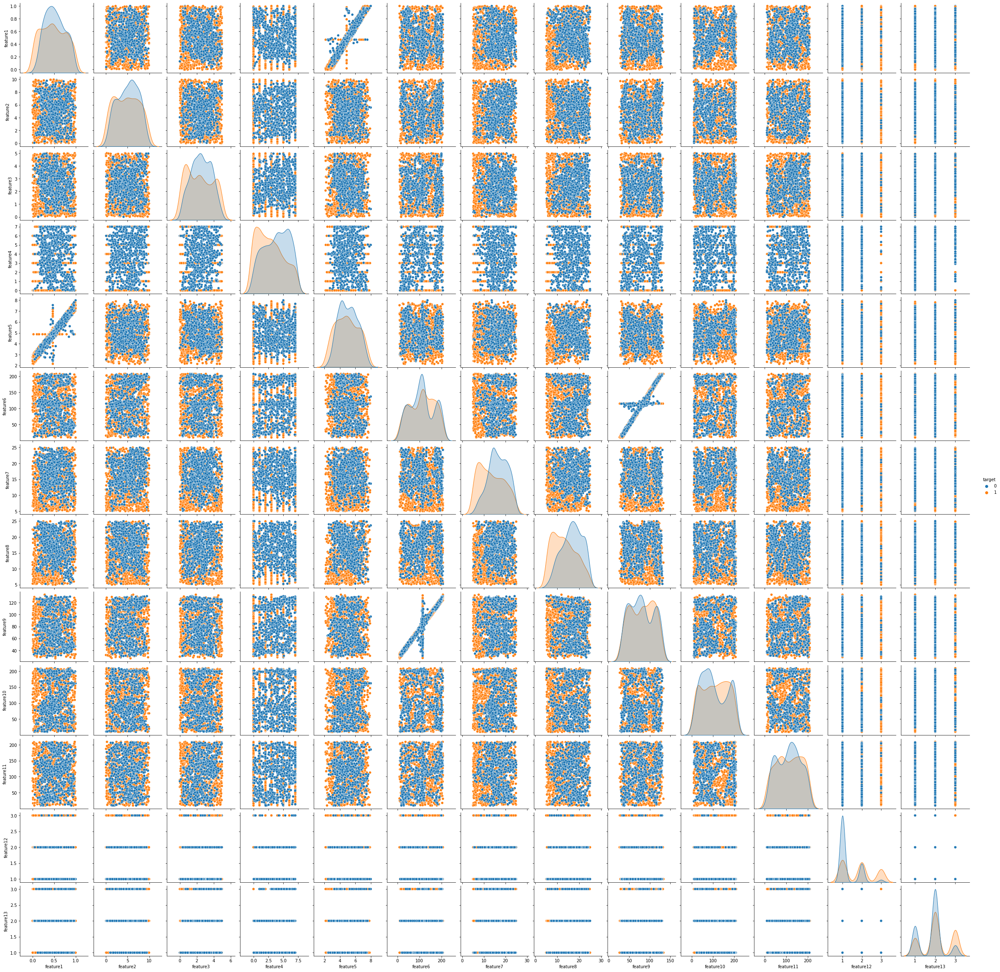

In [28]:
sns.pairplot(df_bordersmote, hue="target");

### Bootstrap smooting

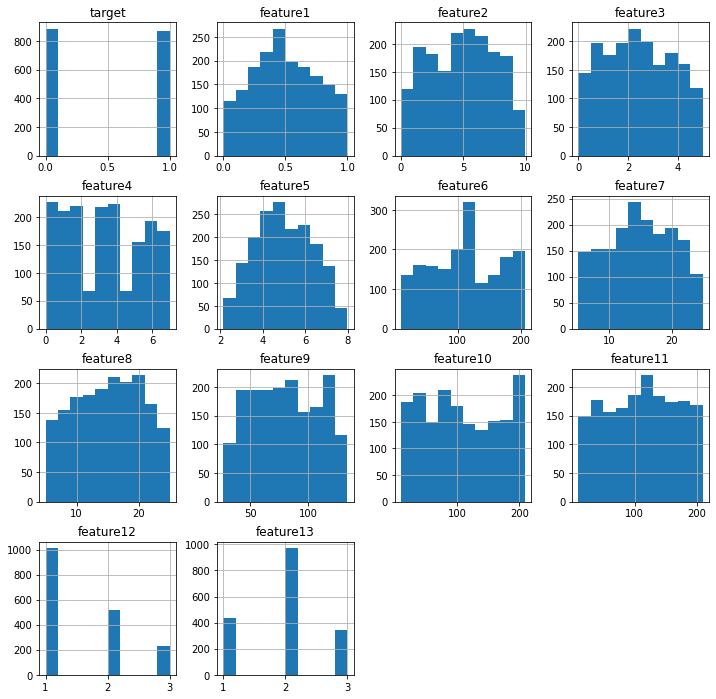

In [40]:
df_random.hist(figsize=(12,12));

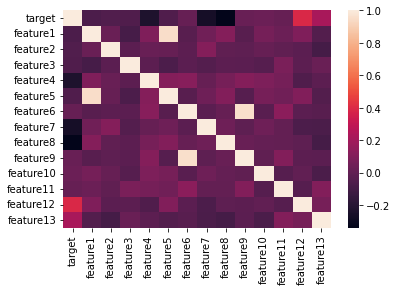

In [41]:
sns.heatmap(df_random.corr());

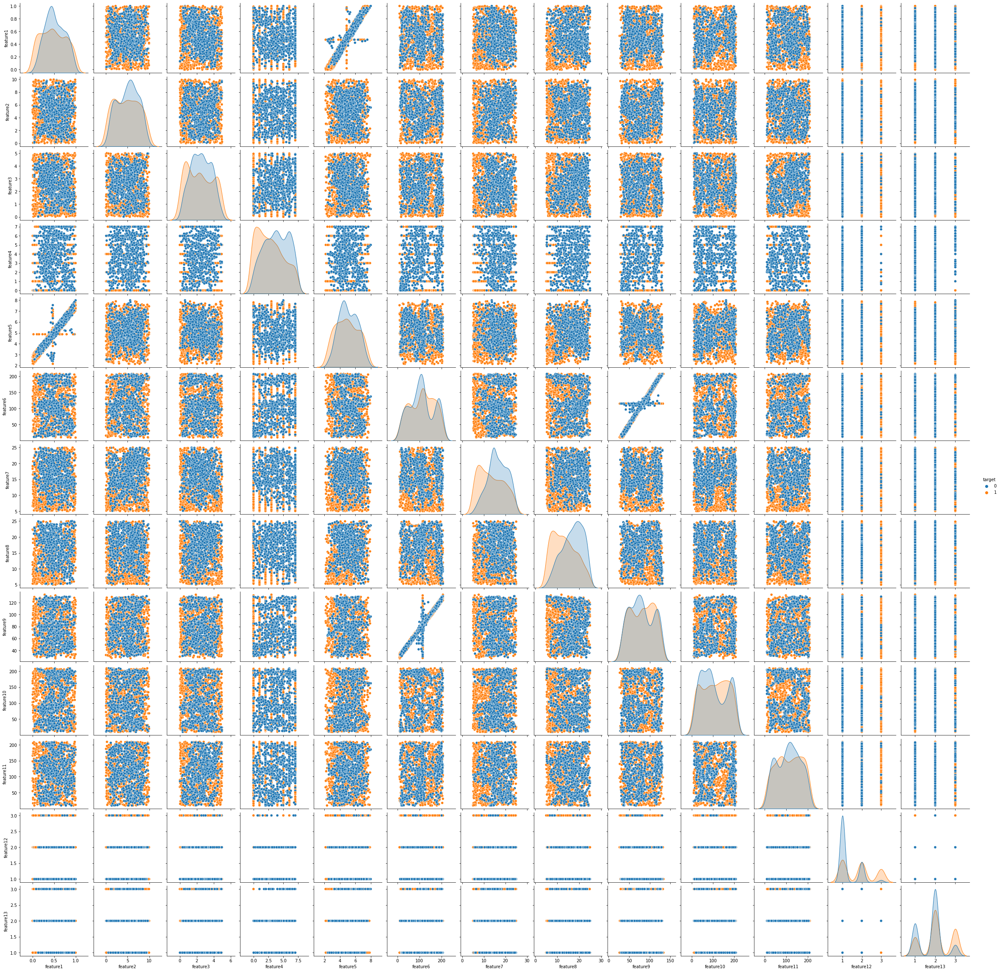

In [30]:
sns.pairplot(df_random, hue="target");

### All oversampling methoods made real distributions of target, yet correlation matrix shows no correlation between target and any feature; therefore, feature engineering and nonlinear models are needed

# Model training section

### Fully connected neural network

In [9]:
X_ada_train, X_ada_test, y_ada_train, y_ada_test = train_test_split(X_ada, y_ada, test_size=0.2, random_state=42)
X_smote_train, X_smote_test, y_smote_train, y_smote_test = train_test_split(X_smote, y_smote, test_size=0.2, random_state=42)
X_border_train, X_border_test, y_border_train, y_border_test = train_test_split(X_border_smote, y_border_smote, test_size=0.2, random_state=42)
X_rand_train, X_rand_test, y_rand_train, y_rand_test = train_test_split(X_rand, y_rand, test_size=0.2, random_state=42)

In [49]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

n_epochs = 15
batch_size_train = 64
batch_size_test = len(y_ada_test)
learning_rate = 0.01
log_interval = 10

random_seed = 42
torch.backends.cudnn.enabled = False
torch.manual_seed(random_seed)

In [11]:
class GalaxyDataset(Dataset):
 
    def __init__(self,X, y, scaler=None):

        if scaler is None:
            self.X = X.to_numpy()
            self.y = y.to_numpy()
        else:
            self.X = scaler.fit_transform(X.to_numpy())
            self.y = y.to_numpy()

        self.x_train=torch.tensor(self.X,dtype=torch.float32)
        self.y_train=torch.tensor(self.y,dtype=torch.long)
 
    def __len__(self):
        return len(self.y_train)
   
    def __getitem__(self,idx):
        return self.x_train[idx],self.y_train[idx]

In [36]:
train_dataset = GalaxyDataset(X_ada_train, y_ada_train, RobustScaler())
test_dataset = GalaxyDataset(X_ada_test, y_ada_test, RobustScaler())

train_loader=DataLoader(train_dataset, batch_size=batch_size_train, shuffle=True)
test_loader=DataLoader(test_dataset, batch_size=batch_size_test, shuffle=True)

In [153]:
class GalaxyNN(nn.Module):
    def __init__(self):
        super(GalaxyNN, self).__init__()
        
        self.layers = torch.nn.Sequential()
        self.layers.add_module("linear1", nn.Linear(13, 40))
        self.layers.add_module('relu1', torch.nn.LeakyReLU())
        self.layers.add_module("linear2", nn.Linear(40, 30))
        self.layers.add_module('relu2', torch.nn.LeakyReLU())
        self.layers.add_module("linear3", nn.Linear(30, 20))
        self.layers.add_module('relu3', torch.nn.LeakyReLU())
        self.layers.add_module("linear4", nn.Linear(20, 20))
        self.layers.add_module('relu4', torch.nn.LeakyReLU())
        self.layers.add_module("linear5", nn.Linear(20, 2))
        self.layers.add_module('softmax', torch.nn.LogSoftmax())
        
    def forward(self, x):
        return self.layers(x)

In [154]:
network = GalaxyNN()
optimizer = optim.Adam(network.parameters(), weight_decay=0.01)

In [155]:
train_losses = []
train_counter = []
test_losses = []
test_counter = [i*len(train_loader.dataset) for i in range(n_epochs + 1)]

In [42]:
def train(epoch):
    network.train()
    for batch_idx, (data, target) in enumerate(train_loader):
        optimizer.zero_grad()
        output = network(data)
        loss = F.nll_loss(output, target) # negative log likelihood loss
        loss.backward()
        optimizer.step()
        if batch_idx % log_interval == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                epoch, batch_idx * len(data), len(train_loader.dataset),
                100. * batch_idx / len(train_loader), loss.item())
            )
            train_losses.append(loss.item())
            train_counter.append(
                (batch_idx*64) + ((epoch-1)*len(train_loader.dataset))
            )
    #torch.save(network.state_dict(), '/results/model.pth')
    #torch.save(optimizer.state_dict(), '/results/optimizer.pth')

In [43]:
def test():
    network.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in test_loader:
            output = network(data)
            test_loss += F.nll_loss(output, target, size_average=False).item()
            pred = output.data.max(1, keepdim=True)[1]
            correct += pred.eq(target.data.view_as(pred)).sum()
    test_loss /= len(test_loader.dataset)
    test_losses.append(test_loss)
    print('\nTest set: Avg. loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, len(test_loader.dataset),
        100. * correct / len(test_loader.dataset))
    )

### Training

In [158]:
test()
for epoch in range(1, n_epochs + 1):
    train(epoch)
    test()


Test set: Avg. loss: 0.6944, Accuracy: 168/351 (48%)

Train Epoch: 1 [0/1403 (0%)]	Loss: 0.691122
Train Epoch: 1 [640/1403 (45%)]	Loss: 0.696170
Train Epoch: 1 [1280/1403 (91%)]	Loss: 0.693612

Test set: Avg. loss: 0.6933, Accuracy: 167/351 (48%)

Train Epoch: 2 [0/1403 (0%)]	Loss: 0.691377
Train Epoch: 2 [640/1403 (45%)]	Loss: 0.690359
Train Epoch: 2 [1280/1403 (91%)]	Loss: 0.694821

Test set: Avg. loss: 0.6934, Accuracy: 166/351 (47%)

Train Epoch: 3 [0/1403 (0%)]	Loss: 0.689026
Train Epoch: 3 [640/1403 (45%)]	Loss: 0.686218
Train Epoch: 3 [1280/1403 (91%)]	Loss: 0.691338

Test set: Avg. loss: 0.6933, Accuracy: 166/351 (47%)

Train Epoch: 4 [0/1403 (0%)]	Loss: 0.690796
Train Epoch: 4 [640/1403 (45%)]	Loss: 0.689438
Train Epoch: 4 [1280/1403 (91%)]	Loss: 0.694171

Test set: Avg. loss: 0.6926, Accuracy: 166/351 (47%)

Train Epoch: 5 [0/1403 (0%)]	Loss: 0.693436
Train Epoch: 5 [640/1403 (45%)]	Loss: 0.693335
Train Epoch: 5 [1280/1403 (91%)]	Loss: 0.689917

Test set: Avg. loss: 0.6917, 

Train Epoch: 42 [1280/1403 (91%)]	Loss: 0.146301

Test set: Avg. loss: 0.1792, Accuracy: 330/351 (94%)

Train Epoch: 43 [0/1403 (0%)]	Loss: 0.062109
Train Epoch: 43 [640/1403 (45%)]	Loss: 0.111398
Train Epoch: 43 [1280/1403 (91%)]	Loss: 0.176446

Test set: Avg. loss: 0.1836, Accuracy: 328/351 (93%)

Train Epoch: 44 [0/1403 (0%)]	Loss: 0.065524
Train Epoch: 44 [640/1403 (45%)]	Loss: 0.062454
Train Epoch: 44 [1280/1403 (91%)]	Loss: 0.119564

Test set: Avg. loss: 0.1749, Accuracy: 328/351 (93%)

Train Epoch: 45 [0/1403 (0%)]	Loss: 0.057345
Train Epoch: 45 [640/1403 (45%)]	Loss: 0.120918
Train Epoch: 45 [1280/1403 (91%)]	Loss: 0.049967

Test set: Avg. loss: 0.1758, Accuracy: 328/351 (93%)

Train Epoch: 46 [0/1403 (0%)]	Loss: 0.098440
Train Epoch: 46 [640/1403 (45%)]	Loss: 0.166106
Train Epoch: 46 [1280/1403 (91%)]	Loss: 0.060988

Test set: Avg. loss: 0.1698, Accuracy: 331/351 (94%)

Train Epoch: 47 [0/1403 (0%)]	Loss: 0.076650
Train Epoch: 47 [640/1403 (45%)]	Loss: 0.075090
Train Epoch: 47

Train Epoch: 86 [640/1403 (45%)]	Loss: 0.040834
Train Epoch: 86 [1280/1403 (91%)]	Loss: 0.057905

Test set: Avg. loss: 0.1492, Accuracy: 336/351 (96%)

Train Epoch: 87 [0/1403 (0%)]	Loss: 0.047978
Train Epoch: 87 [640/1403 (45%)]	Loss: 0.045166
Train Epoch: 87 [1280/1403 (91%)]	Loss: 0.101472

Test set: Avg. loss: 0.1498, Accuracy: 338/351 (96%)

Train Epoch: 88 [0/1403 (0%)]	Loss: 0.037292
Train Epoch: 88 [640/1403 (45%)]	Loss: 0.034371
Train Epoch: 88 [1280/1403 (91%)]	Loss: 0.067612

Test set: Avg. loss: 0.1485, Accuracy: 337/351 (96%)

Train Epoch: 89 [0/1403 (0%)]	Loss: 0.039262
Train Epoch: 89 [640/1403 (45%)]	Loss: 0.092535
Train Epoch: 89 [1280/1403 (91%)]	Loss: 0.048843

Test set: Avg. loss: 0.1438, Accuracy: 338/351 (96%)

Train Epoch: 90 [0/1403 (0%)]	Loss: 0.040965
Train Epoch: 90 [640/1403 (45%)]	Loss: 0.116905
Train Epoch: 90 [1280/1403 (91%)]	Loss: 0.091004

Test set: Avg. loss: 0.1456, Accuracy: 338/351 (96%)

Train Epoch: 91 [0/1403 (0%)]	Loss: 0.023163
Train Epoch: 91

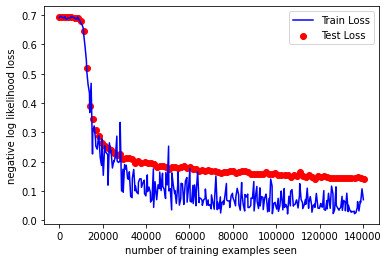

In [159]:
fig = plt.figure()
plt.plot(train_counter, train_losses, color='blue')
plt.scatter(test_counter, test_losses, color='red')
plt.legend(['Train Loss', 'Test Loss'], loc='upper right')
plt.xlabel('number of training examples seen')
plt.ylabel('negative log likelihood loss');

### Validation dataset

In [160]:
test = pd.read_csv("test.csv", index_col="Id")
test.isna().sum()

feature1     21231
feature2         0
feature3     19955
feature4     19949
feature5     24948
feature6     99826
feature7         0
feature8         0
feature9         0
feature10        0
feature11        0
feature12        0
feature13        0
dtype: int64

In [161]:
test = test.fillna(test.median())
scaler = RobustScaler()
test = scaler.fit_transform(test)
test = torch.tensor(test, dtype=torch.float32)

In [162]:
network.eval()
predictions = None

with torch.no_grad():
    output = network(test)
    predictions = output.data.max(1, keepdim=True)[1]
    
answers = pd.DataFrame(predictions.numpy())
answers

C:\Users\1\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


,0
0,0
1,0
2,1
3,0
4,0
...,...
997995,0
997996,0
997997,0
997998,0


In [163]:
ans = pd.read_csv("sample_submission.csv")
ans

,target,Id
0,0,0
1,0,1
2,0,2
3,0,3
4,0,4
...,...,...
997995,0,997995
997996,0,997996
997997,0,997997
997998,0,997998


In [165]:
ans["target"] = answers
ans.to_csv("sln.csv", index=False)

### Deeper network

In [44]:
class DeepGalaxyNN(nn.Module):
    def __init__(self):
        super(DeepGalaxyNN, self).__init__()
        
        self.layers = torch.nn.Sequential()
        self.layers.add_module("linear1", nn.Linear(13, 40))
        self.layers.add_module('relu1', torch.nn.LeakyReLU())
        self.layers.add_module("linear2", nn.Linear(40, 35))
        self.layers.add_module('relu2', torch.nn.LeakyReLU())
        self.layers.add_module("linear3", nn.Linear(35, 30))
        self.layers.add_module('relu3', torch.nn.LeakyReLU())
        self.layers.add_module("linear4", nn.Linear(30, 25))
        self.layers.add_module('relu4', torch.nn.LeakyReLU())
        self.layers.add_module("linear5", nn.Linear(25, 20))
        self.layers.add_module('relu5', torch.nn.LeakyReLU())
        self.layers.add_module("linear6", nn.Linear(20, 18))
        self.layers.add_module('relu6', torch.nn.LeakyReLU())
        self.layers.add_module("linear7", nn.Linear(18, 15))
        self.layers.add_module('relu7', torch.nn.LeakyReLU())
        self.layers.add_module("linear8", nn.Linear(15, 12))
        self.layers.add_module('relu8', torch.nn.LeakyReLU())
        self.layers.add_module("linear9", nn.Linear(12, 10))
        self.layers.add_module('relu9', torch.nn.LeakyReLU())
        self.layers.add_module("linear10", nn.Linear(10, 10))
        self.layers.add_module('relu10', torch.nn.LeakyReLU())
        self.layers.add_module("linear11", nn.Linear(10, 10))
        self.layers.add_module('relu11', torch.nn.LeakyReLU())
        self.layers.add_module("linear12", nn.Linear(10, 2))
        self.layers.add_module('softmax', torch.nn.LogSoftmax())
        
    def forward(self, x):
        return self.layers(x)

In [45]:
network = DeepGalaxyNN()
optimizer = optim.NAdam(network.parameters())

In [46]:
train_losses = []
train_counter = []
test_losses = []
test_counter = [i*len(train_loader.dataset) for i in range(n_epochs + 1)]

### Training

In [47]:
test()
for epoch in range(1, n_epochs + 1):
    train(epoch)
    test()

C:\Users\1\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)
C:\Users\1\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\nn\_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))



Test set: Avg. loss: 0.6919, Accuracy: 185/351 (53%)

Train Epoch: 1 [0/1403 (0%)]	Loss: 0.710537
Train Epoch: 1 [640/1403 (45%)]	Loss: 0.697790
Train Epoch: 1 [1280/1403 (91%)]	Loss: 0.697878

Test set: Avg. loss: 0.6917, Accuracy: 185/351 (53%)

Train Epoch: 2 [0/1403 (0%)]	Loss: 0.693652
Train Epoch: 2 [640/1403 (45%)]	Loss: 0.685617
Train Epoch: 2 [1280/1403 (91%)]	Loss: 0.611363

Test set: Avg. loss: 0.5935, Accuracy: 294/351 (84%)

Train Epoch: 3 [0/1403 (0%)]	Loss: 0.562663
Train Epoch: 3 [640/1403 (45%)]	Loss: 0.517421
Train Epoch: 3 [1280/1403 (91%)]	Loss: 0.291224

Test set: Avg. loss: 0.3961, Accuracy: 295/351 (84%)

Train Epoch: 4 [0/1403 (0%)]	Loss: 0.376497
Train Epoch: 4 [640/1403 (45%)]	Loss: 0.331676
Train Epoch: 4 [1280/1403 (91%)]	Loss: 0.213062

Test set: Avg. loss: 0.3325, Accuracy: 309/351 (88%)

Train Epoch: 5 [0/1403 (0%)]	Loss: 0.298088
Train Epoch: 5 [640/1403 (45%)]	Loss: 0.285265
Train Epoch: 5 [1280/1403 (91%)]	Loss: 0.192170

Test set: Avg. loss: 0.3107, 

Train Epoch: 43 [1280/1403 (91%)]	Loss: 0.002419

Test set: Avg. loss: 0.4987, Accuracy: 335/351 (95%)

Train Epoch: 44 [0/1403 (0%)]	Loss: 0.002213
Train Epoch: 44 [640/1403 (45%)]	Loss: 0.000144
Train Epoch: 44 [1280/1403 (91%)]	Loss: 0.000459

Test set: Avg. loss: 0.5219, Accuracy: 335/351 (95%)

Train Epoch: 45 [0/1403 (0%)]	Loss: 0.000042
Train Epoch: 45 [640/1403 (45%)]	Loss: 0.000101
Train Epoch: 45 [1280/1403 (91%)]	Loss: 0.001412

Test set: Avg. loss: 0.5405, Accuracy: 335/351 (95%)

Train Epoch: 46 [0/1403 (0%)]	Loss: 0.000236
Train Epoch: 46 [640/1403 (45%)]	Loss: 0.000445
Train Epoch: 46 [1280/1403 (91%)]	Loss: 0.000095

Test set: Avg. loss: 0.5583, Accuracy: 335/351 (95%)

Train Epoch: 47 [0/1403 (0%)]	Loss: 0.000125
Train Epoch: 47 [640/1403 (45%)]	Loss: 0.001098
Train Epoch: 47 [1280/1403 (91%)]	Loss: 0.000023

Test set: Avg. loss: 0.5751, Accuracy: 335/351 (95%)

Train Epoch: 48 [0/1403 (0%)]	Loss: 0.000279
Train Epoch: 48 [640/1403 (45%)]	Loss: 0.000174
Train Epoch: 48

Train Epoch: 85 [640/1403 (45%)]	Loss: 0.000002
Train Epoch: 85 [1280/1403 (91%)]	Loss: 0.000000

Test set: Avg. loss: 0.8529, Accuracy: 334/351 (95%)

Train Epoch: 86 [0/1403 (0%)]	Loss: 0.000003
Train Epoch: 86 [640/1403 (45%)]	Loss: 0.000003
Train Epoch: 86 [1280/1403 (91%)]	Loss: 0.000003

Test set: Avg. loss: 0.8567, Accuracy: 334/351 (95%)

Train Epoch: 87 [0/1403 (0%)]	Loss: 0.000002
Train Epoch: 87 [640/1403 (45%)]	Loss: 0.000001
Train Epoch: 87 [1280/1403 (91%)]	Loss: 0.000013

Test set: Avg. loss: 0.8605, Accuracy: 334/351 (95%)

Train Epoch: 88 [0/1403 (0%)]	Loss: 0.000001
Train Epoch: 88 [640/1403 (45%)]	Loss: 0.000000
Train Epoch: 88 [1280/1403 (91%)]	Loss: 0.000058

Test set: Avg. loss: 0.8636, Accuracy: 334/351 (95%)

Train Epoch: 89 [0/1403 (0%)]	Loss: 0.000006
Train Epoch: 89 [640/1403 (45%)]	Loss: 0.000002
Train Epoch: 89 [1280/1403 (91%)]	Loss: 0.000005

Test set: Avg. loss: 0.8671, Accuracy: 334/351 (95%)

Train Epoch: 90 [0/1403 (0%)]	Loss: 0.000001
Train Epoch: 90

### Validation dataset

In [50]:
test = pd.read_csv("test.csv", index_col="Id")
test.isna().sum()

feature1     21231
feature2         0
feature3     19955
feature4     19949
feature5     24948
feature6     99826
feature7         0
feature8         0
feature9         0
feature10        0
feature11        0
feature12        0
feature13        0
dtype: int64

In [51]:
test = test.fillna(test.median())
scaler = RobustScaler()
test = scaler.fit_transform(test)
test = torch.tensor(test, dtype=torch.float32)

network.eval()
predictions = None

with torch.no_grad():
    output = network(test)
    predictions = output.data.max(1, keepdim=True)[1]
    
answers = pd.DataFrame(predictions.numpy())
answers

C:\Users\1\AppData\Local\Programs\Python\Python39\lib\site-packages\torch\nn\modules\container.py:139: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


,0
0,0
1,0
2,1
3,0
4,0
...,...
997995,0
997996,1
997997,0
997998,0


In [52]:
ans = pd.read_csv("sample_submission.csv")
ans["target"] = answers
ans.to_csv("deep_sln.csv", index=False)

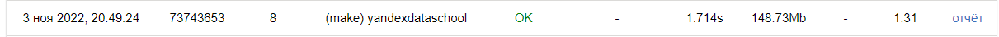

### Logistic regression

In [204]:
import warnings
warnings.filterwarnings('ignore')

Grid_params  = [
    {'solver' : ['saga'],
      'penalty' : ['elasticnet', 'l1', 'l2', 'none'],
      'max_iter' : [50,100,200,500,1000,2500],
      'C' : np.logspace(-10, 10, 20)},
    {'solver' : ['newton-cg', 'lbfgs'],
      'penalty' : ['l2','none'],
      'max_iter' : [50,100,200,500,1000,2500],
      'C' : np.logspace(-10, 10, 20)},
    ]

reg = LogisticRegression(solver="saga")
grid=GridSearchCV(reg, Grid_params)
grid.fit(X_smote_train,y_smote_train)

print(
    "The best parameters are %s with a score of %0.2f"
    % (grid.best_params_, grid.best_score_))

The best parameters are {'C': 3.359818286283774, 'max_iter': 50, 'penalty': 'l1', 'solver': 'saga'} with a score of 0.81


### SVM

In [215]:
clf = make_pipeline(StandardScaler(), SVC(gamma='auto', kernel='rbf', degree=3))
clf.fit(X_smote_train, y_smote_train)
svm_prediction = clf.predict(X_smote_test)
accuracy = clf.score(X_smote_test, y_smote_test)
accuracy

0.9316239316239316

In [216]:
test = pd.read_csv("test.csv", index_col="Id")
test = test.fillna(test.median())

In [217]:
svm_predictions = clf.predict(test)

In [218]:
ans = pd.read_csv("sample_submission.csv")
ans["target"] = svm_predictions
ans.to_csv("svm_sln.csv", index=False)

### Gaussian naive bayes

In [203]:
gnb = GaussianNB().fit(X_smote_train, y_smote_train) 
gnb_predictions = gnb.predict(X_smote_test) 
  
# accuracy on X_test 
accuracy = gnb.score(X_smote_test, y_smote_test) 
print("accuracy:", accuracy) 
  
# creating a confusion matrix 
cm = confusion_matrix(y_smote_test, gnb_predictions)
print("confusion matrix:")
print(cm)

f1 = f1_score(y_smote_test, gnb_predictions, average='weighted')
print('\nF1 (GaussianNB): ', "%.2f" % (f1*100))

accuracy: 0.7863247863247863
confusion matrix:
[[134  32]
 [ 43 142]]

F1 (GaussianNB):  78.65


### CatBoost

In [195]:
from catboost import CatBoostClassifier

cat_scaler = RobustScaler()
X_smote_train, X_smote_test, y_smote_train, y_smote_test = train_test_split(cat_scaler.fit_transform(X_smote),
                                                                            y_smote, test_size=0.2, random_state=42)
CBC = CatBoostClassifier()
CBC.fit(X_smote_train, y_smote_train)

cat_predictions = CBC.predict(X_smote_test)

accuracy = CBC.score(X_smote_test, y_smote_test) 
print("accuracy:", accuracy)   

Learning rate set to 0.011905
0:	learn: 0.6820852	total: 10.3ms	remaining: 10.2s
1:	learn: 0.6711487	total: 17.4ms	remaining: 8.66s
2:	learn: 0.6615765	total: 23.4ms	remaining: 7.79s
3:	learn: 0.6550701	total: 29.2ms	remaining: 7.28s
4:	learn: 0.6454418	total: 35ms	remaining: 6.96s
5:	learn: 0.6355158	total: 40.6ms	remaining: 6.73s
6:	learn: 0.6253598	total: 46.8ms	remaining: 6.64s
7:	learn: 0.6159145	total: 52.7ms	remaining: 6.54s
8:	learn: 0.6082395	total: 58.7ms	remaining: 6.47s
9:	learn: 0.6011630	total: 64.7ms	remaining: 6.4s
10:	learn: 0.5924794	total: 70.3ms	remaining: 6.32s
11:	learn: 0.5864359	total: 75.9ms	remaining: 6.25s
12:	learn: 0.5789550	total: 81.8ms	remaining: 6.21s
13:	learn: 0.5722352	total: 87.5ms	remaining: 6.16s
14:	learn: 0.5664112	total: 92.8ms	remaining: 6.09s
15:	learn: 0.5591478	total: 98.4ms	remaining: 6.05s
16:	learn: 0.5521989	total: 104ms	remaining: 6.04s
17:	learn: 0.5454041	total: 110ms	remaining: 6.02s
18:	learn: 0.5413174	total: 117ms	remaining: 6.03

192:	learn: 0.1977482	total: 867ms	remaining: 3.63s
193:	learn: 0.1974101	total: 872ms	remaining: 3.62s
194:	learn: 0.1966317	total: 877ms	remaining: 3.62s
195:	learn: 0.1961607	total: 881ms	remaining: 3.62s
196:	learn: 0.1954621	total: 887ms	remaining: 3.62s
197:	learn: 0.1946647	total: 894ms	remaining: 3.62s
198:	learn: 0.1942050	total: 903ms	remaining: 3.63s
199:	learn: 0.1937906	total: 909ms	remaining: 3.63s
200:	learn: 0.1931320	total: 915ms	remaining: 3.64s
201:	learn: 0.1923827	total: 920ms	remaining: 3.63s
202:	learn: 0.1919876	total: 924ms	remaining: 3.63s
203:	learn: 0.1913096	total: 929ms	remaining: 3.63s
204:	learn: 0.1907414	total: 933ms	remaining: 3.62s
205:	learn: 0.1901891	total: 938ms	remaining: 3.61s
206:	learn: 0.1897150	total: 942ms	remaining: 3.61s
207:	learn: 0.1888864	total: 947ms	remaining: 3.6s
208:	learn: 0.1884115	total: 951ms	remaining: 3.6s
209:	learn: 0.1880373	total: 956ms	remaining: 3.6s
210:	learn: 0.1868759	total: 961ms	remaining: 3.6s
211:	learn: 0.18

380:	learn: 0.1127816	total: 1.72s	remaining: 2.8s
381:	learn: 0.1124275	total: 1.73s	remaining: 2.79s
382:	learn: 0.1122745	total: 1.73s	remaining: 2.79s
383:	learn: 0.1120110	total: 1.74s	remaining: 2.78s
384:	learn: 0.1118203	total: 1.74s	remaining: 2.78s
385:	learn: 0.1115769	total: 1.74s	remaining: 2.77s
386:	learn: 0.1113659	total: 1.75s	remaining: 2.77s
387:	learn: 0.1111583	total: 1.76s	remaining: 2.77s
388:	learn: 0.1108011	total: 1.76s	remaining: 2.77s
389:	learn: 0.1106600	total: 1.77s	remaining: 2.77s
390:	learn: 0.1103195	total: 1.77s	remaining: 2.76s
391:	learn: 0.1100090	total: 1.78s	remaining: 2.76s
392:	learn: 0.1097651	total: 1.78s	remaining: 2.75s
393:	learn: 0.1096275	total: 1.8s	remaining: 2.76s
394:	learn: 0.1094156	total: 1.8s	remaining: 2.76s
395:	learn: 0.1091224	total: 1.8s	remaining: 2.75s
396:	learn: 0.1087903	total: 1.81s	remaining: 2.75s
397:	learn: 0.1084939	total: 1.82s	remaining: 2.75s
398:	learn: 0.1081433	total: 1.82s	remaining: 2.74s
399:	learn: 0.10

556:	learn: 0.0752774	total: 2.56s	remaining: 2.04s
557:	learn: 0.0751238	total: 2.57s	remaining: 2.03s
558:	learn: 0.0749564	total: 2.57s	remaining: 2.03s
559:	learn: 0.0746588	total: 2.58s	remaining: 2.02s
560:	learn: 0.0745904	total: 2.58s	remaining: 2.02s
561:	learn: 0.0744989	total: 2.59s	remaining: 2.02s
562:	learn: 0.0743187	total: 2.59s	remaining: 2.01s
563:	learn: 0.0740768	total: 2.6s	remaining: 2.01s
564:	learn: 0.0739814	total: 2.6s	remaining: 2s
565:	learn: 0.0738257	total: 2.61s	remaining: 2s
566:	learn: 0.0736496	total: 2.61s	remaining: 1.99s
567:	learn: 0.0735631	total: 2.62s	remaining: 1.99s
568:	learn: 0.0733891	total: 2.62s	remaining: 1.99s
569:	learn: 0.0732349	total: 2.63s	remaining: 1.98s
570:	learn: 0.0730325	total: 2.64s	remaining: 1.98s
571:	learn: 0.0729095	total: 2.64s	remaining: 1.98s
572:	learn: 0.0727292	total: 2.65s	remaining: 1.97s
573:	learn: 0.0724982	total: 2.65s	remaining: 1.97s
574:	learn: 0.0723477	total: 2.66s	remaining: 1.96s
575:	learn: 0.072152

715:	learn: 0.0537008	total: 3.25s	remaining: 1.29s
716:	learn: 0.0535399	total: 3.25s	remaining: 1.28s
717:	learn: 0.0534547	total: 3.26s	remaining: 1.28s
718:	learn: 0.0533838	total: 3.26s	remaining: 1.27s
719:	learn: 0.0532205	total: 3.26s	remaining: 1.27s
720:	learn: 0.0531326	total: 3.27s	remaining: 1.26s
721:	learn: 0.0530348	total: 3.27s	remaining: 1.26s
722:	learn: 0.0529123	total: 3.28s	remaining: 1.25s
723:	learn: 0.0528050	total: 3.28s	remaining: 1.25s
724:	learn: 0.0527332	total: 3.29s	remaining: 1.25s
725:	learn: 0.0526098	total: 3.29s	remaining: 1.24s
726:	learn: 0.0525172	total: 3.29s	remaining: 1.24s
727:	learn: 0.0523433	total: 3.3s	remaining: 1.23s
728:	learn: 0.0523157	total: 3.3s	remaining: 1.23s
729:	learn: 0.0522151	total: 3.31s	remaining: 1.22s
730:	learn: 0.0521664	total: 3.31s	remaining: 1.22s
731:	learn: 0.0520451	total: 3.31s	remaining: 1.21s
732:	learn: 0.0518883	total: 3.32s	remaining: 1.21s
733:	learn: 0.0517230	total: 3.32s	remaining: 1.2s
734:	learn: 0.0

890:	learn: 0.0374754	total: 3.95s	remaining: 483ms
891:	learn: 0.0373894	total: 3.95s	remaining: 479ms
892:	learn: 0.0373229	total: 3.96s	remaining: 474ms
893:	learn: 0.0372244	total: 3.96s	remaining: 470ms
894:	learn: 0.0371380	total: 3.97s	remaining: 465ms
895:	learn: 0.0370444	total: 3.97s	remaining: 461ms
896:	learn: 0.0369208	total: 3.98s	remaining: 457ms
897:	learn: 0.0368749	total: 3.98s	remaining: 452ms
898:	learn: 0.0367834	total: 3.98s	remaining: 448ms
899:	learn: 0.0367101	total: 3.99s	remaining: 443ms
900:	learn: 0.0366184	total: 3.99s	remaining: 439ms
901:	learn: 0.0365639	total: 4s	remaining: 434ms
902:	learn: 0.0364612	total: 4s	remaining: 430ms
903:	learn: 0.0364141	total: 4s	remaining: 425ms
904:	learn: 0.0363844	total: 4.01s	remaining: 421ms
905:	learn: 0.0363318	total: 4.01s	remaining: 416ms
906:	learn: 0.0362430	total: 4.01s	remaining: 412ms
907:	learn: 0.0361684	total: 4.02s	remaining: 407ms
908:	learn: 0.0361169	total: 4.02s	remaining: 403ms
909:	learn: 0.0360627

In [10]:
test = pd.read_csv("test.csv", index_col="Id")
test.isna().sum()

feature1     21231
feature2         0
feature3     19955
feature4     19949
feature5     24948
feature6     99826
feature7         0
feature8         0
feature9         0
feature10        0
feature11        0
feature12        0
feature13        0
dtype: int64

In [11]:
test = test.fillna(test.median())
scaler = StandardScaler()
test = scaler.fit_transform(test)

In [200]:
cat_predictions = CBC.predict(test)
len(cat_predictions)

998000

In [201]:
ans = pd.read_csv("sample_submission.csv")
ans["target"] = cat_predictions
ans.to_csv("cat_sln.csv", index=False)

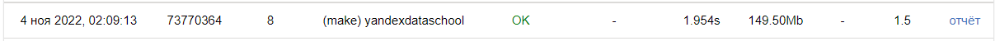

### cat boost with feature engineering (bad performance because a lot of noise)

In [228]:
cat_scaler = StandardScaler()

X_smote_train_f, X_smote_test_f, y_smote_train_f, y_smote_test_f = train_test_split(cat_scaler.fit_transform(df_smote_f.loc[:, df_smote_f.columns != "target"].to_numpy()),
                                                                            df_smote_f["target"].to_numpy(), test_size=0.2, random_state=42)
CBC = CatBoostClassifier()
CBC.fit(X_smote_train_f, y_smote_train_f)

accuracy = CBC.score(X_smote_test_f, y_smote_test_f) 
print("accuracy:", accuracy)   

Learning rate set to 0.011905
0:	learn: 0.6826575	total: 13.7ms	remaining: 13.7s
1:	learn: 0.6732026	total: 24.2ms	remaining: 12.1s
2:	learn: 0.6634309	total: 35.1ms	remaining: 11.7s
3:	learn: 0.6530825	total: 46.2ms	remaining: 11.5s
4:	learn: 0.6452576	total: 56.3ms	remaining: 11.2s
5:	learn: 0.6360663	total: 63.7ms	remaining: 10.5s
6:	learn: 0.6296430	total: 71ms	remaining: 10.1s
7:	learn: 0.6204954	total: 79ms	remaining: 9.79s
8:	learn: 0.6124268	total: 86.8ms	remaining: 9.56s
9:	learn: 0.6030407	total: 94.6ms	remaining: 9.36s
10:	learn: 0.5976014	total: 102ms	remaining: 9.14s
11:	learn: 0.5919527	total: 109ms	remaining: 8.97s
12:	learn: 0.5837451	total: 117ms	remaining: 8.89s
13:	learn: 0.5746397	total: 125ms	remaining: 8.79s
14:	learn: 0.5692014	total: 132ms	remaining: 8.66s
15:	learn: 0.5643539	total: 139ms	remaining: 8.55s
16:	learn: 0.5567540	total: 146ms	remaining: 8.45s
17:	learn: 0.5517799	total: 153ms	remaining: 8.35s
18:	learn: 0.5454491	total: 160ms	remaining: 8.27s
19:	l

170:	learn: 0.2087482	total: 1.44s	remaining: 6.98s
171:	learn: 0.2082012	total: 1.45s	remaining: 6.97s
172:	learn: 0.2071363	total: 1.46s	remaining: 6.97s
173:	learn: 0.2060825	total: 1.47s	remaining: 6.96s
174:	learn: 0.2052912	total: 1.48s	remaining: 6.97s
175:	learn: 0.2046776	total: 1.49s	remaining: 6.97s
176:	learn: 0.2037968	total: 1.5s	remaining: 6.96s
177:	learn: 0.2028703	total: 1.51s	remaining: 6.96s
178:	learn: 0.2024036	total: 1.52s	remaining: 6.96s
179:	learn: 0.2018763	total: 1.53s	remaining: 6.95s
180:	learn: 0.2014363	total: 1.54s	remaining: 6.96s
181:	learn: 0.2006140	total: 1.55s	remaining: 6.96s
182:	learn: 0.2000673	total: 1.56s	remaining: 6.95s
183:	learn: 0.1994721	total: 1.57s	remaining: 6.96s
184:	learn: 0.1989743	total: 1.58s	remaining: 6.96s
185:	learn: 0.1983091	total: 1.59s	remaining: 6.96s
186:	learn: 0.1976306	total: 1.6s	remaining: 6.96s
187:	learn: 0.1970669	total: 1.61s	remaining: 6.96s
188:	learn: 0.1965202	total: 1.62s	remaining: 6.96s
189:	learn: 0.

343:	learn: 0.1198572	total: 3.13s	remaining: 5.96s
344:	learn: 0.1193557	total: 3.13s	remaining: 5.95s
345:	learn: 0.1189428	total: 3.14s	remaining: 5.94s
346:	learn: 0.1185503	total: 3.15s	remaining: 5.93s
347:	learn: 0.1182939	total: 3.16s	remaining: 5.92s
348:	learn: 0.1178780	total: 3.17s	remaining: 5.91s
349:	learn: 0.1176270	total: 3.17s	remaining: 5.9s
350:	learn: 0.1173951	total: 3.18s	remaining: 5.88s
351:	learn: 0.1168691	total: 3.21s	remaining: 5.91s
352:	learn: 0.1164591	total: 3.22s	remaining: 5.9s
353:	learn: 0.1162222	total: 3.23s	remaining: 5.89s
354:	learn: 0.1160298	total: 3.23s	remaining: 5.88s
355:	learn: 0.1157785	total: 3.25s	remaining: 5.87s
356:	learn: 0.1155353	total: 3.25s	remaining: 5.86s
357:	learn: 0.1153309	total: 3.26s	remaining: 5.85s
358:	learn: 0.1149800	total: 3.27s	remaining: 5.84s
359:	learn: 0.1145797	total: 3.28s	remaining: 5.84s
360:	learn: 0.1142983	total: 3.29s	remaining: 5.83s
361:	learn: 0.1140493	total: 3.31s	remaining: 5.83s
362:	learn: 0.

512:	learn: 0.0774321	total: 4.59s	remaining: 4.36s
513:	learn: 0.0772089	total: 4.6s	remaining: 4.35s
514:	learn: 0.0770547	total: 4.61s	remaining: 4.34s
515:	learn: 0.0768715	total: 4.62s	remaining: 4.33s
516:	learn: 0.0766915	total: 4.63s	remaining: 4.33s
517:	learn: 0.0765286	total: 4.64s	remaining: 4.32s
518:	learn: 0.0764511	total: 4.65s	remaining: 4.31s
519:	learn: 0.0763181	total: 4.66s	remaining: 4.3s
520:	learn: 0.0762335	total: 4.67s	remaining: 4.29s
521:	learn: 0.0760866	total: 4.68s	remaining: 4.28s
522:	learn: 0.0759268	total: 4.68s	remaining: 4.27s
523:	learn: 0.0756723	total: 4.69s	remaining: 4.26s
524:	learn: 0.0755255	total: 4.7s	remaining: 4.25s
525:	learn: 0.0753877	total: 4.71s	remaining: 4.24s
526:	learn: 0.0751543	total: 4.71s	remaining: 4.23s
527:	learn: 0.0749752	total: 4.72s	remaining: 4.22s
528:	learn: 0.0748228	total: 4.73s	remaining: 4.21s
529:	learn: 0.0746918	total: 4.74s	remaining: 4.2s
530:	learn: 0.0745629	total: 4.75s	remaining: 4.19s
531:	learn: 0.07

688:	learn: 0.0522817	total: 6.03s	remaining: 2.72s
689:	learn: 0.0521772	total: 6.04s	remaining: 2.71s
690:	learn: 0.0520275	total: 6.05s	remaining: 2.71s
691:	learn: 0.0518662	total: 6.06s	remaining: 2.7s
692:	learn: 0.0517611	total: 6.07s	remaining: 2.69s
693:	learn: 0.0517229	total: 6.08s	remaining: 2.68s
694:	learn: 0.0515678	total: 6.09s	remaining: 2.67s
695:	learn: 0.0513828	total: 6.09s	remaining: 2.66s
696:	learn: 0.0512656	total: 6.11s	remaining: 2.65s
697:	learn: 0.0511870	total: 6.12s	remaining: 2.65s
698:	learn: 0.0511116	total: 6.13s	remaining: 2.64s
699:	learn: 0.0510670	total: 6.13s	remaining: 2.63s
700:	learn: 0.0509226	total: 6.14s	remaining: 2.62s
701:	learn: 0.0508031	total: 6.15s	remaining: 2.61s
702:	learn: 0.0506188	total: 6.16s	remaining: 2.6s
703:	learn: 0.0504988	total: 6.17s	remaining: 2.6s
704:	learn: 0.0504241	total: 6.18s	remaining: 2.59s
705:	learn: 0.0502791	total: 6.2s	remaining: 2.58s
706:	learn: 0.0501393	total: 6.21s	remaining: 2.57s
707:	learn: 0.05

863:	learn: 0.0363808	total: 7.53s	remaining: 1.18s
864:	learn: 0.0363218	total: 7.54s	remaining: 1.18s
865:	learn: 0.0362302	total: 7.54s	remaining: 1.17s
866:	learn: 0.0361785	total: 7.55s	remaining: 1.16s
867:	learn: 0.0360919	total: 7.57s	remaining: 1.15s
868:	learn: 0.0360128	total: 7.57s	remaining: 1.14s
869:	learn: 0.0359456	total: 7.58s	remaining: 1.13s
870:	learn: 0.0358703	total: 7.59s	remaining: 1.12s
871:	learn: 0.0358127	total: 7.6s	remaining: 1.11s
872:	learn: 0.0357582	total: 7.61s	remaining: 1.11s
873:	learn: 0.0356866	total: 7.62s	remaining: 1.1s
874:	learn: 0.0356245	total: 7.63s	remaining: 1.09s
875:	learn: 0.0355458	total: 7.64s	remaining: 1.08s
876:	learn: 0.0354260	total: 7.65s	remaining: 1.07s
877:	learn: 0.0353751	total: 7.66s	remaining: 1.06s
878:	learn: 0.0352860	total: 7.67s	remaining: 1.05s
879:	learn: 0.0352467	total: 7.68s	remaining: 1.05s
880:	learn: 0.0351674	total: 7.69s	remaining: 1.04s
881:	learn: 0.0350827	total: 7.7s	remaining: 1.03s
882:	learn: 0.0

In [232]:
test = pd.read_csv("test.csv", index_col="Id")
test = test.fillna(test.median())

test_squared = test.loc[:, test.columns != "target"] ** 2
test_log = np.log(test.loc[:, test.columns != "target"] + 1) 

test_log.columns = test_log.columns + " log"
test_squared.columns = test_squared.columns + " sqr"
test = pd.concat([test, test_log, test_squared], axis=1, join='inner')

test = cat_scaler.fit_transform(test)

In [233]:
cat2_pred = CBC.predict(test)

In [235]:
ans = pd.read_csv("sample_submission.csv")
ans["target"] = svm_predictions
ans.to_csv("cat2_sln.csv", index=False)

### Catboost with hyperparams tuning

In [15]:
cat_scaler = StandardScaler()
X_smote_train, X_smote_test, y_smote_train, y_smote_test = train_test_split(cat_scaler.fit_transform(X_smote),
                                                                            y_smote, test_size=0.2, random_state=42)

In [16]:
from catboost import CatBoostClassifier

cbc = CatBoostClassifier()

grid = {'max_depth': [6,7,8,9],'n_estimators':[100, 200, 300, 400, 500]}

gscv = GridSearchCV (estimator = cbc, param_grid = grid, scoring ='accuracy', cv = 5)

gscv.fit(X_smote_train,y_smote_train)


print(gscv.best_estimator_)
print(gscv.best_score_)
print(gscv.best_params_)

Learning rate set to 0.089388
0:	learn: 0.6578404	total: 7.43ms	remaining: 736ms
1:	learn: 0.6293731	total: 10.6ms	remaining: 522ms
2:	learn: 0.6054248	total: 13.8ms	remaining: 446ms
3:	learn: 0.5827416	total: 16.6ms	remaining: 397ms
4:	learn: 0.5635883	total: 19.3ms	remaining: 367ms
5:	learn: 0.5484021	total: 21.7ms	remaining: 340ms
6:	learn: 0.5299036	total: 24ms	remaining: 318ms
7:	learn: 0.5113831	total: 26.3ms	remaining: 303ms
8:	learn: 0.4950175	total: 28.9ms	remaining: 293ms
9:	learn: 0.4785357	total: 31.5ms	remaining: 284ms
10:	learn: 0.4687695	total: 34.1ms	remaining: 276ms
11:	learn: 0.4609322	total: 36.6ms	remaining: 268ms
12:	learn: 0.4526823	total: 39ms	remaining: 261ms
13:	learn: 0.4383874	total: 41.4ms	remaining: 255ms
14:	learn: 0.4230623	total: 44.3ms	remaining: 251ms
15:	learn: 0.4135709	total: 46.9ms	remaining: 246ms
16:	learn: 0.4054555	total: 49.5ms	remaining: 242ms
17:	learn: 0.3931931	total: 52ms	remaining: 237ms
18:	learn: 0.3816397	total: 54.5ms	remaining: 233m

71:	learn: 0.1817795	total: 186ms	remaining: 72.2ms
72:	learn: 0.1795282	total: 188ms	remaining: 69.7ms
73:	learn: 0.1777948	total: 191ms	remaining: 67.1ms
74:	learn: 0.1764697	total: 194ms	remaining: 64.6ms
75:	learn: 0.1741884	total: 196ms	remaining: 62ms
76:	learn: 0.1716261	total: 199ms	remaining: 59.5ms
77:	learn: 0.1702255	total: 202ms	remaining: 57ms
78:	learn: 0.1679551	total: 205ms	remaining: 54.4ms
79:	learn: 0.1665414	total: 207ms	remaining: 51.7ms
80:	learn: 0.1647135	total: 209ms	remaining: 49.1ms
81:	learn: 0.1633544	total: 212ms	remaining: 46.5ms
82:	learn: 0.1622955	total: 215ms	remaining: 44ms
83:	learn: 0.1606715	total: 217ms	remaining: 41.4ms
84:	learn: 0.1584997	total: 220ms	remaining: 38.8ms
85:	learn: 0.1569487	total: 222ms	remaining: 36.2ms
86:	learn: 0.1557459	total: 225ms	remaining: 33.6ms
87:	learn: 0.1545616	total: 227ms	remaining: 31ms
88:	learn: 0.1520405	total: 230ms	remaining: 28.4ms
89:	learn: 0.1504438	total: 232ms	remaining: 25.8ms
90:	learn: 0.1487717

36:	learn: 0.2851051	total: 109ms	remaining: 186ms
37:	learn: 0.2810354	total: 112ms	remaining: 183ms
38:	learn: 0.2779512	total: 115ms	remaining: 179ms
39:	learn: 0.2746919	total: 118ms	remaining: 176ms
40:	learn: 0.2717972	total: 121ms	remaining: 174ms
41:	learn: 0.2686107	total: 124ms	remaining: 171ms
42:	learn: 0.2637941	total: 127ms	remaining: 169ms
43:	learn: 0.2587084	total: 130ms	remaining: 166ms
44:	learn: 0.2562530	total: 133ms	remaining: 163ms
45:	learn: 0.2516663	total: 136ms	remaining: 160ms
46:	learn: 0.2504640	total: 139ms	remaining: 157ms
47:	learn: 0.2462927	total: 142ms	remaining: 154ms
48:	learn: 0.2446367	total: 145ms	remaining: 151ms
49:	learn: 0.2428936	total: 148ms	remaining: 148ms
50:	learn: 0.2385190	total: 151ms	remaining: 145ms
51:	learn: 0.2362477	total: 154ms	remaining: 142ms
52:	learn: 0.2339453	total: 156ms	remaining: 139ms
53:	learn: 0.2318147	total: 159ms	remaining: 135ms
54:	learn: 0.2285289	total: 162ms	remaining: 132ms
55:	learn: 0.2264281	total: 165

Learning rate set to 0.047341
0:	learn: 0.6474149	total: 3.86ms	remaining: 769ms
1:	learn: 0.6025529	total: 7.47ms	remaining: 740ms
2:	learn: 0.5735580	total: 11.1ms	remaining: 730ms
3:	learn: 0.5545339	total: 13.9ms	remaining: 683ms
4:	learn: 0.5258844	total: 17ms	remaining: 665ms
5:	learn: 0.5002214	total: 19.8ms	remaining: 642ms
6:	learn: 0.4809759	total: 22.6ms	remaining: 624ms
7:	learn: 0.4626155	total: 25.4ms	remaining: 608ms
8:	learn: 0.4351279	total: 28ms	remaining: 594ms
9:	learn: 0.4223117	total: 31ms	remaining: 589ms
10:	learn: 0.4000067	total: 34ms	remaining: 585ms
11:	learn: 0.3867676	total: 36.9ms	remaining: 578ms
12:	learn: 0.3722868	total: 39.8ms	remaining: 572ms
13:	learn: 0.3659490	total: 42.6ms	remaining: 566ms
14:	learn: 0.3575453	total: 45.3ms	remaining: 559ms
15:	learn: 0.3512218	total: 48.1ms	remaining: 553ms
16:	learn: 0.3415739	total: 50.8ms	remaining: 547ms
17:	learn: 0.3321336	total: 53.6ms	remaining: 542ms
18:	learn: 0.3279086	total: 56.4ms	remaining: 537ms


161:	learn: 0.0631392	total: 514ms	remaining: 121ms
162:	learn: 0.0627446	total: 518ms	remaining: 118ms
163:	learn: 0.0621288	total: 522ms	remaining: 114ms
164:	learn: 0.0614656	total: 525ms	remaining: 111ms
165:	learn: 0.0605989	total: 528ms	remaining: 108ms
166:	learn: 0.0598810	total: 532ms	remaining: 105ms
167:	learn: 0.0591397	total: 535ms	remaining: 102ms
168:	learn: 0.0583438	total: 539ms	remaining: 98.9ms
169:	learn: 0.0577724	total: 542ms	remaining: 95.7ms
170:	learn: 0.0573157	total: 545ms	remaining: 92.5ms
171:	learn: 0.0568643	total: 548ms	remaining: 89.2ms
172:	learn: 0.0561758	total: 551ms	remaining: 86ms
173:	learn: 0.0554940	total: 555ms	remaining: 82.9ms
174:	learn: 0.0549385	total: 558ms	remaining: 79.7ms
175:	learn: 0.0542676	total: 562ms	remaining: 76.6ms
176:	learn: 0.0536573	total: 565ms	remaining: 73.4ms
177:	learn: 0.0533784	total: 569ms	remaining: 70.3ms
178:	learn: 0.0530937	total: 573ms	remaining: 67.2ms
179:	learn: 0.0525906	total: 576ms	remaining: 64ms
180:

164:	learn: 0.0555678	total: 529ms	remaining: 112ms
165:	learn: 0.0552462	total: 532ms	remaining: 109ms
166:	learn: 0.0547284	total: 536ms	remaining: 106ms
167:	learn: 0.0542049	total: 540ms	remaining: 103ms
168:	learn: 0.0538503	total: 543ms	remaining: 99.7ms
169:	learn: 0.0533571	total: 547ms	remaining: 96.5ms
170:	learn: 0.0528223	total: 550ms	remaining: 93.3ms
171:	learn: 0.0524833	total: 554ms	remaining: 90.2ms
172:	learn: 0.0518910	total: 559ms	remaining: 87.2ms
173:	learn: 0.0517723	total: 562ms	remaining: 84ms
174:	learn: 0.0510468	total: 566ms	remaining: 80.8ms
175:	learn: 0.0506092	total: 570ms	remaining: 77.7ms
176:	learn: 0.0501514	total: 573ms	remaining: 74.5ms
177:	learn: 0.0495387	total: 576ms	remaining: 71.2ms
178:	learn: 0.0492601	total: 580ms	remaining: 68ms
179:	learn: 0.0487759	total: 584ms	remaining: 64.9ms
180:	learn: 0.0484937	total: 587ms	remaining: 61.6ms
181:	learn: 0.0478096	total: 591ms	remaining: 58.4ms
182:	learn: 0.0471462	total: 594ms	remaining: 55.2ms
1

163:	learn: 0.0595560	total: 527ms	remaining: 116ms
164:	learn: 0.0588222	total: 531ms	remaining: 113ms
165:	learn: 0.0584202	total: 536ms	remaining: 110ms
166:	learn: 0.0581632	total: 540ms	remaining: 107ms
167:	learn: 0.0577054	total: 545ms	remaining: 104ms
168:	learn: 0.0573251	total: 550ms	remaining: 101ms
169:	learn: 0.0570367	total: 556ms	remaining: 98ms
170:	learn: 0.0565057	total: 560ms	remaining: 95ms
171:	learn: 0.0556194	total: 563ms	remaining: 91.7ms
172:	learn: 0.0552681	total: 568ms	remaining: 88.7ms
173:	learn: 0.0551139	total: 573ms	remaining: 85.6ms
174:	learn: 0.0545912	total: 576ms	remaining: 82.3ms
175:	learn: 0.0542333	total: 582ms	remaining: 79.3ms
176:	learn: 0.0536635	total: 586ms	remaining: 76.1ms
177:	learn: 0.0531462	total: 590ms	remaining: 72.9ms
178:	learn: 0.0529005	total: 594ms	remaining: 69.7ms
179:	learn: 0.0524720	total: 601ms	remaining: 66.8ms
180:	learn: 0.0523544	total: 607ms	remaining: 63.7ms
181:	learn: 0.0523330	total: 611ms	remaining: 60.4ms
182

130:	learn: 0.0769617	total: 513ms	remaining: 270ms
131:	learn: 0.0761081	total: 516ms	remaining: 266ms
132:	learn: 0.0752819	total: 519ms	remaining: 261ms
133:	learn: 0.0747057	total: 522ms	remaining: 257ms
134:	learn: 0.0737009	total: 526ms	remaining: 253ms
135:	learn: 0.0733453	total: 530ms	remaining: 249ms
136:	learn: 0.0722111	total: 533ms	remaining: 245ms
137:	learn: 0.0718774	total: 537ms	remaining: 241ms
138:	learn: 0.0711858	total: 540ms	remaining: 237ms
139:	learn: 0.0705065	total: 544ms	remaining: 233ms
140:	learn: 0.0700289	total: 547ms	remaining: 229ms
141:	learn: 0.0693423	total: 550ms	remaining: 225ms
142:	learn: 0.0687889	total: 553ms	remaining: 221ms
143:	learn: 0.0680124	total: 556ms	remaining: 216ms
144:	learn: 0.0672825	total: 559ms	remaining: 212ms
145:	learn: 0.0662719	total: 562ms	remaining: 208ms
146:	learn: 0.0655761	total: 565ms	remaining: 204ms
147:	learn: 0.0648070	total: 568ms	remaining: 200ms
148:	learn: 0.0643226	total: 571ms	remaining: 195ms
149:	learn: 

92:	learn: 0.1097867	total: 271ms	remaining: 312ms
93:	learn: 0.1090646	total: 274ms	remaining: 309ms
94:	learn: 0.1080361	total: 277ms	remaining: 307ms
95:	learn: 0.1062687	total: 281ms	remaining: 304ms
96:	learn: 0.1050417	total: 284ms	remaining: 301ms
97:	learn: 0.1045787	total: 287ms	remaining: 299ms
98:	learn: 0.1026367	total: 290ms	remaining: 296ms
99:	learn: 0.1017654	total: 293ms	remaining: 293ms
100:	learn: 0.1000746	total: 296ms	remaining: 290ms
101:	learn: 0.0989808	total: 299ms	remaining: 287ms
102:	learn: 0.0980923	total: 302ms	remaining: 284ms
103:	learn: 0.0961605	total: 305ms	remaining: 281ms
104:	learn: 0.0949335	total: 308ms	remaining: 279ms
105:	learn: 0.0941652	total: 311ms	remaining: 276ms
106:	learn: 0.0933714	total: 313ms	remaining: 272ms
107:	learn: 0.0925417	total: 316ms	remaining: 269ms
108:	learn: 0.0915731	total: 320ms	remaining: 267ms
109:	learn: 0.0910305	total: 323ms	remaining: 264ms
110:	learn: 0.0901683	total: 326ms	remaining: 261ms
111:	learn: 0.089041

59:	learn: 0.2237242	total: 179ms	remaining: 714ms
60:	learn: 0.2216252	total: 182ms	remaining: 711ms
61:	learn: 0.2184485	total: 185ms	remaining: 709ms
62:	learn: 0.2170309	total: 188ms	remaining: 708ms
63:	learn: 0.2157975	total: 191ms	remaining: 706ms
64:	learn: 0.2135269	total: 195ms	remaining: 705ms
65:	learn: 0.2121631	total: 198ms	remaining: 703ms
66:	learn: 0.2098919	total: 202ms	remaining: 702ms
67:	learn: 0.2073635	total: 205ms	remaining: 699ms
68:	learn: 0.2052428	total: 208ms	remaining: 696ms
69:	learn: 0.2034483	total: 211ms	remaining: 692ms
70:	learn: 0.2006309	total: 214ms	remaining: 689ms
71:	learn: 0.1993622	total: 217ms	remaining: 686ms
72:	learn: 0.1974019	total: 219ms	remaining: 682ms
73:	learn: 0.1959744	total: 222ms	remaining: 679ms
74:	learn: 0.1941169	total: 225ms	remaining: 675ms
75:	learn: 0.1925597	total: 228ms	remaining: 671ms
76:	learn: 0.1901358	total: 231ms	remaining: 668ms
77:	learn: 0.1881691	total: 233ms	remaining: 664ms
78:	learn: 0.1861873	total: 236

222:	learn: 0.0682479	total: 693ms	remaining: 239ms
223:	learn: 0.0677465	total: 697ms	remaining: 236ms
224:	learn: 0.0674657	total: 700ms	remaining: 233ms
225:	learn: 0.0669684	total: 703ms	remaining: 230ms
226:	learn: 0.0661790	total: 707ms	remaining: 227ms
227:	learn: 0.0660230	total: 710ms	remaining: 224ms
228:	learn: 0.0655586	total: 713ms	remaining: 221ms
229:	learn: 0.0650340	total: 716ms	remaining: 218ms
230:	learn: 0.0645185	total: 720ms	remaining: 215ms
231:	learn: 0.0641387	total: 723ms	remaining: 212ms
232:	learn: 0.0639460	total: 725ms	remaining: 209ms
233:	learn: 0.0633926	total: 728ms	remaining: 205ms
234:	learn: 0.0628522	total: 731ms	remaining: 202ms
235:	learn: 0.0624048	total: 734ms	remaining: 199ms
236:	learn: 0.0618306	total: 737ms	remaining: 196ms
237:	learn: 0.0614365	total: 740ms	remaining: 193ms
238:	learn: 0.0612980	total: 743ms	remaining: 190ms
239:	learn: 0.0610450	total: 746ms	remaining: 186ms
240:	learn: 0.0605729	total: 749ms	remaining: 183ms
241:	learn: 

84:	learn: 0.1704181	total: 250ms	remaining: 632ms
85:	learn: 0.1684012	total: 253ms	remaining: 630ms
86:	learn: 0.1670905	total: 256ms	remaining: 628ms
87:	learn: 0.1652925	total: 260ms	remaining: 626ms
88:	learn: 0.1639176	total: 263ms	remaining: 624ms
89:	learn: 0.1629589	total: 267ms	remaining: 622ms
90:	learn: 0.1619145	total: 270ms	remaining: 620ms
91:	learn: 0.1603437	total: 273ms	remaining: 617ms
92:	learn: 0.1594358	total: 276ms	remaining: 614ms
93:	learn: 0.1587070	total: 279ms	remaining: 611ms
94:	learn: 0.1578775	total: 282ms	remaining: 609ms
95:	learn: 0.1555851	total: 285ms	remaining: 606ms
96:	learn: 0.1545649	total: 288ms	remaining: 603ms
97:	learn: 0.1539521	total: 291ms	remaining: 600ms
98:	learn: 0.1518834	total: 294ms	remaining: 597ms
99:	learn: 0.1509303	total: 297ms	remaining: 593ms
100:	learn: 0.1489604	total: 299ms	remaining: 590ms
101:	learn: 0.1470563	total: 302ms	remaining: 587ms
102:	learn: 0.1461788	total: 305ms	remaining: 584ms
103:	learn: 0.1446083	total:

257:	learn: 0.0492436	total: 758ms	remaining: 123ms
258:	learn: 0.0488424	total: 761ms	remaining: 120ms
259:	learn: 0.0484880	total: 764ms	remaining: 118ms
260:	learn: 0.0483055	total: 767ms	remaining: 115ms
261:	learn: 0.0482077	total: 771ms	remaining: 112ms
262:	learn: 0.0476528	total: 775ms	remaining: 109ms
263:	learn: 0.0473539	total: 778ms	remaining: 106ms
264:	learn: 0.0470711	total: 781ms	remaining: 103ms
265:	learn: 0.0468120	total: 784ms	remaining: 100ms
266:	learn: 0.0464553	total: 787ms	remaining: 97.3ms
267:	learn: 0.0462321	total: 790ms	remaining: 94.4ms
268:	learn: 0.0459243	total: 793ms	remaining: 91.4ms
269:	learn: 0.0455760	total: 796ms	remaining: 88.5ms
270:	learn: 0.0452296	total: 799ms	remaining: 85.5ms
271:	learn: 0.0448847	total: 802ms	remaining: 82.5ms
272:	learn: 0.0445333	total: 805ms	remaining: 79.6ms
273:	learn: 0.0443750	total: 808ms	remaining: 76.7ms
274:	learn: 0.0441168	total: 811ms	remaining: 73.7ms
275:	learn: 0.0439874	total: 814ms	remaining: 70.8ms
27

123:	learn: 0.1268531	total: 360ms	remaining: 512ms
124:	learn: 0.1261778	total: 364ms	remaining: 509ms
125:	learn: 0.1247753	total: 366ms	remaining: 506ms
126:	learn: 0.1243416	total: 369ms	remaining: 503ms
127:	learn: 0.1235114	total: 373ms	remaining: 501ms
128:	learn: 0.1224874	total: 376ms	remaining: 499ms
129:	learn: 0.1219724	total: 379ms	remaining: 496ms
130:	learn: 0.1214956	total: 382ms	remaining: 493ms
131:	learn: 0.1208085	total: 385ms	remaining: 490ms
132:	learn: 0.1204003	total: 388ms	remaining: 488ms
133:	learn: 0.1199219	total: 392ms	remaining: 485ms
134:	learn: 0.1193534	total: 395ms	remaining: 483ms
135:	learn: 0.1186589	total: 399ms	remaining: 481ms
136:	learn: 0.1176295	total: 402ms	remaining: 478ms
137:	learn: 0.1165915	total: 405ms	remaining: 475ms
138:	learn: 0.1151715	total: 408ms	remaining: 472ms
139:	learn: 0.1146960	total: 410ms	remaining: 469ms
140:	learn: 0.1139066	total: 413ms	remaining: 466ms
141:	learn: 0.1132458	total: 416ms	remaining: 463ms
142:	learn: 

Learning rate set to 0.032653
0:	learn: 0.6647758	total: 6.7ms	remaining: 2s
1:	learn: 0.6389539	total: 9.55ms	remaining: 1.42s
2:	learn: 0.6174083	total: 12.4ms	remaining: 1.23s
3:	learn: 0.5956034	total: 15.6ms	remaining: 1.16s
4:	learn: 0.5717396	total: 18.8ms	remaining: 1.11s
5:	learn: 0.5538445	total: 21.6ms	remaining: 1.06s
6:	learn: 0.5314021	total: 24.2ms	remaining: 1.01s
7:	learn: 0.5141322	total: 27ms	remaining: 986ms
8:	learn: 0.4966171	total: 29.9ms	remaining: 966ms
9:	learn: 0.4870787	total: 32.8ms	remaining: 951ms
10:	learn: 0.4699139	total: 35.8ms	remaining: 940ms
11:	learn: 0.4621018	total: 38.5ms	remaining: 925ms
12:	learn: 0.4514226	total: 41.2ms	remaining: 910ms
13:	learn: 0.4401720	total: 43.9ms	remaining: 896ms
14:	learn: 0.4319874	total: 46.5ms	remaining: 884ms
15:	learn: 0.4205772	total: 49.3ms	remaining: 876ms
16:	learn: 0.4085073	total: 52.7ms	remaining: 877ms
17:	learn: 0.4031511	total: 55.7ms	remaining: 873ms
18:	learn: 0.3976092	total: 58.5ms	remaining: 865m

166:	learn: 0.0924000	total: 506ms	remaining: 403ms
167:	learn: 0.0917683	total: 509ms	remaining: 400ms
168:	learn: 0.0911584	total: 512ms	remaining: 397ms
169:	learn: 0.0906791	total: 515ms	remaining: 394ms
170:	learn: 0.0899145	total: 518ms	remaining: 391ms
171:	learn: 0.0889022	total: 521ms	remaining: 388ms
172:	learn: 0.0879645	total: 525ms	remaining: 385ms
173:	learn: 0.0874814	total: 528ms	remaining: 382ms
174:	learn: 0.0870852	total: 530ms	remaining: 379ms
175:	learn: 0.0868328	total: 533ms	remaining: 376ms
176:	learn: 0.0860648	total: 536ms	remaining: 373ms
177:	learn: 0.0855889	total: 539ms	remaining: 369ms
178:	learn: 0.0851019	total: 542ms	remaining: 366ms
179:	learn: 0.0845145	total: 545ms	remaining: 363ms
180:	learn: 0.0842402	total: 548ms	remaining: 360ms
181:	learn: 0.0836458	total: 551ms	remaining: 357ms
182:	learn: 0.0829029	total: 553ms	remaining: 354ms
183:	learn: 0.0824378	total: 556ms	remaining: 351ms
184:	learn: 0.0820055	total: 559ms	remaining: 348ms
185:	learn: 

30:	learn: 0.2927598	total: 87.8ms	remaining: 762ms
31:	learn: 0.2899736	total: 90.9ms	remaining: 761ms
32:	learn: 0.2865849	total: 94.2ms	remaining: 762ms
33:	learn: 0.2821050	total: 97.6ms	remaining: 763ms
34:	learn: 0.2796441	total: 101ms	remaining: 765ms
35:	learn: 0.2765481	total: 104ms	remaining: 766ms
36:	learn: 0.2678689	total: 108ms	remaining: 764ms
37:	learn: 0.2645529	total: 111ms	remaining: 763ms
38:	learn: 0.2616247	total: 114ms	remaining: 760ms
39:	learn: 0.2583774	total: 116ms	remaining: 757ms
40:	learn: 0.2561395	total: 119ms	remaining: 754ms
41:	learn: 0.2536538	total: 122ms	remaining: 752ms
42:	learn: 0.2496980	total: 125ms	remaining: 750ms
43:	learn: 0.2468945	total: 128ms	remaining: 746ms
44:	learn: 0.2424183	total: 131ms	remaining: 742ms
45:	learn: 0.2373412	total: 134ms	remaining: 741ms
46:	learn: 0.2342207	total: 137ms	remaining: 737ms
47:	learn: 0.2312758	total: 140ms	remaining: 734ms
48:	learn: 0.2284825	total: 143ms	remaining: 730ms
49:	learn: 0.2260039	total:

208:	learn: 0.0657432	total: 605ms	remaining: 264ms
209:	learn: 0.0653500	total: 609ms	remaining: 261ms
210:	learn: 0.0651248	total: 612ms	remaining: 258ms
211:	learn: 0.0646653	total: 615ms	remaining: 255ms
212:	learn: 0.0643273	total: 618ms	remaining: 253ms
213:	learn: 0.0642797	total: 622ms	remaining: 250ms
214:	learn: 0.0637776	total: 625ms	remaining: 247ms
215:	learn: 0.0633069	total: 628ms	remaining: 244ms
216:	learn: 0.0628548	total: 631ms	remaining: 241ms
217:	learn: 0.0625345	total: 634ms	remaining: 239ms
218:	learn: 0.0622712	total: 637ms	remaining: 236ms
219:	learn: 0.0617412	total: 640ms	remaining: 233ms
220:	learn: 0.0611626	total: 643ms	remaining: 230ms
221:	learn: 0.0607710	total: 646ms	remaining: 227ms
222:	learn: 0.0603645	total: 649ms	remaining: 224ms
223:	learn: 0.0600796	total: 652ms	remaining: 221ms
224:	learn: 0.0594593	total: 655ms	remaining: 218ms
225:	learn: 0.0590641	total: 658ms	remaining: 215ms
226:	learn: 0.0588283	total: 661ms	remaining: 212ms
227:	learn: 

70:	learn: 0.2374068	total: 214ms	remaining: 992ms
71:	learn: 0.2360074	total: 217ms	remaining: 989ms
72:	learn: 0.2351880	total: 220ms	remaining: 987ms
73:	learn: 0.2335249	total: 224ms	remaining: 986ms
74:	learn: 0.2316134	total: 227ms	remaining: 983ms
75:	learn: 0.2299350	total: 231ms	remaining: 983ms
76:	learn: 0.2271749	total: 234ms	remaining: 980ms
77:	learn: 0.2251893	total: 237ms	remaining: 977ms
78:	learn: 0.2231202	total: 240ms	remaining: 974ms
79:	learn: 0.2211836	total: 243ms	remaining: 971ms
80:	learn: 0.2196858	total: 246ms	remaining: 968ms
81:	learn: 0.2165571	total: 249ms	remaining: 965ms
82:	learn: 0.2145372	total: 251ms	remaining: 960ms
83:	learn: 0.2129743	total: 254ms	remaining: 957ms
84:	learn: 0.2118094	total: 257ms	remaining: 953ms
85:	learn: 0.2101221	total: 260ms	remaining: 950ms
86:	learn: 0.2091739	total: 263ms	remaining: 946ms
87:	learn: 0.2075993	total: 266ms	remaining: 943ms
88:	learn: 0.2062023	total: 269ms	remaining: 940ms
89:	learn: 0.2043931	total: 272

243:	learn: 0.0835564	total: 731ms	remaining: 467ms
244:	learn: 0.0829825	total: 734ms	remaining: 464ms
245:	learn: 0.0824265	total: 737ms	remaining: 462ms
246:	learn: 0.0819610	total: 740ms	remaining: 459ms
247:	learn: 0.0815396	total: 744ms	remaining: 456ms
248:	learn: 0.0812904	total: 748ms	remaining: 453ms
249:	learn: 0.0808912	total: 751ms	remaining: 450ms
250:	learn: 0.0805687	total: 754ms	remaining: 447ms
251:	learn: 0.0802758	total: 757ms	remaining: 444ms
252:	learn: 0.0797102	total: 760ms	remaining: 441ms
253:	learn: 0.0793566	total: 763ms	remaining: 438ms
254:	learn: 0.0790664	total: 766ms	remaining: 435ms
255:	learn: 0.0786883	total: 768ms	remaining: 432ms
256:	learn: 0.0783961	total: 771ms	remaining: 429ms
257:	learn: 0.0780894	total: 774ms	remaining: 426ms
258:	learn: 0.0773741	total: 777ms	remaining: 423ms
259:	learn: 0.0768769	total: 780ms	remaining: 420ms
260:	learn: 0.0764489	total: 783ms	remaining: 417ms
261:	learn: 0.0761099	total: 786ms	remaining: 414ms
262:	learn: 

6:	learn: 0.5664691	total: 23ms	remaining: 1.29s
7:	learn: 0.5585437	total: 26.1ms	remaining: 1.28s
8:	learn: 0.5458706	total: 29.2ms	remaining: 1.27s
9:	learn: 0.5341935	total: 32.4ms	remaining: 1.26s
10:	learn: 0.5216423	total: 35.6ms	remaining: 1.26s
11:	learn: 0.5123565	total: 50ms	remaining: 1.61s
12:	learn: 0.5025621	total: 53.1ms	remaining: 1.58s
13:	learn: 0.4913426	total: 58.7ms	remaining: 1.62s
14:	learn: 0.4807064	total: 62.6ms	remaining: 1.61s
15:	learn: 0.4697987	total: 65.9ms	remaining: 1.58s
16:	learn: 0.4585877	total: 70.7ms	remaining: 1.59s
17:	learn: 0.4534357	total: 75.3ms	remaining: 1.6s
18:	learn: 0.4479241	total: 78.4ms	remaining: 1.57s
19:	learn: 0.4379457	total: 81.4ms	remaining: 1.54s
20:	learn: 0.4289180	total: 84.5ms	remaining: 1.52s
21:	learn: 0.4223474	total: 87.5ms	remaining: 1.5s
22:	learn: 0.4166866	total: 90.3ms	remaining: 1.48s
23:	learn: 0.4045081	total: 93.1ms	remaining: 1.46s
24:	learn: 0.4002352	total: 95.9ms	remaining: 1.44s
25:	learn: 0.3927749	t

175:	learn: 0.1145289	total: 539ms	remaining: 686ms
176:	learn: 0.1133701	total: 542ms	remaining: 683ms
177:	learn: 0.1126666	total: 546ms	remaining: 681ms
178:	learn: 0.1122690	total: 550ms	remaining: 679ms
179:	learn: 0.1116863	total: 553ms	remaining: 676ms
180:	learn: 0.1111312	total: 556ms	remaining: 673ms
181:	learn: 0.1102893	total: 560ms	remaining: 670ms
182:	learn: 0.1095679	total: 563ms	remaining: 667ms
183:	learn: 0.1088149	total: 566ms	remaining: 664ms
184:	learn: 0.1079339	total: 569ms	remaining: 661ms
185:	learn: 0.1074012	total: 572ms	remaining: 658ms
186:	learn: 0.1067443	total: 574ms	remaining: 654ms
187:	learn: 0.1062865	total: 578ms	remaining: 651ms
188:	learn: 0.1057715	total: 581ms	remaining: 648ms
189:	learn: 0.1052242	total: 583ms	remaining: 645ms
190:	learn: 0.1044276	total: 586ms	remaining: 642ms
191:	learn: 0.1034211	total: 589ms	remaining: 638ms
192:	learn: 0.1028592	total: 592ms	remaining: 635ms
193:	learn: 0.1025313	total: 595ms	remaining: 632ms
194:	learn: 

342:	learn: 0.0467067	total: 1.05s	remaining: 174ms
343:	learn: 0.0465763	total: 1.05s	remaining: 171ms
344:	learn: 0.0463061	total: 1.06s	remaining: 168ms
345:	learn: 0.0461457	total: 1.06s	remaining: 165ms
346:	learn: 0.0461031	total: 1.06s	remaining: 162ms
347:	learn: 0.0460512	total: 1.07s	remaining: 159ms
348:	learn: 0.0458137	total: 1.07s	remaining: 156ms
349:	learn: 0.0456119	total: 1.07s	remaining: 153ms
350:	learn: 0.0455690	total: 1.07s	remaining: 150ms
351:	learn: 0.0454430	total: 1.08s	remaining: 147ms
352:	learn: 0.0451852	total: 1.08s	remaining: 144ms
353:	learn: 0.0448983	total: 1.08s	remaining: 141ms
354:	learn: 0.0446874	total: 1.09s	remaining: 138ms
355:	learn: 0.0445011	total: 1.09s	remaining: 135ms
356:	learn: 0.0443607	total: 1.09s	remaining: 132ms
357:	learn: 0.0441355	total: 1.1s	remaining: 129ms
358:	learn: 0.0438070	total: 1.1s	remaining: 126ms
359:	learn: 0.0436495	total: 1.1s	remaining: 122ms
360:	learn: 0.0433629	total: 1.1s	remaining: 119ms
361:	learn: 0.04

153:	learn: 0.1353223	total: 478ms	remaining: 764ms
154:	learn: 0.1345575	total: 481ms	remaining: 761ms
155:	learn: 0.1338250	total: 484ms	remaining: 758ms
156:	learn: 0.1330147	total: 487ms	remaining: 754ms
157:	learn: 0.1326265	total: 491ms	remaining: 751ms
158:	learn: 0.1320153	total: 493ms	remaining: 748ms
159:	learn: 0.1314627	total: 497ms	remaining: 746ms
160:	learn: 0.1304118	total: 500ms	remaining: 743ms
161:	learn: 0.1296614	total: 504ms	remaining: 740ms
162:	learn: 0.1289404	total: 507ms	remaining: 738ms
163:	learn: 0.1282437	total: 510ms	remaining: 735ms
164:	learn: 0.1276176	total: 513ms	remaining: 731ms
165:	learn: 0.1270570	total: 517ms	remaining: 729ms
166:	learn: 0.1262509	total: 520ms	remaining: 725ms
167:	learn: 0.1255004	total: 523ms	remaining: 722ms
168:	learn: 0.1250091	total: 526ms	remaining: 719ms
169:	learn: 0.1244911	total: 529ms	remaining: 716ms
170:	learn: 0.1236395	total: 532ms	remaining: 713ms
171:	learn: 0.1229860	total: 535ms	remaining: 709ms
172:	learn: 

324:	learn: 0.0559821	total: 994ms	remaining: 229ms
325:	learn: 0.0556699	total: 997ms	remaining: 226ms
326:	learn: 0.0553730	total: 1000ms	remaining: 223ms
327:	learn: 0.0551254	total: 1s	remaining: 220ms
328:	learn: 0.0549320	total: 1.01s	remaining: 217ms
329:	learn: 0.0545771	total: 1.01s	remaining: 214ms
330:	learn: 0.0543458	total: 1.01s	remaining: 211ms
331:	learn: 0.0540357	total: 1.02s	remaining: 208ms
332:	learn: 0.0537703	total: 1.02s	remaining: 205ms
333:	learn: 0.0534290	total: 1.02s	remaining: 202ms
334:	learn: 0.0530474	total: 1.03s	remaining: 199ms
335:	learn: 0.0528394	total: 1.03s	remaining: 196ms
336:	learn: 0.0526542	total: 1.03s	remaining: 193ms
337:	learn: 0.0524396	total: 1.03s	remaining: 190ms
338:	learn: 0.0520489	total: 1.04s	remaining: 187ms
339:	learn: 0.0517111	total: 1.04s	remaining: 184ms
340:	learn: 0.0514653	total: 1.04s	remaining: 181ms
341:	learn: 0.0512722	total: 1.05s	remaining: 178ms
342:	learn: 0.0509498	total: 1.05s	remaining: 175ms
343:	learn: 0.

129:	learn: 0.1502888	total: 434ms	remaining: 901ms
130:	learn: 0.1493423	total: 437ms	remaining: 897ms
131:	learn: 0.1485963	total: 441ms	remaining: 894ms
132:	learn: 0.1472561	total: 444ms	remaining: 891ms
133:	learn: 0.1464910	total: 447ms	remaining: 888ms
134:	learn: 0.1454451	total: 451ms	remaining: 886ms
135:	learn: 0.1449766	total: 455ms	remaining: 883ms
136:	learn: 0.1438845	total: 458ms	remaining: 879ms
137:	learn: 0.1431309	total: 461ms	remaining: 876ms
138:	learn: 0.1423937	total: 465ms	remaining: 873ms
139:	learn: 0.1413414	total: 468ms	remaining: 869ms
140:	learn: 0.1406186	total: 471ms	remaining: 866ms
141:	learn: 0.1398047	total: 474ms	remaining: 862ms
142:	learn: 0.1392980	total: 478ms	remaining: 858ms
143:	learn: 0.1382608	total: 481ms	remaining: 855ms
144:	learn: 0.1373526	total: 485ms	remaining: 852ms
145:	learn: 0.1362143	total: 488ms	remaining: 849ms
146:	learn: 0.1354455	total: 491ms	remaining: 845ms
147:	learn: 0.1348465	total: 494ms	remaining: 841ms
148:	learn: 

291:	learn: 0.0615549	total: 955ms	remaining: 353ms
292:	learn: 0.0612428	total: 959ms	remaining: 350ms
293:	learn: 0.0609886	total: 962ms	remaining: 347ms
294:	learn: 0.0607069	total: 965ms	remaining: 344ms
295:	learn: 0.0605951	total: 969ms	remaining: 340ms
296:	learn: 0.0600780	total: 973ms	remaining: 337ms
297:	learn: 0.0599128	total: 976ms	remaining: 334ms
298:	learn: 0.0596601	total: 979ms	remaining: 331ms
299:	learn: 0.0593562	total: 982ms	remaining: 327ms
300:	learn: 0.0589767	total: 985ms	remaining: 324ms
301:	learn: 0.0588051	total: 988ms	remaining: 321ms
302:	learn: 0.0586246	total: 991ms	remaining: 317ms
303:	learn: 0.0582488	total: 994ms	remaining: 314ms
304:	learn: 0.0579242	total: 997ms	remaining: 311ms
305:	learn: 0.0576343	total: 1s	remaining: 307ms
306:	learn: 0.0574727	total: 1s	remaining: 304ms
307:	learn: 0.0571874	total: 1.01s	remaining: 301ms
308:	learn: 0.0570450	total: 1.01s	remaining: 297ms
309:	learn: 0.0567019	total: 1.01s	remaining: 294ms
310:	learn: 0.0563

87:	learn: 0.1919866	total: 295ms	remaining: 1.04s
88:	learn: 0.1906396	total: 298ms	remaining: 1.04s
89:	learn: 0.1892767	total: 302ms	remaining: 1.04s
90:	learn: 0.1872784	total: 306ms	remaining: 1.04s
91:	learn: 0.1861354	total: 310ms	remaining: 1.04s
92:	learn: 0.1848968	total: 314ms	remaining: 1.03s
93:	learn: 0.1839965	total: 317ms	remaining: 1.03s
94:	learn: 0.1829633	total: 320ms	remaining: 1.03s
95:	learn: 0.1810693	total: 323ms	remaining: 1.02s
96:	learn: 0.1801790	total: 327ms	remaining: 1.02s
97:	learn: 0.1796007	total: 330ms	remaining: 1.02s
98:	learn: 0.1769091	total: 333ms	remaining: 1.01s
99:	learn: 0.1760390	total: 337ms	remaining: 1.01s
100:	learn: 0.1738664	total: 340ms	remaining: 1.01s
101:	learn: 0.1720395	total: 343ms	remaining: 1s
102:	learn: 0.1707935	total: 347ms	remaining: 999ms
103:	learn: 0.1683368	total: 350ms	remaining: 996ms
104:	learn: 0.1671048	total: 353ms	remaining: 993ms
105:	learn: 0.1664872	total: 357ms	remaining: 989ms
106:	learn: 0.1654285	total:

299:	learn: 0.0566984	total: 977ms	remaining: 326ms
300:	learn: 0.0564632	total: 980ms	remaining: 322ms
301:	learn: 0.0562541	total: 983ms	remaining: 319ms
302:	learn: 0.0560786	total: 987ms	remaining: 316ms
303:	learn: 0.0558920	total: 990ms	remaining: 313ms
304:	learn: 0.0555550	total: 995ms	remaining: 310ms
305:	learn: 0.0555237	total: 998ms	remaining: 307ms
306:	learn: 0.0550625	total: 1s	remaining: 303ms
307:	learn: 0.0547906	total: 1s	remaining: 300ms
308:	learn: 0.0546307	total: 1.01s	remaining: 297ms
309:	learn: 0.0541718	total: 1.01s	remaining: 293ms
310:	learn: 0.0541074	total: 1.01s	remaining: 290ms
311:	learn: 0.0538190	total: 1.02s	remaining: 287ms
312:	learn: 0.0536285	total: 1.02s	remaining: 283ms
313:	learn: 0.0534524	total: 1.02s	remaining: 280ms
314:	learn: 0.0532465	total: 1.03s	remaining: 277ms
315:	learn: 0.0530062	total: 1.03s	remaining: 274ms
316:	learn: 0.0528332	total: 1.03s	remaining: 270ms
317:	learn: 0.0527271	total: 1.03s	remaining: 267ms
318:	learn: 0.0526

101:	learn: 0.2159013	total: 333ms	remaining: 1.3s
102:	learn: 0.2143738	total: 336ms	remaining: 1.29s
103:	learn: 0.2123465	total: 339ms	remaining: 1.29s
104:	learn: 0.2100225	total: 343ms	remaining: 1.29s
105:	learn: 0.2086850	total: 346ms	remaining: 1.29s
106:	learn: 0.2072440	total: 350ms	remaining: 1.28s
107:	learn: 0.2064372	total: 353ms	remaining: 1.28s
108:	learn: 0.2051626	total: 356ms	remaining: 1.28s
109:	learn: 0.2042108	total: 360ms	remaining: 1.28s
110:	learn: 0.2024713	total: 364ms	remaining: 1.27s
111:	learn: 0.2013452	total: 367ms	remaining: 1.27s
112:	learn: 0.2000577	total: 370ms	remaining: 1.27s
113:	learn: 0.1981114	total: 373ms	remaining: 1.26s
114:	learn: 0.1965471	total: 377ms	remaining: 1.26s
115:	learn: 0.1953808	total: 380ms	remaining: 1.26s
116:	learn: 0.1946335	total: 383ms	remaining: 1.25s
117:	learn: 0.1929400	total: 386ms	remaining: 1.25s
118:	learn: 0.1914420	total: 389ms	remaining: 1.24s
119:	learn: 0.1907423	total: 392ms	remaining: 1.24s
120:	learn: 0

262:	learn: 0.0978619	total: 851ms	remaining: 767ms
263:	learn: 0.0973628	total: 855ms	remaining: 764ms
264:	learn: 0.0971067	total: 859ms	remaining: 761ms
265:	learn: 0.0967201	total: 862ms	remaining: 759ms
266:	learn: 0.0963173	total: 868ms	remaining: 757ms
267:	learn: 0.0959309	total: 873ms	remaining: 755ms
268:	learn: 0.0955936	total: 877ms	remaining: 753ms
269:	learn: 0.0951156	total: 880ms	remaining: 750ms
270:	learn: 0.0947711	total: 884ms	remaining: 747ms
271:	learn: 0.0944682	total: 888ms	remaining: 744ms
272:	learn: 0.0937573	total: 892ms	remaining: 741ms
273:	learn: 0.0933065	total: 895ms	remaining: 738ms
274:	learn: 0.0929122	total: 899ms	remaining: 735ms
275:	learn: 0.0926240	total: 903ms	remaining: 733ms
276:	learn: 0.0924391	total: 908ms	remaining: 731ms
277:	learn: 0.0918556	total: 912ms	remaining: 728ms
278:	learn: 0.0915591	total: 916ms	remaining: 725ms
279:	learn: 0.0912579	total: 920ms	remaining: 723ms
280:	learn: 0.0910136	total: 923ms	remaining: 720ms
281:	learn: 

471:	learn: 0.0433186	total: 1.54s	remaining: 91.5ms
472:	learn: 0.0432115	total: 1.54s	remaining: 88.2ms
473:	learn: 0.0431022	total: 1.55s	remaining: 85ms
474:	learn: 0.0430418	total: 1.55s	remaining: 81.7ms
475:	learn: 0.0428342	total: 1.55s	remaining: 78.4ms
476:	learn: 0.0427732	total: 1.56s	remaining: 75.2ms
477:	learn: 0.0425901	total: 1.56s	remaining: 71.9ms
478:	learn: 0.0424315	total: 1.57s	remaining: 68.7ms
479:	learn: 0.0422457	total: 1.57s	remaining: 65.4ms
480:	learn: 0.0421236	total: 1.57s	remaining: 62.1ms
481:	learn: 0.0419703	total: 1.57s	remaining: 58.8ms
482:	learn: 0.0418927	total: 1.58s	remaining: 55.6ms
483:	learn: 0.0418849	total: 1.58s	remaining: 52.3ms
484:	learn: 0.0418003	total: 1.58s	remaining: 49ms
485:	learn: 0.0415452	total: 1.59s	remaining: 45.7ms
486:	learn: 0.0413978	total: 1.59s	remaining: 42.5ms
487:	learn: 0.0412774	total: 1.59s	remaining: 39.2ms
488:	learn: 0.0411064	total: 1.6s	remaining: 35.9ms
489:	learn: 0.0409607	total: 1.6s	remaining: 32.6ms

179:	learn: 0.1362148	total: 554ms	remaining: 985ms
180:	learn: 0.1354699	total: 557ms	remaining: 981ms
181:	learn: 0.1344984	total: 562ms	remaining: 982ms
182:	learn: 0.1335586	total: 565ms	remaining: 979ms
183:	learn: 0.1327248	total: 568ms	remaining: 976ms
184:	learn: 0.1323085	total: 572ms	remaining: 974ms
185:	learn: 0.1317472	total: 575ms	remaining: 971ms
186:	learn: 0.1310735	total: 578ms	remaining: 967ms
187:	learn: 0.1306285	total: 581ms	remaining: 964ms
188:	learn: 0.1300770	total: 584ms	remaining: 961ms
189:	learn: 0.1297351	total: 587ms	remaining: 958ms
190:	learn: 0.1289435	total: 591ms	remaining: 955ms
191:	learn: 0.1278789	total: 594ms	remaining: 953ms
192:	learn: 0.1272770	total: 597ms	remaining: 949ms
193:	learn: 0.1267548	total: 600ms	remaining: 946ms
194:	learn: 0.1262436	total: 603ms	remaining: 943ms
195:	learn: 0.1256946	total: 606ms	remaining: 940ms
196:	learn: 0.1251660	total: 609ms	remaining: 937ms
197:	learn: 0.1243456	total: 612ms	remaining: 934ms
198:	learn: 

348:	learn: 0.0638953	total: 1.06s	remaining: 460ms
349:	learn: 0.0636198	total: 1.06s	remaining: 457ms
350:	learn: 0.0634411	total: 1.07s	remaining: 454ms
351:	learn: 0.0631899	total: 1.07s	remaining: 451ms
352:	learn: 0.0629942	total: 1.07s	remaining: 448ms
353:	learn: 0.0628174	total: 1.08s	remaining: 445ms
354:	learn: 0.0625358	total: 1.08s	remaining: 442ms
355:	learn: 0.0623276	total: 1.08s	remaining: 439ms
356:	learn: 0.0619215	total: 1.09s	remaining: 436ms
357:	learn: 0.0615804	total: 1.09s	remaining: 433ms
358:	learn: 0.0614909	total: 1.09s	remaining: 430ms
359:	learn: 0.0612366	total: 1.1s	remaining: 427ms
360:	learn: 0.0610844	total: 1.1s	remaining: 424ms
361:	learn: 0.0608492	total: 1.1s	remaining: 420ms
362:	learn: 0.0606987	total: 1.1s	remaining: 417ms
363:	learn: 0.0603571	total: 1.11s	remaining: 414ms
364:	learn: 0.0600749	total: 1.11s	remaining: 411ms
365:	learn: 0.0598154	total: 1.11s	remaining: 408ms
366:	learn: 0.0594759	total: 1.12s	remaining: 405ms
367:	learn: 0.05

61:	learn: 0.2904756	total: 192ms	remaining: 1.36s
62:	learn: 0.2888202	total: 195ms	remaining: 1.35s
63:	learn: 0.2864765	total: 199ms	remaining: 1.35s
64:	learn: 0.2841766	total: 202ms	remaining: 1.35s
65:	learn: 0.2818212	total: 205ms	remaining: 1.35s
66:	learn: 0.2779814	total: 209ms	remaining: 1.35s
67:	learn: 0.2749717	total: 212ms	remaining: 1.35s
68:	learn: 0.2729484	total: 215ms	remaining: 1.34s
69:	learn: 0.2707980	total: 218ms	remaining: 1.34s
70:	learn: 0.2676528	total: 222ms	remaining: 1.34s
71:	learn: 0.2655516	total: 225ms	remaining: 1.34s
72:	learn: 0.2641244	total: 228ms	remaining: 1.33s
73:	learn: 0.2601083	total: 231ms	remaining: 1.33s
74:	learn: 0.2586131	total: 234ms	remaining: 1.33s
75:	learn: 0.2570205	total: 237ms	remaining: 1.32s
76:	learn: 0.2555197	total: 240ms	remaining: 1.32s
77:	learn: 0.2541260	total: 243ms	remaining: 1.31s
78:	learn: 0.2524260	total: 246ms	remaining: 1.31s
79:	learn: 0.2502144	total: 249ms	remaining: 1.3s
80:	learn: 0.2486766	total: 252m

222:	learn: 0.1157603	total: 702ms	remaining: 872ms
223:	learn: 0.1151792	total: 705ms	remaining: 869ms
224:	learn: 0.1145905	total: 709ms	remaining: 867ms
225:	learn: 0.1142952	total: 715ms	remaining: 867ms
226:	learn: 0.1138750	total: 721ms	remaining: 867ms
227:	learn: 0.1134836	total: 724ms	remaining: 864ms
228:	learn: 0.1129470	total: 728ms	remaining: 862ms
229:	learn: 0.1126441	total: 732ms	remaining: 860ms
230:	learn: 0.1117705	total: 736ms	remaining: 857ms
231:	learn: 0.1115407	total: 741ms	remaining: 857ms
232:	learn: 0.1110426	total: 747ms	remaining: 856ms
233:	learn: 0.1104998	total: 750ms	remaining: 853ms
234:	learn: 0.1103068	total: 754ms	remaining: 851ms
235:	learn: 0.1095688	total: 758ms	remaining: 848ms
236:	learn: 0.1093361	total: 762ms	remaining: 845ms
237:	learn: 0.1088749	total: 765ms	remaining: 842ms
238:	learn: 0.1085008	total: 768ms	remaining: 839ms
239:	learn: 0.1081733	total: 771ms	remaining: 835ms
240:	learn: 0.1078678	total: 776ms	remaining: 834ms
241:	learn: 

413:	learn: 0.0527654	total: 1.4s	remaining: 290ms
414:	learn: 0.0525374	total: 1.4s	remaining: 287ms
415:	learn: 0.0523208	total: 1.4s	remaining: 283ms
416:	learn: 0.0521270	total: 1.41s	remaining: 280ms
417:	learn: 0.0518866	total: 1.41s	remaining: 277ms
418:	learn: 0.0515973	total: 1.41s	remaining: 273ms
419:	learn: 0.0514264	total: 1.42s	remaining: 270ms
420:	learn: 0.0511879	total: 1.42s	remaining: 267ms
421:	learn: 0.0510439	total: 1.42s	remaining: 263ms
422:	learn: 0.0508508	total: 1.43s	remaining: 260ms
423:	learn: 0.0506381	total: 1.43s	remaining: 256ms
424:	learn: 0.0503825	total: 1.43s	remaining: 253ms
425:	learn: 0.0501875	total: 1.44s	remaining: 249ms
426:	learn: 0.0501161	total: 1.44s	remaining: 246ms
427:	learn: 0.0498893	total: 1.44s	remaining: 243ms
428:	learn: 0.0498072	total: 1.44s	remaining: 239ms
429:	learn: 0.0496719	total: 1.45s	remaining: 236ms
430:	learn: 0.0494868	total: 1.45s	remaining: 232ms
431:	learn: 0.0493504	total: 1.45s	remaining: 229ms
432:	learn: 0.0

101:	learn: 0.2151490	total: 369ms	remaining: 1.44s
102:	learn: 0.2142055	total: 372ms	remaining: 1.44s
103:	learn: 0.2118594	total: 378ms	remaining: 1.44s
104:	learn: 0.2105952	total: 383ms	remaining: 1.44s
105:	learn: 0.2088255	total: 390ms	remaining: 1.45s
106:	learn: 0.2077542	total: 394ms	remaining: 1.45s
107:	learn: 0.2063919	total: 398ms	remaining: 1.44s
108:	learn: 0.2050524	total: 401ms	remaining: 1.44s
109:	learn: 0.2035547	total: 405ms	remaining: 1.44s
110:	learn: 0.2016929	total: 410ms	remaining: 1.44s
111:	learn: 0.2001903	total: 413ms	remaining: 1.43s
112:	learn: 0.1986007	total: 416ms	remaining: 1.43s
113:	learn: 0.1973559	total: 420ms	remaining: 1.42s
114:	learn: 0.1965913	total: 424ms	remaining: 1.42s
115:	learn: 0.1960423	total: 427ms	remaining: 1.41s
116:	learn: 0.1948168	total: 430ms	remaining: 1.41s
117:	learn: 0.1939911	total: 434ms	remaining: 1.4s
118:	learn: 0.1926353	total: 438ms	remaining: 1.4s
119:	learn: 0.1910901	total: 443ms	remaining: 1.4s
120:	learn: 0.1

306:	learn: 0.0770547	total: 1.05s	remaining: 663ms
307:	learn: 0.0768505	total: 1.06s	remaining: 659ms
308:	learn: 0.0764328	total: 1.06s	remaining: 656ms
309:	learn: 0.0761053	total: 1.06s	remaining: 652ms
310:	learn: 0.0756711	total: 1.07s	remaining: 649ms
311:	learn: 0.0755518	total: 1.07s	remaining: 646ms
312:	learn: 0.0751679	total: 1.07s	remaining: 643ms
313:	learn: 0.0749420	total: 1.08s	remaining: 639ms
314:	learn: 0.0746565	total: 1.08s	remaining: 636ms
315:	learn: 0.0743829	total: 1.08s	remaining: 632ms
316:	learn: 0.0740256	total: 1.09s	remaining: 628ms
317:	learn: 0.0736218	total: 1.09s	remaining: 625ms
318:	learn: 0.0733306	total: 1.09s	remaining: 621ms
319:	learn: 0.0729014	total: 1.1s	remaining: 618ms
320:	learn: 0.0727007	total: 1.1s	remaining: 614ms
321:	learn: 0.0723273	total: 1.1s	remaining: 610ms
322:	learn: 0.0720675	total: 1.11s	remaining: 607ms
323:	learn: 0.0717248	total: 1.11s	remaining: 603ms
324:	learn: 0.0714773	total: 1.11s	remaining: 600ms
325:	learn: 0.0

468:	learn: 0.0400215	total: 1.57s	remaining: 104ms
469:	learn: 0.0398361	total: 1.57s	remaining: 101ms
470:	learn: 0.0397045	total: 1.58s	remaining: 97.2ms
471:	learn: 0.0395379	total: 1.58s	remaining: 93.8ms
472:	learn: 0.0394634	total: 1.58s	remaining: 90.5ms
473:	learn: 0.0393768	total: 1.59s	remaining: 87.2ms
474:	learn: 0.0391985	total: 1.59s	remaining: 83.8ms
475:	learn: 0.0391459	total: 1.59s	remaining: 80.4ms
476:	learn: 0.0390560	total: 1.6s	remaining: 77.1ms
477:	learn: 0.0389960	total: 1.6s	remaining: 73.7ms
478:	learn: 0.0388633	total: 1.6s	remaining: 70.4ms
479:	learn: 0.0387647	total: 1.61s	remaining: 67ms
480:	learn: 0.0386069	total: 1.61s	remaining: 63.7ms
481:	learn: 0.0385044	total: 1.62s	remaining: 60.4ms
482:	learn: 0.0384474	total: 1.62s	remaining: 57ms
483:	learn: 0.0382630	total: 1.62s	remaining: 53.7ms
484:	learn: 0.0381838	total: 1.63s	remaining: 50.3ms
485:	learn: 0.0379958	total: 1.63s	remaining: 47ms
486:	learn: 0.0379480	total: 1.63s	remaining: 43.6ms
487:

166:	learn: 0.1394002	total: 543ms	remaining: 1.08s
167:	learn: 0.1387584	total: 547ms	remaining: 1.08s
168:	learn: 0.1380128	total: 550ms	remaining: 1.08s
169:	learn: 0.1372929	total: 554ms	remaining: 1.07s
170:	learn: 0.1366488	total: 558ms	remaining: 1.07s
171:	learn: 0.1359352	total: 561ms	remaining: 1.07s
172:	learn: 0.1353143	total: 565ms	remaining: 1.07s
173:	learn: 0.1347835	total: 568ms	remaining: 1.06s
174:	learn: 0.1337416	total: 572ms	remaining: 1.06s
175:	learn: 0.1332204	total: 575ms	remaining: 1.06s
176:	learn: 0.1322184	total: 579ms	remaining: 1.06s
177:	learn: 0.1315614	total: 582ms	remaining: 1.05s
178:	learn: 0.1310093	total: 585ms	remaining: 1.05s
179:	learn: 0.1305366	total: 589ms	remaining: 1.05s
180:	learn: 0.1300865	total: 592ms	remaining: 1.04s
181:	learn: 0.1292641	total: 595ms	remaining: 1.04s
182:	learn: 0.1288450	total: 598ms	remaining: 1.03s
183:	learn: 0.1284283	total: 601ms	remaining: 1.03s
184:	learn: 0.1275445	total: 605ms	remaining: 1.03s
185:	learn: 

377:	learn: 0.0551882	total: 1.23s	remaining: 397ms
378:	learn: 0.0549099	total: 1.23s	remaining: 394ms
379:	learn: 0.0546552	total: 1.24s	remaining: 391ms
380:	learn: 0.0543398	total: 1.24s	remaining: 388ms
381:	learn: 0.0541405	total: 1.24s	remaining: 384ms
382:	learn: 0.0539366	total: 1.25s	remaining: 381ms
383:	learn: 0.0537691	total: 1.25s	remaining: 378ms
384:	learn: 0.0535014	total: 1.25s	remaining: 375ms
385:	learn: 0.0534024	total: 1.26s	remaining: 371ms
386:	learn: 0.0531561	total: 1.26s	remaining: 368ms
387:	learn: 0.0528087	total: 1.26s	remaining: 365ms
388:	learn: 0.0525866	total: 1.27s	remaining: 362ms
389:	learn: 0.0523518	total: 1.27s	remaining: 359ms
390:	learn: 0.0521652	total: 1.27s	remaining: 355ms
391:	learn: 0.0520014	total: 1.28s	remaining: 352ms
392:	learn: 0.0517998	total: 1.28s	remaining: 349ms
393:	learn: 0.0515431	total: 1.28s	remaining: 345ms
394:	learn: 0.0513208	total: 1.29s	remaining: 342ms
395:	learn: 0.0510810	total: 1.29s	remaining: 339ms
396:	learn: 

57:	learn: 0.2116365	total: 265ms	remaining: 192ms
58:	learn: 0.2093396	total: 270ms	remaining: 188ms
59:	learn: 0.2063891	total: 275ms	remaining: 184ms
60:	learn: 0.2049504	total: 280ms	remaining: 179ms
61:	learn: 0.2035051	total: 285ms	remaining: 175ms
62:	learn: 0.2014744	total: 290ms	remaining: 170ms
63:	learn: 0.1988988	total: 294ms	remaining: 165ms
64:	learn: 0.1959466	total: 299ms	remaining: 161ms
65:	learn: 0.1930390	total: 303ms	remaining: 156ms
66:	learn: 0.1910374	total: 308ms	remaining: 152ms
67:	learn: 0.1896136	total: 312ms	remaining: 147ms
68:	learn: 0.1883377	total: 317ms	remaining: 142ms
69:	learn: 0.1868510	total: 321ms	remaining: 138ms
70:	learn: 0.1845006	total: 326ms	remaining: 133ms
71:	learn: 0.1828828	total: 330ms	remaining: 128ms
72:	learn: 0.1810170	total: 335ms	remaining: 124ms
73:	learn: 0.1793414	total: 340ms	remaining: 119ms
74:	learn: 0.1773538	total: 344ms	remaining: 115ms
75:	learn: 0.1759310	total: 348ms	remaining: 110ms
76:	learn: 0.1745379	total: 353

23:	learn: 0.3435854	total: 134ms	remaining: 426ms
24:	learn: 0.3384892	total: 140ms	remaining: 419ms
25:	learn: 0.3325205	total: 145ms	remaining: 412ms
26:	learn: 0.3266323	total: 150ms	remaining: 405ms
27:	learn: 0.3223720	total: 155ms	remaining: 399ms
28:	learn: 0.3174280	total: 161ms	remaining: 395ms
29:	learn: 0.3126176	total: 167ms	remaining: 389ms
30:	learn: 0.3086454	total: 172ms	remaining: 383ms
31:	learn: 0.3028116	total: 178ms	remaining: 377ms
32:	learn: 0.2995314	total: 182ms	remaining: 369ms
33:	learn: 0.2953643	total: 187ms	remaining: 362ms
34:	learn: 0.2895264	total: 192ms	remaining: 356ms
35:	learn: 0.2846257	total: 197ms	remaining: 349ms
36:	learn: 0.2811870	total: 201ms	remaining: 342ms
37:	learn: 0.2777394	total: 206ms	remaining: 337ms
38:	learn: 0.2734010	total: 211ms	remaining: 330ms
39:	learn: 0.2687565	total: 215ms	remaining: 323ms
40:	learn: 0.2654955	total: 220ms	remaining: 316ms
41:	learn: 0.2613262	total: 225ms	remaining: 310ms
42:	learn: 0.2570566	total: 229

0:	learn: 0.6615172	total: 6.96ms	remaining: 689ms
1:	learn: 0.6354321	total: 12.1ms	remaining: 594ms
2:	learn: 0.6063932	total: 16.6ms	remaining: 536ms
3:	learn: 0.5839432	total: 20.7ms	remaining: 496ms
4:	learn: 0.5584250	total: 25.4ms	remaining: 483ms
5:	learn: 0.5394827	total: 29.9ms	remaining: 469ms
6:	learn: 0.5186883	total: 34.4ms	remaining: 457ms
7:	learn: 0.5012173	total: 39ms	remaining: 449ms
8:	learn: 0.4853884	total: 43.9ms	remaining: 444ms
9:	learn: 0.4689328	total: 48.5ms	remaining: 436ms
10:	learn: 0.4519995	total: 52.9ms	remaining: 428ms
11:	learn: 0.4388668	total: 57.9ms	remaining: 425ms
12:	learn: 0.4284670	total: 62.6ms	remaining: 419ms
13:	learn: 0.4203780	total: 66.9ms	remaining: 411ms
14:	learn: 0.4086506	total: 71.9ms	remaining: 407ms
15:	learn: 0.3982333	total: 76.4ms	remaining: 401ms
16:	learn: 0.3867846	total: 80.9ms	remaining: 395ms
17:	learn: 0.3785011	total: 85.1ms	remaining: 388ms
18:	learn: 0.3708220	total: 90.1ms	remaining: 384ms
19:	learn: 0.3639438	tot

87:	learn: 0.0993594	total: 410ms	remaining: 521ms
88:	learn: 0.0973088	total: 414ms	remaining: 516ms
89:	learn: 0.0963010	total: 419ms	remaining: 512ms
90:	learn: 0.0949033	total: 423ms	remaining: 507ms
91:	learn: 0.0931927	total: 428ms	remaining: 502ms
92:	learn: 0.0913927	total: 432ms	remaining: 497ms
93:	learn: 0.0908937	total: 437ms	remaining: 493ms
94:	learn: 0.0901184	total: 441ms	remaining: 488ms
95:	learn: 0.0885958	total: 446ms	remaining: 483ms
96:	learn: 0.0869229	total: 451ms	remaining: 479ms
97:	learn: 0.0862458	total: 455ms	remaining: 474ms
98:	learn: 0.0855063	total: 460ms	remaining: 469ms
99:	learn: 0.0849400	total: 464ms	remaining: 464ms
100:	learn: 0.0832241	total: 469ms	remaining: 460ms
101:	learn: 0.0822691	total: 474ms	remaining: 455ms
102:	learn: 0.0816715	total: 479ms	remaining: 451ms
103:	learn: 0.0808441	total: 483ms	remaining: 446ms
104:	learn: 0.0799339	total: 488ms	remaining: 441ms
105:	learn: 0.0789170	total: 493ms	remaining: 437ms
106:	learn: 0.0784024	tot

55:	learn: 0.1437911	total: 284ms	remaining: 731ms
56:	learn: 0.1406063	total: 289ms	remaining: 726ms
57:	learn: 0.1367962	total: 294ms	remaining: 720ms
58:	learn: 0.1348578	total: 299ms	remaining: 715ms
59:	learn: 0.1330985	total: 304ms	remaining: 710ms
60:	learn: 0.1301386	total: 309ms	remaining: 705ms
61:	learn: 0.1281552	total: 315ms	remaining: 701ms
62:	learn: 0.1256765	total: 321ms	remaining: 698ms
63:	learn: 0.1236892	total: 326ms	remaining: 693ms
64:	learn: 0.1221355	total: 332ms	remaining: 690ms
65:	learn: 0.1209986	total: 339ms	remaining: 688ms
66:	learn: 0.1200853	total: 345ms	remaining: 684ms
67:	learn: 0.1186155	total: 351ms	remaining: 680ms
68:	learn: 0.1173325	total: 356ms	remaining: 676ms
69:	learn: 0.1156128	total: 361ms	remaining: 671ms
70:	learn: 0.1141934	total: 367ms	remaining: 667ms
71:	learn: 0.1126947	total: 372ms	remaining: 662ms
72:	learn: 0.1116600	total: 378ms	remaining: 658ms
73:	learn: 0.1103733	total: 384ms	remaining: 653ms
74:	learn: 0.1089866	total: 389

35:	learn: 0.2104341	total: 170ms	remaining: 775ms
36:	learn: 0.2079561	total: 175ms	remaining: 771ms
37:	learn: 0.2012671	total: 180ms	remaining: 766ms
38:	learn: 0.1980081	total: 185ms	remaining: 762ms
39:	learn: 0.1937406	total: 189ms	remaining: 756ms
40:	learn: 0.1901534	total: 194ms	remaining: 751ms
41:	learn: 0.1866362	total: 198ms	remaining: 746ms
42:	learn: 0.1839645	total: 203ms	remaining: 740ms
43:	learn: 0.1807753	total: 207ms	remaining: 734ms
44:	learn: 0.1785300	total: 212ms	remaining: 729ms
45:	learn: 0.1756994	total: 216ms	remaining: 724ms
46:	learn: 0.1712045	total: 221ms	remaining: 719ms
47:	learn: 0.1688709	total: 225ms	remaining: 714ms
48:	learn: 0.1654181	total: 230ms	remaining: 709ms
49:	learn: 0.1625504	total: 234ms	remaining: 703ms
50:	learn: 0.1590160	total: 239ms	remaining: 698ms
51:	learn: 0.1568670	total: 243ms	remaining: 693ms
52:	learn: 0.1534652	total: 248ms	remaining: 687ms
53:	learn: 0.1516271	total: 252ms	remaining: 682ms
54:	learn: 0.1489628	total: 257

16:	learn: 0.3330390	total: 84.2ms	remaining: 906ms
17:	learn: 0.3216963	total: 89ms	remaining: 900ms
18:	learn: 0.3114497	total: 94.3ms	remaining: 898ms
19:	learn: 0.3014654	total: 99.1ms	remaining: 892ms
20:	learn: 0.2948855	total: 104ms	remaining: 883ms
21:	learn: 0.2904339	total: 108ms	remaining: 873ms
22:	learn: 0.2862564	total: 113ms	remaining: 869ms
23:	learn: 0.2818508	total: 117ms	remaining: 861ms
24:	learn: 0.2727331	total: 122ms	remaining: 853ms
25:	learn: 0.2658493	total: 126ms	remaining: 845ms
26:	learn: 0.2567035	total: 131ms	remaining: 838ms
27:	learn: 0.2521178	total: 135ms	remaining: 831ms
28:	learn: 0.2453190	total: 140ms	remaining: 825ms
29:	learn: 0.2388604	total: 144ms	remaining: 819ms
30:	learn: 0.2324140	total: 149ms	remaining: 811ms
31:	learn: 0.2264672	total: 154ms	remaining: 807ms
32:	learn: 0.2219801	total: 158ms	remaining: 800ms
33:	learn: 0.2174543	total: 163ms	remaining: 794ms
34:	learn: 0.2125337	total: 167ms	remaining: 789ms
35:	learn: 0.2095799	total: 1

191:	learn: 0.0292111	total: 949ms	remaining: 39.6ms
192:	learn: 0.0289132	total: 954ms	remaining: 34.6ms
193:	learn: 0.0287233	total: 959ms	remaining: 29.7ms
194:	learn: 0.0283790	total: 964ms	remaining: 24.7ms
195:	learn: 0.0282927	total: 968ms	remaining: 19.8ms
196:	learn: 0.0280302	total: 973ms	remaining: 14.8ms
197:	learn: 0.0277578	total: 977ms	remaining: 9.87ms
198:	learn: 0.0274827	total: 982ms	remaining: 4.93ms
199:	learn: 0.0271880	total: 986ms	remaining: 0us
Learning rate set to 0.047359
0:	learn: 0.6547672	total: 7.35ms	remaining: 1.46s
1:	learn: 0.6070925	total: 11.8ms	remaining: 1.16s
2:	learn: 0.5737549	total: 16.2ms	remaining: 1.06s
3:	learn: 0.5383956	total: 20.8ms	remaining: 1.02s
4:	learn: 0.5027045	total: 25.3ms	remaining: 986ms
5:	learn: 0.4749228	total: 29.8ms	remaining: 964ms
6:	learn: 0.4560690	total: 34.4ms	remaining: 947ms
7:	learn: 0.4393905	total: 38.7ms	remaining: 930ms
8:	learn: 0.4147725	total: 43.3ms	remaining: 920ms
9:	learn: 0.3984053	total: 48.3ms	rem

171:	learn: 0.0360179	total: 807ms	remaining: 131ms
172:	learn: 0.0357481	total: 812ms	remaining: 127ms
173:	learn: 0.0353760	total: 816ms	remaining: 122ms
174:	learn: 0.0348410	total: 821ms	remaining: 117ms
175:	learn: 0.0344106	total: 825ms	remaining: 113ms
176:	learn: 0.0339994	total: 830ms	remaining: 108ms
177:	learn: 0.0335685	total: 835ms	remaining: 103ms
178:	learn: 0.0332033	total: 840ms	remaining: 98.5ms
179:	learn: 0.0329993	total: 844ms	remaining: 93.8ms
180:	learn: 0.0326871	total: 849ms	remaining: 89.1ms
181:	learn: 0.0323549	total: 853ms	remaining: 84.4ms
182:	learn: 0.0320124	total: 858ms	remaining: 79.7ms
183:	learn: 0.0315576	total: 863ms	remaining: 75.1ms
184:	learn: 0.0312024	total: 868ms	remaining: 70.4ms
185:	learn: 0.0306420	total: 873ms	remaining: 65.7ms
186:	learn: 0.0302962	total: 878ms	remaining: 61ms
187:	learn: 0.0300017	total: 883ms	remaining: 56.3ms
188:	learn: 0.0296410	total: 887ms	remaining: 51.6ms
189:	learn: 0.0293702	total: 892ms	remaining: 46.9ms
19

149:	learn: 0.0816427	total: 707ms	remaining: 707ms
150:	learn: 0.0805997	total: 712ms	remaining: 702ms
151:	learn: 0.0799606	total: 716ms	remaining: 697ms
152:	learn: 0.0794952	total: 721ms	remaining: 693ms
153:	learn: 0.0791592	total: 726ms	remaining: 688ms
154:	learn: 0.0785552	total: 730ms	remaining: 683ms
155:	learn: 0.0776419	total: 735ms	remaining: 678ms
156:	learn: 0.0770356	total: 740ms	remaining: 674ms
157:	learn: 0.0762858	total: 745ms	remaining: 669ms
158:	learn: 0.0754775	total: 750ms	remaining: 665ms
159:	learn: 0.0749013	total: 755ms	remaining: 660ms
160:	learn: 0.0743439	total: 759ms	remaining: 656ms
161:	learn: 0.0739384	total: 764ms	remaining: 651ms
162:	learn: 0.0733602	total: 768ms	remaining: 646ms
163:	learn: 0.0725026	total: 773ms	remaining: 641ms
164:	learn: 0.0720250	total: 777ms	remaining: 636ms
165:	learn: 0.0715032	total: 782ms	remaining: 631ms
166:	learn: 0.0710644	total: 787ms	remaining: 627ms
167:	learn: 0.0701310	total: 792ms	remaining: 622ms
168:	learn: 

27:	learn: 0.3070915	total: 134ms	remaining: 1.3s
28:	learn: 0.3013525	total: 139ms	remaining: 1.3s
29:	learn: 0.2942352	total: 144ms	remaining: 1.29s
30:	learn: 0.2898872	total: 148ms	remaining: 1.29s
31:	learn: 0.2821106	total: 153ms	remaining: 1.28s
32:	learn: 0.2774870	total: 158ms	remaining: 1.27s
33:	learn: 0.2691034	total: 162ms	remaining: 1.27s
34:	learn: 0.2651252	total: 167ms	remaining: 1.27s
35:	learn: 0.2620143	total: 172ms	remaining: 1.26s
36:	learn: 0.2577871	total: 177ms	remaining: 1.25s
37:	learn: 0.2526196	total: 181ms	remaining: 1.25s
38:	learn: 0.2493238	total: 186ms	remaining: 1.25s
39:	learn: 0.2460417	total: 191ms	remaining: 1.24s
40:	learn: 0.2419018	total: 195ms	remaining: 1.23s
41:	learn: 0.2374254	total: 200ms	remaining: 1.23s
42:	learn: 0.2352485	total: 205ms	remaining: 1.23s
43:	learn: 0.2313260	total: 210ms	remaining: 1.22s
44:	learn: 0.2267392	total: 214ms	remaining: 1.21s
45:	learn: 0.2238234	total: 219ms	remaining: 1.21s
46:	learn: 0.2205804	total: 224ms

211:	learn: 0.0488154	total: 1.02s	remaining: 423ms
212:	learn: 0.0485357	total: 1.02s	remaining: 419ms
213:	learn: 0.0480906	total: 1.03s	remaining: 414ms
214:	learn: 0.0477202	total: 1.03s	remaining: 409ms
215:	learn: 0.0473404	total: 1.04s	remaining: 405ms
216:	learn: 0.0470837	total: 1.04s	remaining: 400ms
217:	learn: 0.0467196	total: 1.05s	remaining: 395ms
218:	learn: 0.0464957	total: 1.05s	remaining: 390ms
219:	learn: 0.0461794	total: 1.06s	remaining: 385ms
220:	learn: 0.0458523	total: 1.06s	remaining: 380ms
221:	learn: 0.0456407	total: 1.07s	remaining: 376ms
222:	learn: 0.0454566	total: 1.07s	remaining: 371ms
223:	learn: 0.0452897	total: 1.08s	remaining: 366ms
224:	learn: 0.0448951	total: 1.08s	remaining: 361ms
225:	learn: 0.0445735	total: 1.09s	remaining: 356ms
226:	learn: 0.0440604	total: 1.09s	remaining: 352ms
227:	learn: 0.0436072	total: 1.1s	remaining: 347ms
228:	learn: 0.0433266	total: 1.1s	remaining: 342ms
229:	learn: 0.0430069	total: 1.11s	remaining: 337ms
230:	learn: 0.

84:	learn: 0.1477496	total: 405ms	remaining: 1.02s
85:	learn: 0.1461590	total: 412ms	remaining: 1.02s
86:	learn: 0.1445853	total: 417ms	remaining: 1.02s
87:	learn: 0.1423834	total: 421ms	remaining: 1.01s
88:	learn: 0.1413006	total: 426ms	remaining: 1.01s
89:	learn: 0.1398444	total: 430ms	remaining: 1s
90:	learn: 0.1385770	total: 435ms	remaining: 999ms
91:	learn: 0.1375102	total: 439ms	remaining: 993ms
92:	learn: 0.1353808	total: 444ms	remaining: 988ms
93:	learn: 0.1343012	total: 448ms	remaining: 983ms
94:	learn: 0.1331719	total: 453ms	remaining: 978ms
95:	learn: 0.1321704	total: 458ms	remaining: 973ms
96:	learn: 0.1300450	total: 463ms	remaining: 969ms
97:	learn: 0.1287312	total: 468ms	remaining: 964ms
98:	learn: 0.1277540	total: 473ms	remaining: 960ms
99:	learn: 0.1270837	total: 477ms	remaining: 954ms
100:	learn: 0.1263924	total: 482ms	remaining: 950ms
101:	learn: 0.1248576	total: 487ms	remaining: 945ms
102:	learn: 0.1240334	total: 492ms	remaining: 941ms
103:	learn: 0.1224393	total: 49

269:	learn: 0.0335836	total: 1.29s	remaining: 143ms
270:	learn: 0.0334018	total: 1.29s	remaining: 138ms
271:	learn: 0.0330894	total: 1.29s	remaining: 133ms
272:	learn: 0.0330605	total: 1.3s	remaining: 129ms
273:	learn: 0.0328576	total: 1.3s	remaining: 124ms
274:	learn: 0.0325399	total: 1.31s	remaining: 119ms
275:	learn: 0.0323131	total: 1.31s	remaining: 114ms
276:	learn: 0.0321289	total: 1.32s	remaining: 110ms
277:	learn: 0.0319339	total: 1.32s	remaining: 105ms
278:	learn: 0.0317168	total: 1.33s	remaining: 100ms
279:	learn: 0.0315466	total: 1.33s	remaining: 95.2ms
280:	learn: 0.0312799	total: 1.34s	remaining: 90.5ms
281:	learn: 0.0310189	total: 1.34s	remaining: 85.7ms
282:	learn: 0.0307733	total: 1.35s	remaining: 81ms
283:	learn: 0.0307576	total: 1.35s	remaining: 76.2ms
284:	learn: 0.0305813	total: 1.36s	remaining: 71.4ms
285:	learn: 0.0303174	total: 1.36s	remaining: 66.7ms
286:	learn: 0.0301755	total: 1.37s	remaining: 61.9ms
287:	learn: 0.0300144	total: 1.37s	remaining: 57.1ms
288:	le

149:	learn: 0.0787508	total: 717ms	remaining: 717ms
150:	learn: 0.0781339	total: 722ms	remaining: 712ms
151:	learn: 0.0778317	total: 727ms	remaining: 707ms
152:	learn: 0.0772712	total: 731ms	remaining: 703ms
153:	learn: 0.0767181	total: 737ms	remaining: 698ms
154:	learn: 0.0761485	total: 741ms	remaining: 694ms
155:	learn: 0.0751495	total: 746ms	remaining: 689ms
156:	learn: 0.0745487	total: 751ms	remaining: 684ms
157:	learn: 0.0738216	total: 756ms	remaining: 679ms
158:	learn: 0.0732641	total: 760ms	remaining: 674ms
159:	learn: 0.0727810	total: 765ms	remaining: 670ms
160:	learn: 0.0720876	total: 770ms	remaining: 665ms
161:	learn: 0.0714585	total: 774ms	remaining: 660ms
162:	learn: 0.0709279	total: 779ms	remaining: 655ms
163:	learn: 0.0702253	total: 784ms	remaining: 650ms
164:	learn: 0.0696007	total: 788ms	remaining: 645ms
165:	learn: 0.0692456	total: 793ms	remaining: 640ms
166:	learn: 0.0688853	total: 798ms	remaining: 635ms
167:	learn: 0.0686102	total: 803ms	remaining: 631ms
168:	learn: 

18:	learn: 0.3602758	total: 105ms	remaining: 1.55s
19:	learn: 0.3506828	total: 109ms	remaining: 1.53s
20:	learn: 0.3449505	total: 114ms	remaining: 1.52s
21:	learn: 0.3393988	total: 119ms	remaining: 1.5s
22:	learn: 0.3348060	total: 124ms	remaining: 1.49s
23:	learn: 0.3272973	total: 128ms	remaining: 1.47s
24:	learn: 0.3201441	total: 133ms	remaining: 1.46s
25:	learn: 0.3121282	total: 137ms	remaining: 1.45s
26:	learn: 0.3032579	total: 142ms	remaining: 1.44s
27:	learn: 0.2979609	total: 147ms	remaining: 1.42s
28:	learn: 0.2912319	total: 151ms	remaining: 1.41s
29:	learn: 0.2853133	total: 156ms	remaining: 1.4s
30:	learn: 0.2801886	total: 160ms	remaining: 1.39s
31:	learn: 0.2746964	total: 165ms	remaining: 1.38s
32:	learn: 0.2704084	total: 170ms	remaining: 1.37s
33:	learn: 0.2630290	total: 174ms	remaining: 1.36s
34:	learn: 0.2569322	total: 179ms	remaining: 1.35s
35:	learn: 0.2537306	total: 183ms	remaining: 1.34s
36:	learn: 0.2476860	total: 188ms	remaining: 1.34s
37:	learn: 0.2415165	total: 193ms

199:	learn: 0.0491258	total: 986ms	remaining: 493ms
200:	learn: 0.0486030	total: 991ms	remaining: 488ms
201:	learn: 0.0482934	total: 996ms	remaining: 483ms
202:	learn: 0.0478171	total: 1s	remaining: 478ms
203:	learn: 0.0473087	total: 1.01s	remaining: 473ms
204:	learn: 0.0470060	total: 1.01s	remaining: 468ms
205:	learn: 0.0467029	total: 1.01s	remaining: 463ms
206:	learn: 0.0464533	total: 1.02s	remaining: 459ms
207:	learn: 0.0459862	total: 1.03s	remaining: 454ms
208:	learn: 0.0457000	total: 1.03s	remaining: 449ms
209:	learn: 0.0453482	total: 1.04s	remaining: 444ms
210:	learn: 0.0450747	total: 1.04s	remaining: 439ms
211:	learn: 0.0447129	total: 1.04s	remaining: 434ms
212:	learn: 0.0444135	total: 1.05s	remaining: 429ms
213:	learn: 0.0440959	total: 1.05s	remaining: 424ms
214:	learn: 0.0438604	total: 1.06s	remaining: 419ms
215:	learn: 0.0434043	total: 1.06s	remaining: 414ms
216:	learn: 0.0430567	total: 1.07s	remaining: 409ms
217:	learn: 0.0428765	total: 1.07s	remaining: 404ms
218:	learn: 0.0

59:	learn: 0.2253355	total: 370ms	remaining: 2.1s
60:	learn: 0.2221408	total: 376ms	remaining: 2.09s
61:	learn: 0.2197072	total: 383ms	remaining: 2.09s
62:	learn: 0.2168946	total: 388ms	remaining: 2.08s
63:	learn: 0.2149018	total: 395ms	remaining: 2.08s
64:	learn: 0.2129210	total: 401ms	remaining: 2.07s
65:	learn: 0.2118568	total: 406ms	remaining: 2.06s
66:	learn: 0.2106051	total: 412ms	remaining: 2.05s
67:	learn: 0.2086091	total: 418ms	remaining: 2.04s
68:	learn: 0.2065810	total: 423ms	remaining: 2.03s
69:	learn: 0.2048182	total: 428ms	remaining: 2.02s
70:	learn: 0.2024557	total: 433ms	remaining: 2.01s
71:	learn: 0.1999144	total: 439ms	remaining: 2s
72:	learn: 0.1985289	total: 444ms	remaining: 1.99s
73:	learn: 0.1974331	total: 449ms	remaining: 1.98s
74:	learn: 0.1962364	total: 454ms	remaining: 1.97s
75:	learn: 0.1946233	total: 460ms	remaining: 1.96s
76:	learn: 0.1928052	total: 466ms	remaining: 1.96s
77:	learn: 0.1915100	total: 472ms	remaining: 1.95s
78:	learn: 0.1886309	total: 478ms	r

225:	learn: 0.0672423	total: 1.43s	remaining: 1.1s
226:	learn: 0.0668244	total: 1.44s	remaining: 1.1s
227:	learn: 0.0665672	total: 1.45s	remaining: 1.09s
228:	learn: 0.0662863	total: 1.45s	remaining: 1.08s
229:	learn: 0.0659426	total: 1.46s	remaining: 1.08s
230:	learn: 0.0655657	total: 1.47s	remaining: 1.07s
231:	learn: 0.0653744	total: 1.47s	remaining: 1.07s
232:	learn: 0.0648086	total: 1.48s	remaining: 1.06s
233:	learn: 0.0644255	total: 1.48s	remaining: 1.05s
234:	learn: 0.0640682	total: 1.49s	remaining: 1.05s
235:	learn: 0.0635789	total: 1.5s	remaining: 1.04s
236:	learn: 0.0633563	total: 1.5s	remaining: 1.03s
237:	learn: 0.0631182	total: 1.51s	remaining: 1.03s
238:	learn: 0.0625951	total: 1.51s	remaining: 1.02s
239:	learn: 0.0622631	total: 1.52s	remaining: 1.01s
240:	learn: 0.0618460	total: 1.53s	remaining: 1.01s
241:	learn: 0.0614585	total: 1.53s	remaining: 1s
242:	learn: 0.0611290	total: 1.54s	remaining: 994ms
243:	learn: 0.0607944	total: 1.54s	remaining: 987ms
244:	learn: 0.06039

387:	learn: 0.0288623	total: 2.32s	remaining: 71.7ms
388:	learn: 0.0287267	total: 2.32s	remaining: 65.7ms
389:	learn: 0.0285548	total: 2.33s	remaining: 59.7ms
390:	learn: 0.0283773	total: 2.33s	remaining: 53.7ms
391:	learn: 0.0282287	total: 2.34s	remaining: 47.7ms
392:	learn: 0.0280966	total: 2.35s	remaining: 41.8ms
393:	learn: 0.0279207	total: 2.35s	remaining: 35.8ms
394:	learn: 0.0277223	total: 2.36s	remaining: 29.8ms
395:	learn: 0.0275594	total: 2.36s	remaining: 23.9ms
396:	learn: 0.0273965	total: 2.37s	remaining: 17.9ms
397:	learn: 0.0272426	total: 2.37s	remaining: 11.9ms
398:	learn: 0.0270923	total: 2.38s	remaining: 5.96ms
399:	learn: 0.0269667	total: 2.38s	remaining: 0us
Learning rate set to 0.025072
0:	learn: 0.6717295	total: 6.67ms	remaining: 2.66s
1:	learn: 0.6527145	total: 11.7ms	remaining: 2.32s
2:	learn: 0.6315313	total: 16.8ms	remaining: 2.23s
3:	learn: 0.6112143	total: 21.7ms	remaining: 2.15s
4:	learn: 0.5950340	total: 27ms	remaining: 2.13s
5:	learn: 0.5722788	total: 31.8

174:	learn: 0.0876270	total: 947ms	remaining: 1.22s
175:	learn: 0.0872355	total: 953ms	remaining: 1.21s
176:	learn: 0.0866867	total: 959ms	remaining: 1.21s
177:	learn: 0.0862234	total: 966ms	remaining: 1.2s
178:	learn: 0.0853288	total: 974ms	remaining: 1.2s
179:	learn: 0.0850246	total: 979ms	remaining: 1.2s
180:	learn: 0.0842636	total: 986ms	remaining: 1.19s
181:	learn: 0.0834418	total: 991ms	remaining: 1.19s
182:	learn: 0.0829603	total: 997ms	remaining: 1.18s
183:	learn: 0.0824262	total: 1s	remaining: 1.18s
184:	learn: 0.0820181	total: 1.01s	remaining: 1.17s
185:	learn: 0.0817159	total: 1.01s	remaining: 1.17s
186:	learn: 0.0813782	total: 1.02s	remaining: 1.16s
187:	learn: 0.0809017	total: 1.03s	remaining: 1.16s
188:	learn: 0.0804380	total: 1.03s	remaining: 1.16s
189:	learn: 0.0794942	total: 1.04s	remaining: 1.15s
190:	learn: 0.0790480	total: 1.04s	remaining: 1.14s
191:	learn: 0.0786401	total: 1.05s	remaining: 1.14s
192:	learn: 0.0779538	total: 1.06s	remaining: 1.13s
193:	learn: 0.0776

358:	learn: 0.0298772	total: 2.44s	remaining: 279ms
359:	learn: 0.0297241	total: 2.45s	remaining: 272ms
360:	learn: 0.0295587	total: 2.45s	remaining: 265ms
361:	learn: 0.0294340	total: 2.46s	remaining: 258ms
362:	learn: 0.0292862	total: 2.48s	remaining: 253ms
363:	learn: 0.0291357	total: 2.48s	remaining: 246ms
364:	learn: 0.0289782	total: 2.49s	remaining: 239ms
365:	learn: 0.0288166	total: 2.5s	remaining: 232ms
366:	learn: 0.0287337	total: 2.5s	remaining: 225ms
367:	learn: 0.0285525	total: 2.51s	remaining: 218ms
368:	learn: 0.0284235	total: 2.51s	remaining: 211ms
369:	learn: 0.0283028	total: 2.52s	remaining: 204ms
370:	learn: 0.0281854	total: 2.52s	remaining: 197ms
371:	learn: 0.0280155	total: 2.53s	remaining: 190ms
372:	learn: 0.0278145	total: 2.53s	remaining: 183ms
373:	learn: 0.0277160	total: 2.54s	remaining: 177ms
374:	learn: 0.0275312	total: 2.55s	remaining: 170ms
375:	learn: 0.0273770	total: 2.56s	remaining: 163ms
376:	learn: 0.0272118	total: 2.56s	remaining: 156ms
377:	learn: 0.

125:	learn: 0.1308802	total: 920ms	remaining: 2s
126:	learn: 0.1302319	total: 926ms	remaining: 1.99s
127:	learn: 0.1291786	total: 935ms	remaining: 1.99s
128:	learn: 0.1285187	total: 943ms	remaining: 1.98s
129:	learn: 0.1274370	total: 952ms	remaining: 1.98s
130:	learn: 0.1266086	total: 959ms	remaining: 1.97s
131:	learn: 0.1259588	total: 970ms	remaining: 1.97s
132:	learn: 0.1251863	total: 977ms	remaining: 1.96s
133:	learn: 0.1238621	total: 986ms	remaining: 1.96s
134:	learn: 0.1223596	total: 993ms	remaining: 1.95s
135:	learn: 0.1214739	total: 1s	remaining: 1.95s
136:	learn: 0.1210136	total: 1.01s	remaining: 1.94s
137:	learn: 0.1201511	total: 1.02s	remaining: 1.94s
138:	learn: 0.1193932	total: 1.03s	remaining: 1.93s
139:	learn: 0.1187513	total: 1.04s	remaining: 1.93s
140:	learn: 0.1178096	total: 1.05s	remaining: 1.93s
141:	learn: 0.1165896	total: 1.05s	remaining: 1.92s
142:	learn: 0.1161103	total: 1.06s	remaining: 1.91s
143:	learn: 0.1150433	total: 1.07s	remaining: 1.9s
144:	learn: 0.11448

299:	learn: 0.0443452	total: 2.18s	remaining: 727ms
300:	learn: 0.0440555	total: 2.19s	remaining: 720ms
301:	learn: 0.0437963	total: 2.19s	remaining: 712ms
302:	learn: 0.0436474	total: 2.2s	remaining: 704ms
303:	learn: 0.0435299	total: 2.21s	remaining: 697ms
304:	learn: 0.0433274	total: 2.21s	remaining: 689ms
305:	learn: 0.0429642	total: 2.22s	remaining: 682ms
306:	learn: 0.0427074	total: 2.23s	remaining: 675ms
307:	learn: 0.0425028	total: 2.23s	remaining: 667ms
308:	learn: 0.0422429	total: 2.24s	remaining: 660ms
309:	learn: 0.0420019	total: 2.25s	remaining: 652ms
310:	learn: 0.0417575	total: 2.25s	remaining: 646ms
311:	learn: 0.0414891	total: 2.26s	remaining: 638ms
312:	learn: 0.0412447	total: 2.27s	remaining: 631ms
313:	learn: 0.0410581	total: 2.27s	remaining: 623ms
314:	learn: 0.0408641	total: 2.28s	remaining: 616ms
315:	learn: 0.0405933	total: 2.29s	remaining: 608ms
316:	learn: 0.0404028	total: 2.29s	remaining: 600ms
317:	learn: 0.0401312	total: 2.3s	remaining: 594ms
318:	learn: 0.

76:	learn: 0.1923670	total: 542ms	remaining: 2.27s
77:	learn: 0.1915108	total: 548ms	remaining: 2.26s
78:	learn: 0.1897303	total: 560ms	remaining: 2.27s
79:	learn: 0.1883714	total: 566ms	remaining: 2.26s
80:	learn: 0.1872855	total: 573ms	remaining: 2.26s
81:	learn: 0.1860383	total: 579ms	remaining: 2.25s
82:	learn: 0.1835096	total: 587ms	remaining: 2.24s
83:	learn: 0.1823618	total: 593ms	remaining: 2.23s
84:	learn: 0.1809457	total: 599ms	remaining: 2.22s
85:	learn: 0.1800256	total: 606ms	remaining: 2.21s
86:	learn: 0.1782949	total: 612ms	remaining: 2.2s
87:	learn: 0.1769702	total: 619ms	remaining: 2.2s
88:	learn: 0.1746800	total: 625ms	remaining: 2.19s
89:	learn: 0.1731554	total: 633ms	remaining: 2.18s
90:	learn: 0.1713960	total: 639ms	remaining: 2.17s
91:	learn: 0.1689032	total: 645ms	remaining: 2.16s
92:	learn: 0.1675602	total: 652ms	remaining: 2.15s
93:	learn: 0.1651893	total: 658ms	remaining: 2.14s
94:	learn: 0.1638563	total: 665ms	remaining: 2.14s
95:	learn: 0.1627287	total: 672ms

253:	learn: 0.0553869	total: 1.82s	remaining: 1.05s
254:	learn: 0.0549819	total: 1.83s	remaining: 1.04s
255:	learn: 0.0546712	total: 1.83s	remaining: 1.03s
256:	learn: 0.0543373	total: 1.84s	remaining: 1.02s
257:	learn: 0.0540636	total: 1.85s	remaining: 1.02s
258:	learn: 0.0536919	total: 1.85s	remaining: 1.01s
259:	learn: 0.0532919	total: 1.86s	remaining: 1s
260:	learn: 0.0529964	total: 1.87s	remaining: 995ms
261:	learn: 0.0528151	total: 1.87s	remaining: 987ms
262:	learn: 0.0523594	total: 1.88s	remaining: 981ms
263:	learn: 0.0520441	total: 1.89s	remaining: 974ms
264:	learn: 0.0517562	total: 1.9s	remaining: 966ms
265:	learn: 0.0515616	total: 1.9s	remaining: 959ms
266:	learn: 0.0513358	total: 1.91s	remaining: 951ms
267:	learn: 0.0508339	total: 1.92s	remaining: 944ms
268:	learn: 0.0505346	total: 1.92s	remaining: 936ms
269:	learn: 0.0501316	total: 1.93s	remaining: 929ms
270:	learn: 0.0497706	total: 1.94s	remaining: 922ms
271:	learn: 0.0495761	total: 1.94s	remaining: 915ms
272:	learn: 0.049

12:	learn: 0.4641843	total: 95.5ms	remaining: 2.84s
13:	learn: 0.4501634	total: 101ms	remaining: 2.79s
14:	learn: 0.4395025	total: 107ms	remaining: 2.73s
15:	learn: 0.4310308	total: 112ms	remaining: 2.69s
16:	learn: 0.4217216	total: 117ms	remaining: 2.64s
17:	learn: 0.4129321	total: 122ms	remaining: 2.6s
18:	learn: 0.4005882	total: 128ms	remaining: 2.56s
19:	learn: 0.3907627	total: 133ms	remaining: 2.52s
20:	learn: 0.3836712	total: 138ms	remaining: 2.49s
21:	learn: 0.3780791	total: 143ms	remaining: 2.45s
22:	learn: 0.3724388	total: 148ms	remaining: 2.42s
23:	learn: 0.3654572	total: 153ms	remaining: 2.4s
24:	learn: 0.3586417	total: 160ms	remaining: 2.4s
25:	learn: 0.3521839	total: 165ms	remaining: 2.38s
26:	learn: 0.3439556	total: 171ms	remaining: 2.35s
27:	learn: 0.3388050	total: 176ms	remaining: 2.34s
28:	learn: 0.3343036	total: 182ms	remaining: 2.32s
29:	learn: 0.3285696	total: 190ms	remaining: 2.35s
30:	learn: 0.3246310	total: 196ms	remaining: 2.33s
31:	learn: 0.3177824	total: 201ms

195:	learn: 0.0729609	total: 1.16s	remaining: 1.21s
196:	learn: 0.0725698	total: 1.17s	remaining: 1.21s
197:	learn: 0.0722509	total: 1.18s	remaining: 1.2s
198:	learn: 0.0718962	total: 1.18s	remaining: 1.2s
199:	learn: 0.0714998	total: 1.19s	remaining: 1.19s
200:	learn: 0.0711275	total: 1.19s	remaining: 1.18s
201:	learn: 0.0706447	total: 1.2s	remaining: 1.18s
202:	learn: 0.0701747	total: 1.21s	remaining: 1.17s
203:	learn: 0.0697336	total: 1.21s	remaining: 1.16s
204:	learn: 0.0689411	total: 1.23s	remaining: 1.17s
205:	learn: 0.0685453	total: 1.23s	remaining: 1.16s
206:	learn: 0.0679590	total: 1.24s	remaining: 1.16s
207:	learn: 0.0675693	total: 1.24s	remaining: 1.15s
208:	learn: 0.0673445	total: 1.25s	remaining: 1.14s
209:	learn: 0.0669324	total: 1.25s	remaining: 1.14s
210:	learn: 0.0663030	total: 1.26s	remaining: 1.13s
211:	learn: 0.0659837	total: 1.26s	remaining: 1.12s
212:	learn: 0.0656199	total: 1.27s	remaining: 1.11s
213:	learn: 0.0652834	total: 1.28s	remaining: 1.11s
214:	learn: 0.0

372:	learn: 0.0267756	total: 2.24s	remaining: 162ms
373:	learn: 0.0266338	total: 2.25s	remaining: 156ms
374:	learn: 0.0264998	total: 2.26s	remaining: 151ms
375:	learn: 0.0263981	total: 2.27s	remaining: 145ms
376:	learn: 0.0262328	total: 2.27s	remaining: 139ms
377:	learn: 0.0260744	total: 2.28s	remaining: 133ms
378:	learn: 0.0259243	total: 2.28s	remaining: 127ms
379:	learn: 0.0258012	total: 2.29s	remaining: 121ms
380:	learn: 0.0256052	total: 2.29s	remaining: 114ms
381:	learn: 0.0254729	total: 2.3s	remaining: 108ms
382:	learn: 0.0253650	total: 2.31s	remaining: 102ms
383:	learn: 0.0252601	total: 2.31s	remaining: 96.3ms
384:	learn: 0.0250900	total: 2.32s	remaining: 90.3ms
385:	learn: 0.0249835	total: 2.32s	remaining: 84.3ms
386:	learn: 0.0248498	total: 2.33s	remaining: 78.2ms
387:	learn: 0.0248403	total: 2.33s	remaining: 72.2ms
388:	learn: 0.0247444	total: 2.34s	remaining: 66.2ms
389:	learn: 0.0246043	total: 2.35s	remaining: 60.2ms
390:	learn: 0.0244640	total: 2.35s	remaining: 54.2ms
391:	

146:	learn: 0.1351905	total: 888ms	remaining: 2.13s
147:	learn: 0.1343566	total: 894ms	remaining: 2.13s
148:	learn: 0.1338046	total: 899ms	remaining: 2.12s
149:	learn: 0.1330292	total: 905ms	remaining: 2.11s
150:	learn: 0.1323337	total: 912ms	remaining: 2.11s
151:	learn: 0.1317122	total: 918ms	remaining: 2.1s
152:	learn: 0.1306918	total: 923ms	remaining: 2.09s
153:	learn: 0.1300109	total: 930ms	remaining: 2.09s
154:	learn: 0.1291978	total: 936ms	remaining: 2.08s
155:	learn: 0.1278566	total: 945ms	remaining: 2.08s
156:	learn: 0.1276008	total: 948ms	remaining: 2.07s
157:	learn: 0.1271015	total: 954ms	remaining: 2.06s
158:	learn: 0.1264978	total: 960ms	remaining: 2.06s
159:	learn: 0.1255786	total: 966ms	remaining: 2.05s
160:	learn: 0.1251692	total: 973ms	remaining: 2.05s
161:	learn: 0.1243428	total: 979ms	remaining: 2.04s
162:	learn: 0.1232748	total: 985ms	remaining: 2.04s
163:	learn: 0.1226390	total: 992ms	remaining: 2.03s
164:	learn: 0.1215537	total: 997ms	remaining: 2.02s
165:	learn: 0

319:	learn: 0.0566072	total: 1.95s	remaining: 1.1s
320:	learn: 0.0562779	total: 1.96s	remaining: 1.09s
321:	learn: 0.0560646	total: 1.97s	remaining: 1.09s
322:	learn: 0.0559133	total: 1.98s	remaining: 1.08s
323:	learn: 0.0556647	total: 1.98s	remaining: 1.08s
324:	learn: 0.0554424	total: 1.99s	remaining: 1.07s
325:	learn: 0.0550696	total: 1.99s	remaining: 1.06s
326:	learn: 0.0548294	total: 2s	remaining: 1.06s
327:	learn: 0.0545673	total: 2.01s	remaining: 1.05s
328:	learn: 0.0542783	total: 2.02s	remaining: 1.05s
329:	learn: 0.0541494	total: 2.02s	remaining: 1.04s
330:	learn: 0.0539470	total: 2.03s	remaining: 1.04s
331:	learn: 0.0536601	total: 2.04s	remaining: 1.03s
332:	learn: 0.0534377	total: 2.04s	remaining: 1.02s
333:	learn: 0.0532283	total: 2.06s	remaining: 1.02s
334:	learn: 0.0530628	total: 2.07s	remaining: 1.02s
335:	learn: 0.0527111	total: 2.07s	remaining: 1.01s
336:	learn: 0.0525217	total: 2.08s	remaining: 1s
337:	learn: 0.0522481	total: 2.08s	remaining: 1000ms
338:	learn: 0.0520

495:	learn: 0.0267063	total: 3.24s	remaining: 26.1ms
496:	learn: 0.0265852	total: 3.26s	remaining: 19.7ms
497:	learn: 0.0264414	total: 3.27s	remaining: 13.1ms
498:	learn: 0.0263253	total: 3.27s	remaining: 6.56ms
499:	learn: 0.0261913	total: 3.28s	remaining: 0us
Learning rate set to 0.020433
0:	learn: 0.6756255	total: 10ms	remaining: 5s
1:	learn: 0.6599222	total: 19.1ms	remaining: 4.77s
2:	learn: 0.6421120	total: 24.9ms	remaining: 4.12s
3:	learn: 0.6250660	total: 31.2ms	remaining: 3.87s
4:	learn: 0.6088531	total: 38.5ms	remaining: 3.81s
5:	learn: 0.5895621	total: 44.3ms	remaining: 3.64s
6:	learn: 0.5765577	total: 55.2ms	remaining: 3.89s
7:	learn: 0.5646353	total: 61.9ms	remaining: 3.81s
8:	learn: 0.5478201	total: 69.1ms	remaining: 3.77s
9:	learn: 0.5352908	total: 75.1ms	remaining: 3.68s
10:	learn: 0.5272123	total: 82ms	remaining: 3.64s
11:	learn: 0.5163089	total: 89.3ms	remaining: 3.63s
12:	learn: 0.5077374	total: 95.9ms	remaining: 3.59s
13:	learn: 0.4940356	total: 104ms	remaining: 3.6s

174:	learn: 0.1094279	total: 1.32s	remaining: 2.45s
175:	learn: 0.1087827	total: 1.32s	remaining: 2.44s
176:	learn: 0.1079800	total: 1.33s	remaining: 2.43s
177:	learn: 0.1072419	total: 1.34s	remaining: 2.42s
178:	learn: 0.1068085	total: 1.34s	remaining: 2.41s
179:	learn: 0.1063546	total: 1.35s	remaining: 2.4s
180:	learn: 0.1057802	total: 1.36s	remaining: 2.39s
181:	learn: 0.1051628	total: 1.36s	remaining: 2.38s
182:	learn: 0.1044297	total: 1.37s	remaining: 2.37s
183:	learn: 0.1036706	total: 1.38s	remaining: 2.36s
184:	learn: 0.1031604	total: 1.38s	remaining: 2.35s
185:	learn: 0.1028722	total: 1.39s	remaining: 2.35s
186:	learn: 0.1021057	total: 1.4s	remaining: 2.34s
187:	learn: 0.1016960	total: 1.41s	remaining: 2.33s
188:	learn: 0.1011254	total: 1.41s	remaining: 2.32s
189:	learn: 0.1005957	total: 1.42s	remaining: 2.32s
190:	learn: 0.1001946	total: 1.43s	remaining: 2.31s
191:	learn: 0.0996227	total: 1.43s	remaining: 2.3s
192:	learn: 0.0989964	total: 1.44s	remaining: 2.29s
193:	learn: 0.0

345:	learn: 0.0460511	total: 2.58s	remaining: 1.15s
346:	learn: 0.0459125	total: 2.59s	remaining: 1.14s
347:	learn: 0.0455819	total: 2.59s	remaining: 1.13s
348:	learn: 0.0453294	total: 2.6s	remaining: 1.12s
349:	learn: 0.0450533	total: 2.61s	remaining: 1.12s
350:	learn: 0.0448259	total: 2.62s	remaining: 1.11s
351:	learn: 0.0446867	total: 2.62s	remaining: 1.1s
352:	learn: 0.0444587	total: 2.63s	remaining: 1.09s
353:	learn: 0.0442843	total: 2.64s	remaining: 1.09s
354:	learn: 0.0440485	total: 2.65s	remaining: 1.08s
355:	learn: 0.0438654	total: 2.65s	remaining: 1.07s
356:	learn: 0.0436956	total: 2.66s	remaining: 1.06s
357:	learn: 0.0434947	total: 2.67s	remaining: 1.06s
358:	learn: 0.0433216	total: 2.67s	remaining: 1.05s
359:	learn: 0.0431833	total: 2.68s	remaining: 1.04s
360:	learn: 0.0430246	total: 2.69s	remaining: 1.03s
361:	learn: 0.0427815	total: 2.69s	remaining: 1.03s
362:	learn: 0.0424673	total: 2.7s	remaining: 1.02s
363:	learn: 0.0423566	total: 2.71s	remaining: 1.01s
364:	learn: 0.0

30:	learn: 0.3695189	total: 180ms	remaining: 2.73s
31:	learn: 0.3629656	total: 189ms	remaining: 2.76s
32:	learn: 0.3597388	total: 196ms	remaining: 2.77s
33:	learn: 0.3511283	total: 203ms	remaining: 2.78s
34:	learn: 0.3477724	total: 209ms	remaining: 2.78s
35:	learn: 0.3449418	total: 219ms	remaining: 2.83s
36:	learn: 0.3407554	total: 225ms	remaining: 2.82s
37:	learn: 0.3328570	total: 233ms	remaining: 2.83s
38:	learn: 0.3296886	total: 241ms	remaining: 2.85s
39:	learn: 0.3248536	total: 249ms	remaining: 2.86s
40:	learn: 0.3214174	total: 255ms	remaining: 2.85s
41:	learn: 0.3167726	total: 262ms	remaining: 2.86s
42:	learn: 0.3130778	total: 269ms	remaining: 2.86s
43:	learn: 0.3091888	total: 277ms	remaining: 2.87s
44:	learn: 0.3065633	total: 285ms	remaining: 2.88s
45:	learn: 0.3027388	total: 298ms	remaining: 2.94s
46:	learn: 0.2975392	total: 304ms	remaining: 2.93s
47:	learn: 0.2948548	total: 311ms	remaining: 2.93s
48:	learn: 0.2906323	total: 319ms	remaining: 2.94s
49:	learn: 0.2877994	total: 328

208:	learn: 0.0954248	total: 1.43s	remaining: 2s
209:	learn: 0.0947584	total: 1.44s	remaining: 1.99s
210:	learn: 0.0941741	total: 1.45s	remaining: 1.98s
211:	learn: 0.0938951	total: 1.45s	remaining: 1.98s
212:	learn: 0.0934688	total: 1.46s	remaining: 1.97s
213:	learn: 0.0930777	total: 1.47s	remaining: 1.96s
214:	learn: 0.0924602	total: 1.47s	remaining: 1.95s
215:	learn: 0.0919155	total: 1.48s	remaining: 1.94s
216:	learn: 0.0912676	total: 1.48s	remaining: 1.93s
217:	learn: 0.0908077	total: 1.49s	remaining: 1.93s
218:	learn: 0.0900799	total: 1.5s	remaining: 1.92s
219:	learn: 0.0895591	total: 1.5s	remaining: 1.92s
220:	learn: 0.0890751	total: 1.51s	remaining: 1.91s
221:	learn: 0.0885487	total: 1.52s	remaining: 1.9s
222:	learn: 0.0881808	total: 1.52s	remaining: 1.89s
223:	learn: 0.0878510	total: 1.53s	remaining: 1.88s
224:	learn: 0.0876361	total: 1.53s	remaining: 1.87s
225:	learn: 0.0872018	total: 1.54s	remaining: 1.86s
226:	learn: 0.0867563	total: 1.54s	remaining: 1.86s
227:	learn: 0.0863

384:	learn: 0.0412727	total: 2.5s	remaining: 747ms
385:	learn: 0.0411252	total: 2.51s	remaining: 741ms
386:	learn: 0.0408437	total: 2.51s	remaining: 734ms
387:	learn: 0.0406194	total: 2.52s	remaining: 727ms
388:	learn: 0.0404801	total: 2.52s	remaining: 720ms
389:	learn: 0.0402907	total: 2.53s	remaining: 713ms
390:	learn: 0.0400834	total: 2.53s	remaining: 707ms
391:	learn: 0.0398548	total: 2.54s	remaining: 700ms
392:	learn: 0.0396888	total: 2.54s	remaining: 693ms
393:	learn: 0.0395411	total: 2.55s	remaining: 687ms
394:	learn: 0.0393501	total: 2.56s	remaining: 680ms
395:	learn: 0.0391005	total: 2.56s	remaining: 673ms
396:	learn: 0.0390270	total: 2.57s	remaining: 666ms
397:	learn: 0.0388455	total: 2.57s	remaining: 660ms
398:	learn: 0.0386232	total: 2.58s	remaining: 654ms
399:	learn: 0.0385153	total: 2.59s	remaining: 648ms
400:	learn: 0.0383400	total: 2.6s	remaining: 641ms
401:	learn: 0.0380861	total: 2.6s	remaining: 634ms
402:	learn: 0.0379500	total: 2.61s	remaining: 627ms
403:	learn: 0.0

60:	learn: 0.2591867	total: 357ms	remaining: 2.57s
61:	learn: 0.2570679	total: 363ms	remaining: 2.56s
62:	learn: 0.2544772	total: 368ms	remaining: 2.55s
63:	learn: 0.2520367	total: 374ms	remaining: 2.54s
64:	learn: 0.2495112	total: 383ms	remaining: 2.56s
65:	learn: 0.2464297	total: 388ms	remaining: 2.55s
66:	learn: 0.2439723	total: 394ms	remaining: 2.54s
67:	learn: 0.2412274	total: 399ms	remaining: 2.53s
68:	learn: 0.2395883	total: 404ms	remaining: 2.52s
69:	learn: 0.2375518	total: 409ms	remaining: 2.51s
70:	learn: 0.2353751	total: 414ms	remaining: 2.5s
71:	learn: 0.2335277	total: 420ms	remaining: 2.49s
72:	learn: 0.2317587	total: 427ms	remaining: 2.5s
73:	learn: 0.2301041	total: 437ms	remaining: 2.51s
74:	learn: 0.2278345	total: 442ms	remaining: 2.5s
75:	learn: 0.2259683	total: 447ms	remaining: 2.5s
76:	learn: 0.2230511	total: 453ms	remaining: 2.49s
77:	learn: 0.2221287	total: 459ms	remaining: 2.48s
78:	learn: 0.2195007	total: 464ms	remaining: 2.47s
79:	learn: 0.2178649	total: 469ms	r

224:	learn: 0.0854380	total: 1.42s	remaining: 1.74s
225:	learn: 0.0848826	total: 1.43s	remaining: 1.74s
226:	learn: 0.0844015	total: 1.44s	remaining: 1.73s
227:	learn: 0.0840705	total: 1.44s	remaining: 1.72s
228:	learn: 0.0837225	total: 1.45s	remaining: 1.72s
229:	learn: 0.0833839	total: 1.46s	remaining: 1.71s
230:	learn: 0.0829325	total: 1.46s	remaining: 1.7s
231:	learn: 0.0824414	total: 1.47s	remaining: 1.7s
232:	learn: 0.0818983	total: 1.48s	remaining: 1.69s
233:	learn: 0.0814542	total: 1.48s	remaining: 1.68s
234:	learn: 0.0811426	total: 1.49s	remaining: 1.68s
235:	learn: 0.0806950	total: 1.5s	remaining: 1.67s
236:	learn: 0.0805136	total: 1.5s	remaining: 1.67s
237:	learn: 0.0801475	total: 1.51s	remaining: 1.66s
238:	learn: 0.0797070	total: 1.52s	remaining: 1.66s
239:	learn: 0.0791972	total: 1.53s	remaining: 1.65s
240:	learn: 0.0786891	total: 1.53s	remaining: 1.65s
241:	learn: 0.0782917	total: 1.54s	remaining: 1.64s
242:	learn: 0.0778196	total: 1.55s	remaining: 1.64s
243:	learn: 0.07

402:	learn: 0.0351323	total: 2.67s	remaining: 644ms
403:	learn: 0.0350378	total: 2.68s	remaining: 637ms
404:	learn: 0.0348625	total: 2.69s	remaining: 630ms
405:	learn: 0.0347399	total: 2.69s	remaining: 624ms
406:	learn: 0.0345642	total: 2.7s	remaining: 617ms
407:	learn: 0.0343498	total: 2.71s	remaining: 610ms
408:	learn: 0.0341509	total: 2.71s	remaining: 604ms
409:	learn: 0.0339683	total: 2.72s	remaining: 597ms
410:	learn: 0.0338299	total: 2.73s	remaining: 591ms
411:	learn: 0.0336560	total: 2.73s	remaining: 584ms
412:	learn: 0.0335690	total: 2.74s	remaining: 577ms
413:	learn: 0.0334115	total: 2.75s	remaining: 571ms
414:	learn: 0.0332955	total: 2.75s	remaining: 564ms
415:	learn: 0.0330791	total: 2.76s	remaining: 558ms
416:	learn: 0.0329089	total: 2.77s	remaining: 551ms
417:	learn: 0.0326797	total: 2.77s	remaining: 544ms
418:	learn: 0.0325409	total: 2.78s	remaining: 538ms
419:	learn: 0.0324255	total: 2.79s	remaining: 531ms
420:	learn: 0.0322765	total: 2.79s	remaining: 524ms
421:	learn: 0

83:	learn: 0.1983104	total: 572ms	remaining: 2.83s
84:	learn: 0.1963161	total: 579ms	remaining: 2.83s
85:	learn: 0.1950230	total: 587ms	remaining: 2.82s
86:	learn: 0.1929815	total: 593ms	remaining: 2.81s
87:	learn: 0.1919034	total: 600ms	remaining: 2.81s
88:	learn: 0.1893875	total: 606ms	remaining: 2.8s
89:	learn: 0.1882050	total: 615ms	remaining: 2.8s
90:	learn: 0.1868728	total: 621ms	remaining: 2.79s
91:	learn: 0.1853012	total: 629ms	remaining: 2.79s
92:	learn: 0.1840108	total: 635ms	remaining: 2.78s
93:	learn: 0.1829650	total: 641ms	remaining: 2.77s
94:	learn: 0.1817474	total: 648ms	remaining: 2.76s
95:	learn: 0.1800731	total: 654ms	remaining: 2.75s
96:	learn: 0.1782919	total: 663ms	remaining: 2.76s
97:	learn: 0.1774914	total: 669ms	remaining: 2.75s
98:	learn: 0.1760606	total: 676ms	remaining: 2.74s
99:	learn: 0.1750993	total: 683ms	remaining: 2.73s
100:	learn: 0.1738379	total: 689ms	remaining: 2.72s
101:	learn: 0.1720092	total: 696ms	remaining: 2.72s
102:	learn: 0.1704769	total: 70

246:	learn: 0.0719012	total: 1.85s	remaining: 1.89s
247:	learn: 0.0713153	total: 1.85s	remaining: 1.88s
248:	learn: 0.0709468	total: 1.86s	remaining: 1.88s
249:	learn: 0.0706189	total: 1.87s	remaining: 1.87s
250:	learn: 0.0700912	total: 1.88s	remaining: 1.86s
251:	learn: 0.0697524	total: 1.88s	remaining: 1.85s
252:	learn: 0.0693919	total: 1.89s	remaining: 1.84s
253:	learn: 0.0691421	total: 1.9s	remaining: 1.84s
254:	learn: 0.0687419	total: 1.9s	remaining: 1.83s
255:	learn: 0.0684190	total: 1.92s	remaining: 1.82s
256:	learn: 0.0682215	total: 1.92s	remaining: 1.82s
257:	learn: 0.0679438	total: 1.93s	remaining: 1.81s
258:	learn: 0.0676460	total: 1.94s	remaining: 1.81s
259:	learn: 0.0674576	total: 1.95s	remaining: 1.8s
260:	learn: 0.0671663	total: 1.96s	remaining: 1.79s
261:	learn: 0.0668495	total: 1.97s	remaining: 1.79s
262:	learn: 0.0665298	total: 1.97s	remaining: 1.78s
263:	learn: 0.0663064	total: 1.98s	remaining: 1.77s
264:	learn: 0.0660343	total: 1.99s	remaining: 1.77s
265:	learn: 0.0

410:	learn: 0.0329885	total: 3.11s	remaining: 673ms
411:	learn: 0.0328903	total: 3.11s	remaining: 665ms
412:	learn: 0.0327559	total: 3.12s	remaining: 657ms
413:	learn: 0.0326289	total: 3.13s	remaining: 650ms
414:	learn: 0.0324886	total: 3.13s	remaining: 642ms
415:	learn: 0.0323287	total: 3.14s	remaining: 634ms
416:	learn: 0.0321695	total: 3.15s	remaining: 627ms
417:	learn: 0.0319757	total: 3.15s	remaining: 619ms
418:	learn: 0.0317471	total: 3.16s	remaining: 611ms
419:	learn: 0.0316456	total: 3.17s	remaining: 603ms
420:	learn: 0.0315436	total: 3.17s	remaining: 596ms
421:	learn: 0.0313904	total: 3.18s	remaining: 588ms
422:	learn: 0.0312535	total: 3.19s	remaining: 580ms
423:	learn: 0.0311573	total: 3.19s	remaining: 573ms
424:	learn: 0.0309538	total: 3.2s	remaining: 565ms
425:	learn: 0.0307423	total: 3.21s	remaining: 558ms
426:	learn: 0.0305543	total: 3.21s	remaining: 550ms
427:	learn: 0.0303804	total: 3.22s	remaining: 542ms
428:	learn: 0.0302169	total: 3.23s	remaining: 534ms
429:	learn: 0

83:	learn: 0.1543784	total: 972ms	remaining: 185ms
84:	learn: 0.1526607	total: 982ms	remaining: 173ms
85:	learn: 0.1506061	total: 992ms	remaining: 162ms
86:	learn: 0.1492142	total: 1s	remaining: 150ms
87:	learn: 0.1479181	total: 1.01s	remaining: 138ms
88:	learn: 0.1462363	total: 1.02s	remaining: 126ms
89:	learn: 0.1447784	total: 1.03s	remaining: 115ms
90:	learn: 0.1428476	total: 1.04s	remaining: 103ms
91:	learn: 0.1408802	total: 1.05s	remaining: 91.7ms
92:	learn: 0.1392170	total: 1.06s	remaining: 80.1ms
93:	learn: 0.1373885	total: 1.07s	remaining: 68.6ms
94:	learn: 0.1357842	total: 1.08s	remaining: 57ms
95:	learn: 0.1343966	total: 1.1s	remaining: 45.9ms
96:	learn: 0.1326376	total: 1.11s	remaining: 34.4ms
97:	learn: 0.1310882	total: 1.12s	remaining: 22.9ms
98:	learn: 0.1296372	total: 1.16s	remaining: 11.7ms
99:	learn: 0.1283763	total: 1.17s	remaining: 0us
Learning rate set to 0.089388
0:	learn: 0.6657100	total: 16.8ms	remaining: 1.67s
1:	learn: 0.6386891	total: 29.9ms	remaining: 1.47s
2

53:	learn: 0.2151457	total: 582ms	remaining: 496ms
54:	learn: 0.2118920	total: 594ms	remaining: 486ms
55:	learn: 0.2097167	total: 603ms	remaining: 474ms
56:	learn: 0.2073762	total: 612ms	remaining: 462ms
57:	learn: 0.2051824	total: 630ms	remaining: 456ms
58:	learn: 0.2034486	total: 640ms	remaining: 445ms
59:	learn: 0.2014940	total: 649ms	remaining: 433ms
60:	learn: 0.1996425	total: 658ms	remaining: 421ms
61:	learn: 0.1972755	total: 668ms	remaining: 409ms
62:	learn: 0.1944645	total: 677ms	remaining: 398ms
63:	learn: 0.1923168	total: 686ms	remaining: 386ms
64:	learn: 0.1903476	total: 695ms	remaining: 374ms
65:	learn: 0.1883032	total: 708ms	remaining: 365ms
66:	learn: 0.1866275	total: 717ms	remaining: 353ms
67:	learn: 0.1850575	total: 726ms	remaining: 342ms
68:	learn: 0.1828452	total: 738ms	remaining: 331ms
69:	learn: 0.1798909	total: 747ms	remaining: 320ms
70:	learn: 0.1777315	total: 756ms	remaining: 309ms
71:	learn: 0.1758172	total: 767ms	remaining: 298ms
72:	learn: 0.1740644	total: 776

25:	learn: 0.3300434	total: 285ms	remaining: 811ms
26:	learn: 0.3235894	total: 294ms	remaining: 796ms
27:	learn: 0.3169657	total: 310ms	remaining: 798ms
28:	learn: 0.3085662	total: 322ms	remaining: 789ms
29:	learn: 0.3017708	total: 332ms	remaining: 775ms
30:	learn: 0.2960441	total: 342ms	remaining: 760ms
31:	learn: 0.2909409	total: 353ms	remaining: 751ms
32:	learn: 0.2847926	total: 363ms	remaining: 738ms
33:	learn: 0.2808661	total: 373ms	remaining: 725ms
34:	learn: 0.2749976	total: 387ms	remaining: 719ms
35:	learn: 0.2697967	total: 398ms	remaining: 707ms
36:	learn: 0.2659777	total: 407ms	remaining: 694ms
37:	learn: 0.2611671	total: 422ms	remaining: 688ms
38:	learn: 0.2575298	total: 434ms	remaining: 679ms
39:	learn: 0.2526234	total: 444ms	remaining: 666ms
40:	learn: 0.2486285	total: 454ms	remaining: 654ms
41:	learn: 0.2456384	total: 468ms	remaining: 646ms
42:	learn: 0.2429614	total: 474ms	remaining: 629ms
43:	learn: 0.2384785	total: 485ms	remaining: 618ms
44:	learn: 0.2341752	total: 496

95:	learn: 0.0693696	total: 1.22s	remaining: 1.33s
96:	learn: 0.0689044	total: 1.24s	remaining: 1.31s
97:	learn: 0.0680100	total: 1.27s	remaining: 1.32s
98:	learn: 0.0671759	total: 1.28s	remaining: 1.31s
99:	learn: 0.0664659	total: 1.29s	remaining: 1.29s
100:	learn: 0.0656471	total: 1.31s	remaining: 1.28s
101:	learn: 0.0647598	total: 1.32s	remaining: 1.27s
102:	learn: 0.0638043	total: 1.33s	remaining: 1.25s
103:	learn: 0.0629337	total: 1.34s	remaining: 1.24s
104:	learn: 0.0623826	total: 1.36s	remaining: 1.23s
105:	learn: 0.0618829	total: 1.37s	remaining: 1.21s
106:	learn: 0.0606841	total: 1.38s	remaining: 1.2s
107:	learn: 0.0597534	total: 1.39s	remaining: 1.19s
108:	learn: 0.0589364	total: 1.41s	remaining: 1.18s
109:	learn: 0.0583339	total: 1.42s	remaining: 1.16s
110:	learn: 0.0578184	total: 1.43s	remaining: 1.15s
111:	learn: 0.0569572	total: 1.44s	remaining: 1.13s
112:	learn: 0.0564010	total: 1.45s	remaining: 1.12s
113:	learn: 0.0555124	total: 1.46s	remaining: 1.1s
114:	learn: 0.05475

61:	learn: 0.1111916	total: 634ms	remaining: 1.41s
62:	learn: 0.1095526	total: 644ms	remaining: 1.4s
63:	learn: 0.1072203	total: 654ms	remaining: 1.39s
64:	learn: 0.1054561	total: 664ms	remaining: 1.38s
65:	learn: 0.1039101	total: 673ms	remaining: 1.37s
66:	learn: 0.1016368	total: 685ms	remaining: 1.36s
67:	learn: 0.1002184	total: 694ms	remaining: 1.35s
68:	learn: 0.0986018	total: 704ms	remaining: 1.34s
69:	learn: 0.0962209	total: 718ms	remaining: 1.33s
70:	learn: 0.0950952	total: 728ms	remaining: 1.32s
71:	learn: 0.0935315	total: 738ms	remaining: 1.31s
72:	learn: 0.0923052	total: 748ms	remaining: 1.3s
73:	learn: 0.0907131	total: 758ms	remaining: 1.29s
74:	learn: 0.0894576	total: 769ms	remaining: 1.28s
75:	learn: 0.0880247	total: 778ms	remaining: 1.27s
76:	learn: 0.0865889	total: 789ms	remaining: 1.26s
77:	learn: 0.0858437	total: 798ms	remaining: 1.25s
78:	learn: 0.0844667	total: 807ms	remaining: 1.24s
79:	learn: 0.0832409	total: 820ms	remaining: 1.23s
80:	learn: 0.0820965	total: 829ms

36:	learn: 0.1813161	total: 404ms	remaining: 1.78s
37:	learn: 0.1785443	total: 415ms	remaining: 1.77s
38:	learn: 0.1733660	total: 425ms	remaining: 1.75s
39:	learn: 0.1696621	total: 435ms	remaining: 1.74s
40:	learn: 0.1657849	total: 447ms	remaining: 1.73s
41:	learn: 0.1631862	total: 456ms	remaining: 1.72s
42:	learn: 0.1609480	total: 477ms	remaining: 1.74s
43:	learn: 0.1577842	total: 486ms	remaining: 1.72s
44:	learn: 0.1549150	total: 496ms	remaining: 1.71s
45:	learn: 0.1518001	total: 505ms	remaining: 1.69s
46:	learn: 0.1492064	total: 515ms	remaining: 1.68s
47:	learn: 0.1468022	total: 524ms	remaining: 1.66s
48:	learn: 0.1447326	total: 534ms	remaining: 1.64s
49:	learn: 0.1421433	total: 543ms	remaining: 1.63s
50:	learn: 0.1415976	total: 545ms	remaining: 1.59s
51:	learn: 0.1390291	total: 555ms	remaining: 1.58s
52:	learn: 0.1371076	total: 565ms	remaining: 1.57s
53:	learn: 0.1352142	total: 575ms	remaining: 1.55s
54:	learn: 0.1329934	total: 585ms	remaining: 1.54s
55:	learn: 0.1298100	total: 598

196:	learn: 0.0223845	total: 2.13s	remaining: 32.4ms
197:	learn: 0.0221221	total: 2.14s	remaining: 21.6ms
198:	learn: 0.0218269	total: 2.15s	remaining: 10.8ms
199:	learn: 0.0216146	total: 2.16s	remaining: 0us
Learning rate set to 0.047359
0:	learn: 0.6465197	total: 10.6ms	remaining: 2.12s
1:	learn: 0.6127382	total: 24.7ms	remaining: 2.45s
2:	learn: 0.5692386	total: 34.5ms	remaining: 2.26s
3:	learn: 0.5321537	total: 43.8ms	remaining: 2.15s
4:	learn: 0.5042628	total: 53.1ms	remaining: 2.07s
5:	learn: 0.4761781	total: 62.8ms	remaining: 2.03s
6:	learn: 0.4529055	total: 72ms	remaining: 1.99s
7:	learn: 0.4291891	total: 81.7ms	remaining: 1.96s
8:	learn: 0.4085195	total: 91.6ms	remaining: 1.94s
9:	learn: 0.3932631	total: 103ms	remaining: 1.96s
10:	learn: 0.3711394	total: 114ms	remaining: 1.96s
11:	learn: 0.3544249	total: 127ms	remaining: 1.98s
12:	learn: 0.3455191	total: 137ms	remaining: 1.98s
13:	learn: 0.3313283	total: 149ms	remaining: 1.99s
14:	learn: 0.3180248	total: 160ms	remaining: 1.98s

160:	learn: 0.0314180	total: 1.88s	remaining: 456ms
161:	learn: 0.0310687	total: 1.89s	remaining: 444ms
162:	learn: 0.0308607	total: 1.9s	remaining: 432ms
163:	learn: 0.0305181	total: 1.92s	remaining: 421ms
164:	learn: 0.0302723	total: 1.93s	remaining: 409ms
165:	learn: 0.0297824	total: 1.94s	remaining: 397ms
166:	learn: 0.0294569	total: 1.95s	remaining: 386ms
167:	learn: 0.0290440	total: 1.96s	remaining: 374ms
168:	learn: 0.0286639	total: 1.98s	remaining: 363ms
169:	learn: 0.0283095	total: 1.99s	remaining: 351ms
170:	learn: 0.0280393	total: 2s	remaining: 339ms
171:	learn: 0.0277411	total: 2.01s	remaining: 327ms
172:	learn: 0.0274834	total: 2.02s	remaining: 315ms
173:	learn: 0.0271541	total: 2.04s	remaining: 304ms
174:	learn: 0.0268372	total: 2.05s	remaining: 292ms
175:	learn: 0.0264810	total: 2.06s	remaining: 280ms
176:	learn: 0.0260997	total: 2.07s	remaining: 269ms
177:	learn: 0.0258418	total: 2.08s	remaining: 257ms
178:	learn: 0.0255688	total: 2.09s	remaining: 245ms
179:	learn: 0.02

134:	learn: 0.0388051	total: 1.64s	remaining: 788ms
135:	learn: 0.0382052	total: 1.65s	remaining: 776ms
136:	learn: 0.0378392	total: 1.66s	remaining: 763ms
137:	learn: 0.0374575	total: 1.67s	remaining: 751ms
138:	learn: 0.0370541	total: 1.68s	remaining: 739ms
139:	learn: 0.0365535	total: 1.7s	remaining: 726ms
140:	learn: 0.0361091	total: 1.71s	remaining: 715ms
141:	learn: 0.0358550	total: 1.72s	remaining: 702ms
142:	learn: 0.0354794	total: 1.73s	remaining: 690ms
143:	learn: 0.0351229	total: 1.74s	remaining: 677ms
144:	learn: 0.0348194	total: 1.75s	remaining: 664ms
145:	learn: 0.0344098	total: 1.76s	remaining: 652ms
146:	learn: 0.0339337	total: 1.77s	remaining: 640ms
147:	learn: 0.0336611	total: 1.78s	remaining: 627ms
148:	learn: 0.0333099	total: 1.8s	remaining: 616ms
149:	learn: 0.0329397	total: 1.81s	remaining: 604ms
150:	learn: 0.0326199	total: 1.82s	remaining: 591ms
151:	learn: 0.0321264	total: 1.83s	remaining: 579ms
152:	learn: 0.0318519	total: 1.85s	remaining: 570ms
153:	learn: 0.

100:	learn: 0.1050821	total: 1.09s	remaining: 2.15s
101:	learn: 0.1038002	total: 1.1s	remaining: 2.14s
102:	learn: 0.1029553	total: 1.11s	remaining: 2.13s
103:	learn: 0.1015918	total: 1.12s	remaining: 2.12s
104:	learn: 0.1008255	total: 1.13s	remaining: 2.1s
105:	learn: 0.0999442	total: 1.14s	remaining: 2.09s
106:	learn: 0.0984101	total: 1.15s	remaining: 2.08s
107:	learn: 0.0974303	total: 1.16s	remaining: 2.07s
108:	learn: 0.0962214	total: 1.17s	remaining: 2.06s
109:	learn: 0.0955502	total: 1.18s	remaining: 2.04s
110:	learn: 0.0946547	total: 1.19s	remaining: 2.03s
111:	learn: 0.0935712	total: 1.21s	remaining: 2.02s
112:	learn: 0.0927218	total: 1.21s	remaining: 2.01s
113:	learn: 0.0918942	total: 1.22s	remaining: 2s
114:	learn: 0.0910791	total: 1.24s	remaining: 2s
115:	learn: 0.0903205	total: 1.25s	remaining: 1.98s
116:	learn: 0.0897347	total: 1.26s	remaining: 1.97s
117:	learn: 0.0884594	total: 1.27s	remaining: 1.96s
118:	learn: 0.0872581	total: 1.28s	remaining: 1.94s
119:	learn: 0.086058

262:	learn: 0.0275175	total: 2.84s	remaining: 400ms
263:	learn: 0.0272909	total: 2.85s	remaining: 389ms
264:	learn: 0.0271251	total: 2.87s	remaining: 379ms
265:	learn: 0.0269066	total: 2.88s	remaining: 368ms
266:	learn: 0.0267767	total: 2.89s	remaining: 357ms
267:	learn: 0.0265419	total: 2.9s	remaining: 346ms
268:	learn: 0.0263404	total: 2.91s	remaining: 335ms
269:	learn: 0.0261573	total: 2.92s	remaining: 324ms
270:	learn: 0.0259546	total: 2.93s	remaining: 313ms
271:	learn: 0.0257594	total: 2.94s	remaining: 302ms
272:	learn: 0.0255524	total: 2.95s	remaining: 292ms
273:	learn: 0.0253858	total: 2.96s	remaining: 281ms
274:	learn: 0.0252847	total: 2.97s	remaining: 270ms
275:	learn: 0.0250433	total: 2.98s	remaining: 259ms
276:	learn: 0.0249362	total: 2.99s	remaining: 248ms
277:	learn: 0.0247705	total: 3s	remaining: 237ms
278:	learn: 0.0246568	total: 3.01s	remaining: 226ms
279:	learn: 0.0245176	total: 3.02s	remaining: 215ms
280:	learn: 0.0244002	total: 3.03s	remaining: 205ms
281:	learn: 0.02

134:	learn: 0.0716650	total: 1.44s	remaining: 1.75s
135:	learn: 0.0708821	total: 1.45s	remaining: 1.74s
136:	learn: 0.0701151	total: 1.46s	remaining: 1.73s
137:	learn: 0.0695395	total: 1.46s	remaining: 1.72s
138:	learn: 0.0686053	total: 1.47s	remaining: 1.71s
139:	learn: 0.0682545	total: 1.48s	remaining: 1.7s
140:	learn: 0.0678496	total: 1.49s	remaining: 1.68s
141:	learn: 0.0673294	total: 1.51s	remaining: 1.68s
142:	learn: 0.0663151	total: 1.52s	remaining: 1.66s
143:	learn: 0.0658632	total: 1.52s	remaining: 1.65s
144:	learn: 0.0651277	total: 1.54s	remaining: 1.64s
145:	learn: 0.0643866	total: 1.55s	remaining: 1.63s
146:	learn: 0.0637942	total: 1.56s	remaining: 1.62s
147:	learn: 0.0634059	total: 1.57s	remaining: 1.61s
148:	learn: 0.0630605	total: 1.58s	remaining: 1.6s
149:	learn: 0.0624912	total: 1.59s	remaining: 1.59s
150:	learn: 0.0617860	total: 1.6s	remaining: 1.58s
151:	learn: 0.0610407	total: 1.61s	remaining: 1.57s
152:	learn: 0.0604406	total: 1.62s	remaining: 1.56s
153:	learn: 0.0

296:	learn: 0.0197061	total: 3.36s	remaining: 33.9ms
297:	learn: 0.0196060	total: 3.37s	remaining: 22.6ms
298:	learn: 0.0194717	total: 3.38s	remaining: 11.3ms
299:	learn: 0.0193539	total: 3.39s	remaining: 0us
Learning rate set to 0.032641
0:	learn: 0.6617869	total: 11.7ms	remaining: 3.5s
1:	learn: 0.6279723	total: 22.3ms	remaining: 3.32s
2:	learn: 0.5957461	total: 32.2ms	remaining: 3.19s
3:	learn: 0.5738012	total: 42.2ms	remaining: 3.12s
4:	learn: 0.5515277	total: 56.2ms	remaining: 3.31s
5:	learn: 0.5327468	total: 66.8ms	remaining: 3.27s
6:	learn: 0.5136015	total: 77.5ms	remaining: 3.24s
7:	learn: 0.4931986	total: 101ms	remaining: 3.69s
8:	learn: 0.4741273	total: 112ms	remaining: 3.62s
9:	learn: 0.4589701	total: 123ms	remaining: 3.57s
10:	learn: 0.4449065	total: 135ms	remaining: 3.54s
11:	learn: 0.4331749	total: 145ms	remaining: 3.48s
12:	learn: 0.4243757	total: 156ms	remaining: 3.45s
13:	learn: 0.4109866	total: 171ms	remaining: 3.48s
14:	learn: 0.3980125	total: 182ms	remaining: 3.45s


166:	learn: 0.0530853	total: 2.04s	remaining: 1.62s
167:	learn: 0.0527905	total: 2.05s	remaining: 1.61s
168:	learn: 0.0524540	total: 2.06s	remaining: 1.6s
169:	learn: 0.0518664	total: 2.07s	remaining: 1.58s
170:	learn: 0.0515710	total: 2.08s	remaining: 1.57s
171:	learn: 0.0514833	total: 2.09s	remaining: 1.55s
172:	learn: 0.0509272	total: 2.1s	remaining: 1.54s
173:	learn: 0.0505982	total: 2.11s	remaining: 1.53s
174:	learn: 0.0502136	total: 2.12s	remaining: 1.52s
175:	learn: 0.0498825	total: 2.14s	remaining: 1.51s
176:	learn: 0.0494981	total: 2.15s	remaining: 1.49s
177:	learn: 0.0490895	total: 2.16s	remaining: 1.48s
178:	learn: 0.0486723	total: 2.17s	remaining: 1.47s
179:	learn: 0.0481847	total: 2.18s	remaining: 1.45s
180:	learn: 0.0477616	total: 2.19s	remaining: 1.44s
181:	learn: 0.0474070	total: 2.2s	remaining: 1.43s
182:	learn: 0.0470846	total: 2.22s	remaining: 1.42s
183:	learn: 0.0467385	total: 2.23s	remaining: 1.41s
184:	learn: 0.0462395	total: 2.24s	remaining: 1.39s
185:	learn: 0.0

35:	learn: 0.2388672	total: 364ms	remaining: 2.67s
36:	learn: 0.2344163	total: 374ms	remaining: 2.66s
37:	learn: 0.2304347	total: 386ms	remaining: 2.66s
38:	learn: 0.2259366	total: 395ms	remaining: 2.64s
39:	learn: 0.2215019	total: 405ms	remaining: 2.63s
40:	learn: 0.2171850	total: 417ms	remaining: 2.63s
41:	learn: 0.2140327	total: 426ms	remaining: 2.62s
42:	learn: 0.2108808	total: 436ms	remaining: 2.6s
43:	learn: 0.2076063	total: 445ms	remaining: 2.59s
44:	learn: 0.2051648	total: 455ms	remaining: 2.58s
45:	learn: 0.2010726	total: 465ms	remaining: 2.57s
46:	learn: 0.1988200	total: 474ms	remaining: 2.55s
47:	learn: 0.1956425	total: 484ms	remaining: 2.54s
48:	learn: 0.1932097	total: 496ms	remaining: 2.54s
49:	learn: 0.1883963	total: 506ms	remaining: 2.53s
50:	learn: 0.1862684	total: 516ms	remaining: 2.52s
51:	learn: 0.1829811	total: 526ms	remaining: 2.51s
52:	learn: 0.1801689	total: 535ms	remaining: 2.49s
53:	learn: 0.1772984	total: 545ms	remaining: 2.48s
54:	learn: 0.1751216	total: 555m

209:	learn: 0.0364587	total: 2.24s	remaining: 961ms
210:	learn: 0.0361692	total: 2.26s	remaining: 952ms
211:	learn: 0.0358848	total: 2.27s	remaining: 941ms
212:	learn: 0.0356249	total: 2.28s	remaining: 931ms
213:	learn: 0.0354457	total: 2.29s	remaining: 921ms
214:	learn: 0.0351397	total: 2.31s	remaining: 911ms
215:	learn: 0.0347681	total: 2.32s	remaining: 901ms
216:	learn: 0.0345482	total: 2.33s	remaining: 891ms
217:	learn: 0.0342424	total: 2.34s	remaining: 881ms
218:	learn: 0.0340527	total: 2.35s	remaining: 871ms
219:	learn: 0.0338354	total: 2.37s	remaining: 861ms
220:	learn: 0.0335007	total: 2.38s	remaining: 851ms
221:	learn: 0.0332065	total: 2.39s	remaining: 841ms
222:	learn: 0.0329932	total: 2.41s	remaining: 831ms
223:	learn: 0.0327652	total: 2.42s	remaining: 821ms
224:	learn: 0.0325552	total: 2.44s	remaining: 812ms
225:	learn: 0.0323149	total: 2.45s	remaining: 802ms
226:	learn: 0.0320386	total: 2.46s	remaining: 792ms
227:	learn: 0.0318120	total: 2.48s	remaining: 783ms
228:	learn: 

76:	learn: 0.1245893	total: 786ms	remaining: 2.27s
77:	learn: 0.1237523	total: 795ms	remaining: 2.26s
78:	learn: 0.1221872	total: 805ms	remaining: 2.25s
79:	learn: 0.1212855	total: 816ms	remaining: 2.24s
80:	learn: 0.1194471	total: 825ms	remaining: 2.23s
81:	learn: 0.1184458	total: 835ms	remaining: 2.22s
82:	learn: 0.1181188	total: 839ms	remaining: 2.19s
83:	learn: 0.1164143	total: 849ms	remaining: 2.18s
84:	learn: 0.1149104	total: 860ms	remaining: 2.17s
85:	learn: 0.1133051	total: 869ms	remaining: 2.16s
86:	learn: 0.1123181	total: 880ms	remaining: 2.15s
87:	learn: 0.1108058	total: 889ms	remaining: 2.14s
88:	learn: 0.1099767	total: 899ms	remaining: 2.13s
89:	learn: 0.1083643	total: 908ms	remaining: 2.12s
90:	learn: 0.1071981	total: 918ms	remaining: 2.11s
91:	learn: 0.1055256	total: 929ms	remaining: 2.1s
92:	learn: 0.1043678	total: 941ms	remaining: 2.09s
93:	learn: 0.1029663	total: 954ms	remaining: 2.09s
94:	learn: 0.1017677	total: 965ms	remaining: 2.08s
95:	learn: 0.1004229	total: 979m

239:	learn: 0.0280350	total: 2.72s	remaining: 680ms
240:	learn: 0.0278111	total: 2.73s	remaining: 669ms
241:	learn: 0.0275574	total: 2.74s	remaining: 657ms
242:	learn: 0.0273272	total: 2.75s	remaining: 646ms
243:	learn: 0.0269938	total: 2.76s	remaining: 634ms
244:	learn: 0.0267817	total: 2.77s	remaining: 623ms
245:	learn: 0.0266029	total: 2.79s	remaining: 611ms
246:	learn: 0.0264336	total: 2.8s	remaining: 600ms
247:	learn: 0.0262622	total: 2.81s	remaining: 589ms
248:	learn: 0.0260752	total: 2.82s	remaining: 577ms
249:	learn: 0.0258821	total: 2.83s	remaining: 566ms
250:	learn: 0.0256522	total: 2.84s	remaining: 555ms
251:	learn: 0.0254076	total: 2.86s	remaining: 545ms
252:	learn: 0.0252401	total: 2.87s	remaining: 533ms
253:	learn: 0.0250820	total: 2.88s	remaining: 522ms
254:	learn: 0.0248900	total: 2.91s	remaining: 514ms
255:	learn: 0.0246699	total: 2.92s	remaining: 503ms
256:	learn: 0.0245240	total: 2.93s	remaining: 491ms
257:	learn: 0.0242773	total: 2.95s	remaining: 480ms
258:	learn: 0

108:	learn: 0.1236888	total: 1.41s	remaining: 3.76s
109:	learn: 0.1229511	total: 1.42s	remaining: 3.75s
110:	learn: 0.1219757	total: 1.43s	remaining: 3.73s
111:	learn: 0.1205198	total: 1.44s	remaining: 3.71s
112:	learn: 0.1195168	total: 1.46s	remaining: 3.7s
113:	learn: 0.1186895	total: 1.47s	remaining: 3.69s
114:	learn: 0.1178444	total: 1.48s	remaining: 3.67s
115:	learn: 0.1170155	total: 1.49s	remaining: 3.65s
116:	learn: 0.1164090	total: 1.5s	remaining: 3.64s
117:	learn: 0.1152207	total: 1.51s	remaining: 3.62s
118:	learn: 0.1139926	total: 1.53s	remaining: 3.6s
119:	learn: 0.1131096	total: 1.54s	remaining: 3.59s
120:	learn: 0.1122401	total: 1.55s	remaining: 3.58s
121:	learn: 0.1109227	total: 1.56s	remaining: 3.56s
122:	learn: 0.1100089	total: 1.57s	remaining: 3.54s
123:	learn: 0.1091152	total: 1.58s	remaining: 3.53s
124:	learn: 0.1082883	total: 1.6s	remaining: 3.51s
125:	learn: 0.1077464	total: 1.61s	remaining: 3.5s
126:	learn: 0.1069565	total: 1.62s	remaining: 3.48s
127:	learn: 0.106

278:	learn: 0.0395667	total: 3.31s	remaining: 1.44s
279:	learn: 0.0393148	total: 3.33s	remaining: 1.43s
280:	learn: 0.0390586	total: 3.34s	remaining: 1.41s
281:	learn: 0.0388126	total: 3.35s	remaining: 1.4s
282:	learn: 0.0385147	total: 3.37s	remaining: 1.39s
283:	learn: 0.0382752	total: 3.38s	remaining: 1.38s
284:	learn: 0.0380340	total: 3.39s	remaining: 1.37s
285:	learn: 0.0378884	total: 3.4s	remaining: 1.35s
286:	learn: 0.0377541	total: 3.41s	remaining: 1.34s
287:	learn: 0.0375411	total: 3.42s	remaining: 1.33s
288:	learn: 0.0374338	total: 3.42s	remaining: 1.31s
289:	learn: 0.0372096	total: 3.44s	remaining: 1.3s
290:	learn: 0.0369846	total: 3.45s	remaining: 1.29s
291:	learn: 0.0367544	total: 3.46s	remaining: 1.28s
292:	learn: 0.0365894	total: 3.47s	remaining: 1.27s
293:	learn: 0.0364212	total: 3.48s	remaining: 1.25s
294:	learn: 0.0362146	total: 3.49s	remaining: 1.24s
295:	learn: 0.0360026	total: 3.5s	remaining: 1.23s
296:	learn: 0.0357740	total: 3.51s	remaining: 1.22s
297:	learn: 0.03

38:	learn: 0.2724041	total: 397ms	remaining: 3.67s
39:	learn: 0.2687532	total: 408ms	remaining: 3.67s
40:	learn: 0.2638751	total: 418ms	remaining: 3.66s
41:	learn: 0.2603709	total: 428ms	remaining: 3.65s
42:	learn: 0.2576423	total: 438ms	remaining: 3.64s
43:	learn: 0.2530076	total: 448ms	remaining: 3.62s
44:	learn: 0.2486534	total: 458ms	remaining: 3.61s
45:	learn: 0.2441429	total: 467ms	remaining: 3.6s
46:	learn: 0.2415479	total: 477ms	remaining: 3.58s
47:	learn: 0.2391950	total: 488ms	remaining: 3.58s
48:	learn: 0.2355807	total: 499ms	remaining: 3.57s
49:	learn: 0.2320070	total: 509ms	remaining: 3.56s
50:	learn: 0.2294493	total: 519ms	remaining: 3.55s
51:	learn: 0.2258477	total: 530ms	remaining: 3.55s
52:	learn: 0.2228526	total: 541ms	remaining: 3.54s
53:	learn: 0.2200767	total: 551ms	remaining: 3.53s
54:	learn: 0.2174903	total: 560ms	remaining: 3.51s
55:	learn: 0.2148219	total: 576ms	remaining: 3.54s
56:	learn: 0.2114011	total: 586ms	remaining: 3.53s
57:	learn: 0.2087810	total: 597m

202:	learn: 0.0575645	total: 2.13s	remaining: 2.07s
203:	learn: 0.0573297	total: 2.15s	remaining: 2.06s
204:	learn: 0.0569711	total: 2.16s	remaining: 2.05s
205:	learn: 0.0565017	total: 2.17s	remaining: 2.04s
206:	learn: 0.0562461	total: 2.18s	remaining: 2.03s
207:	learn: 0.0559458	total: 2.19s	remaining: 2.02s
208:	learn: 0.0555546	total: 2.2s	remaining: 2.01s
209:	learn: 0.0552852	total: 2.21s	remaining: 2s
210:	learn: 0.0548019	total: 2.22s	remaining: 1.99s
211:	learn: 0.0545069	total: 2.23s	remaining: 1.98s
212:	learn: 0.0542334	total: 2.25s	remaining: 1.97s
213:	learn: 0.0538451	total: 2.25s	remaining: 1.96s
214:	learn: 0.0533967	total: 2.29s	remaining: 1.97s
215:	learn: 0.0529920	total: 2.29s	remaining: 1.96s
216:	learn: 0.0526561	total: 2.31s	remaining: 1.94s
217:	learn: 0.0523972	total: 2.32s	remaining: 1.93s
218:	learn: 0.0518107	total: 2.33s	remaining: 1.92s
219:	learn: 0.0515032	total: 2.33s	remaining: 1.91s
220:	learn: 0.0511426	total: 2.35s	remaining: 1.9s
221:	learn: 0.050

370:	learn: 0.0210524	total: 4.21s	remaining: 329ms
371:	learn: 0.0209758	total: 4.22s	remaining: 318ms
372:	learn: 0.0208856	total: 4.24s	remaining: 307ms
373:	learn: 0.0208012	total: 4.25s	remaining: 295ms
374:	learn: 0.0207088	total: 4.26s	remaining: 284ms
375:	learn: 0.0206159	total: 4.27s	remaining: 273ms
376:	learn: 0.0205158	total: 4.29s	remaining: 262ms
377:	learn: 0.0203990	total: 4.3s	remaining: 250ms
378:	learn: 0.0203051	total: 4.31s	remaining: 239ms
379:	learn: 0.0201851	total: 4.32s	remaining: 227ms
380:	learn: 0.0200588	total: 4.33s	remaining: 216ms
381:	learn: 0.0199283	total: 4.34s	remaining: 205ms
382:	learn: 0.0198574	total: 4.35s	remaining: 193ms
383:	learn: 0.0197539	total: 4.37s	remaining: 182ms
384:	learn: 0.0196408	total: 4.38s	remaining: 171ms
385:	learn: 0.0195175	total: 4.4s	remaining: 160ms
386:	learn: 0.0194051	total: 4.41s	remaining: 148ms
387:	learn: 0.0192757	total: 4.43s	remaining: 137ms
388:	learn: 0.0191655	total: 4.44s	remaining: 125ms
389:	learn: 0.

136:	learn: 0.0961400	total: 1.75s	remaining: 3.36s
137:	learn: 0.0957395	total: 1.76s	remaining: 3.34s
138:	learn: 0.0949882	total: 1.78s	remaining: 3.34s
139:	learn: 0.0938338	total: 1.79s	remaining: 3.32s
140:	learn: 0.0934733	total: 1.8s	remaining: 3.31s
141:	learn: 0.0927947	total: 1.81s	remaining: 3.29s
142:	learn: 0.0921394	total: 1.82s	remaining: 3.28s
143:	learn: 0.0916203	total: 1.84s	remaining: 3.27s
144:	learn: 0.0911092	total: 1.85s	remaining: 3.25s
145:	learn: 0.0902755	total: 1.86s	remaining: 3.23s
146:	learn: 0.0897473	total: 1.87s	remaining: 3.22s
147:	learn: 0.0892868	total: 1.88s	remaining: 3.21s
148:	learn: 0.0888046	total: 1.89s	remaining: 3.19s
149:	learn: 0.0879263	total: 1.91s	remaining: 3.18s
150:	learn: 0.0875443	total: 1.92s	remaining: 3.17s
151:	learn: 0.0871679	total: 1.94s	remaining: 3.16s
152:	learn: 0.0865247	total: 1.95s	remaining: 3.15s
153:	learn: 0.0859219	total: 1.96s	remaining: 3.13s
154:	learn: 0.0853403	total: 1.99s	remaining: 3.14s
155:	learn: 0

305:	learn: 0.0319441	total: 3.69s	remaining: 1.13s
306:	learn: 0.0318174	total: 3.7s	remaining: 1.12s
307:	learn: 0.0316614	total: 3.71s	remaining: 1.11s
308:	learn: 0.0314853	total: 3.72s	remaining: 1.1s
309:	learn: 0.0313067	total: 3.73s	remaining: 1.08s
310:	learn: 0.0311351	total: 3.75s	remaining: 1.07s
311:	learn: 0.0310021	total: 3.75s	remaining: 1.06s
312:	learn: 0.0308272	total: 3.76s	remaining: 1.05s
313:	learn: 0.0306552	total: 3.77s	remaining: 1.03s
314:	learn: 0.0304587	total: 3.78s	remaining: 1.02s
315:	learn: 0.0302676	total: 3.8s	remaining: 1.01s
316:	learn: 0.0300829	total: 3.81s	remaining: 998ms
317:	learn: 0.0298930	total: 3.83s	remaining: 987ms
318:	learn: 0.0297612	total: 3.84s	remaining: 975ms
319:	learn: 0.0296235	total: 3.85s	remaining: 962ms
320:	learn: 0.0294451	total: 3.86s	remaining: 949ms
321:	learn: 0.0293033	total: 3.88s	remaining: 940ms
322:	learn: 0.0291544	total: 3.89s	remaining: 928ms
323:	learn: 0.0289639	total: 3.9s	remaining: 915ms
324:	learn: 0.02

80:	learn: 0.1572115	total: 830ms	remaining: 3.27s
81:	learn: 0.1551555	total: 841ms	remaining: 3.26s
82:	learn: 0.1530141	total: 851ms	remaining: 3.25s
83:	learn: 0.1512820	total: 860ms	remaining: 3.23s
84:	learn: 0.1495203	total: 876ms	remaining: 3.25s
85:	learn: 0.1477666	total: 885ms	remaining: 3.23s
86:	learn: 0.1464213	total: 894ms	remaining: 3.22s
87:	learn: 0.1449564	total: 904ms	remaining: 3.21s
88:	learn: 0.1440365	total: 913ms	remaining: 3.19s
89:	learn: 0.1431250	total: 924ms	remaining: 3.18s
90:	learn: 0.1419687	total: 937ms	remaining: 3.18s
91:	learn: 0.1401164	total: 947ms	remaining: 3.17s
92:	learn: 0.1386512	total: 959ms	remaining: 3.16s
93:	learn: 0.1373032	total: 970ms	remaining: 3.16s
94:	learn: 0.1360274	total: 983ms	remaining: 3.15s
95:	learn: 0.1351778	total: 993ms	remaining: 3.14s
96:	learn: 0.1343607	total: 1s	remaining: 3.13s
97:	learn: 0.1327447	total: 1.02s	remaining: 3.13s
98:	learn: 0.1316294	total: 1.03s	remaining: 3.12s
99:	learn: 0.1300221	total: 1.04s	

245:	learn: 0.0436502	total: 2.56s	remaining: 1.6s
246:	learn: 0.0434387	total: 2.57s	remaining: 1.59s
247:	learn: 0.0431986	total: 2.58s	remaining: 1.58s
248:	learn: 0.0430236	total: 2.59s	remaining: 1.57s
249:	learn: 0.0428660	total: 2.6s	remaining: 1.56s
250:	learn: 0.0427054	total: 2.61s	remaining: 1.55s
251:	learn: 0.0424248	total: 2.62s	remaining: 1.54s
252:	learn: 0.0421193	total: 2.63s	remaining: 1.53s
253:	learn: 0.0418541	total: 2.65s	remaining: 1.52s
254:	learn: 0.0416793	total: 2.66s	remaining: 1.51s
255:	learn: 0.0414031	total: 2.67s	remaining: 1.5s
256:	learn: 0.0411231	total: 2.7s	remaining: 1.5s
257:	learn: 0.0408009	total: 2.71s	remaining: 1.49s
258:	learn: 0.0405636	total: 2.72s	remaining: 1.48s
259:	learn: 0.0402694	total: 2.73s	remaining: 1.47s
260:	learn: 0.0398635	total: 2.74s	remaining: 1.46s
261:	learn: 0.0396258	total: 2.75s	remaining: 1.45s
262:	learn: 0.0393883	total: 2.76s	remaining: 1.44s
263:	learn: 0.0391867	total: 2.77s	remaining: 1.43s
264:	learn: 0.039

14:	learn: 0.4386752	total: 181ms	remaining: 4.64s
15:	learn: 0.4291695	total: 192ms	remaining: 4.62s
16:	learn: 0.4187201	total: 204ms	remaining: 4.6s
17:	learn: 0.4069334	total: 215ms	remaining: 4.57s
18:	learn: 0.3973041	total: 226ms	remaining: 4.53s
19:	learn: 0.3859513	total: 237ms	remaining: 4.51s
20:	learn: 0.3754463	total: 248ms	remaining: 4.47s
21:	learn: 0.3667066	total: 258ms	remaining: 4.44s
22:	learn: 0.3565865	total: 269ms	remaining: 4.42s
23:	learn: 0.3510388	total: 283ms	remaining: 4.43s
24:	learn: 0.3423283	total: 294ms	remaining: 4.4s
25:	learn: 0.3346232	total: 306ms	remaining: 4.39s
26:	learn: 0.3264920	total: 316ms	remaining: 4.37s
27:	learn: 0.3196337	total: 326ms	remaining: 4.33s
28:	learn: 0.3131541	total: 342ms	remaining: 4.38s
29:	learn: 0.3082529	total: 354ms	remaining: 4.37s
30:	learn: 0.3028968	total: 365ms	remaining: 4.35s
31:	learn: 0.2957910	total: 378ms	remaining: 4.34s
32:	learn: 0.2916668	total: 388ms	remaining: 4.31s
33:	learn: 0.2868797	total: 399ms

176:	learn: 0.0649482	total: 2.13s	remaining: 2.69s
177:	learn: 0.0645207	total: 2.14s	remaining: 2.67s
178:	learn: 0.0640037	total: 2.15s	remaining: 2.66s
179:	learn: 0.0636143	total: 2.17s	remaining: 2.65s
180:	learn: 0.0631823	total: 2.18s	remaining: 2.63s
181:	learn: 0.0627264	total: 2.19s	remaining: 2.63s
182:	learn: 0.0622880	total: 2.2s	remaining: 2.61s
183:	learn: 0.0618713	total: 2.21s	remaining: 2.6s
184:	learn: 0.0614763	total: 2.23s	remaining: 2.59s
185:	learn: 0.0610628	total: 2.24s	remaining: 2.57s
186:	learn: 0.0604221	total: 2.25s	remaining: 2.56s
187:	learn: 0.0599859	total: 2.26s	remaining: 2.55s
188:	learn: 0.0594656	total: 2.27s	remaining: 2.53s
189:	learn: 0.0590242	total: 2.28s	remaining: 2.52s
190:	learn: 0.0585794	total: 2.3s	remaining: 2.52s
191:	learn: 0.0582889	total: 2.31s	remaining: 2.5s
192:	learn: 0.0578334	total: 2.32s	remaining: 2.49s
193:	learn: 0.0573375	total: 2.33s	remaining: 2.48s
194:	learn: 0.0569487	total: 2.35s	remaining: 2.47s
195:	learn: 0.05

335:	learn: 0.0242532	total: 4.07s	remaining: 775ms
336:	learn: 0.0241408	total: 4.08s	remaining: 762ms
337:	learn: 0.0240332	total: 4.08s	remaining: 749ms
338:	learn: 0.0239140	total: 4.1s	remaining: 738ms
339:	learn: 0.0237715	total: 4.11s	remaining: 725ms
340:	learn: 0.0235977	total: 4.12s	remaining: 713ms
341:	learn: 0.0234417	total: 4.14s	remaining: 702ms
342:	learn: 0.0232929	total: 4.15s	remaining: 689ms
343:	learn: 0.0231502	total: 4.17s	remaining: 679ms
344:	learn: 0.0229650	total: 4.18s	remaining: 667ms
345:	learn: 0.0228255	total: 4.19s	remaining: 655ms
346:	learn: 0.0226920	total: 4.2s	remaining: 642ms
347:	learn: 0.0226021	total: 4.21s	remaining: 630ms
348:	learn: 0.0224486	total: 4.22s	remaining: 617ms
349:	learn: 0.0223324	total: 4.23s	remaining: 605ms
350:	learn: 0.0222626	total: 4.24s	remaining: 593ms
351:	learn: 0.0221284	total: 4.25s	remaining: 580ms
352:	learn: 0.0219876	total: 4.26s	remaining: 568ms
353:	learn: 0.0218687	total: 4.27s	remaining: 555ms
354:	learn: 0.

95:	learn: 0.1691577	total: 1.18s	remaining: 4.97s
96:	learn: 0.1677754	total: 1.19s	remaining: 4.95s
97:	learn: 0.1658606	total: 1.2s	remaining: 4.93s
98:	learn: 0.1645912	total: 1.21s	remaining: 4.91s
99:	learn: 0.1628674	total: 1.22s	remaining: 4.88s
100:	learn: 0.1617061	total: 1.23s	remaining: 4.86s
101:	learn: 0.1603962	total: 1.24s	remaining: 4.85s
102:	learn: 0.1585585	total: 1.25s	remaining: 4.83s
103:	learn: 0.1572124	total: 1.26s	remaining: 4.81s
104:	learn: 0.1562402	total: 1.28s	remaining: 4.8s
105:	learn: 0.1551176	total: 1.29s	remaining: 4.78s
106:	learn: 0.1533221	total: 1.3s	remaining: 4.76s
107:	learn: 0.1520125	total: 1.31s	remaining: 4.74s
108:	learn: 0.1508629	total: 1.32s	remaining: 4.74s
109:	learn: 0.1498254	total: 1.33s	remaining: 4.71s
110:	learn: 0.1489224	total: 1.34s	remaining: 4.7s
111:	learn: 0.1473380	total: 1.35s	remaining: 4.67s
112:	learn: 0.1463293	total: 1.36s	remaining: 4.66s
113:	learn: 0.1452415	total: 1.37s	remaining: 4.64s
114:	learn: 0.1442674

263:	learn: 0.0563807	total: 3.13s	remaining: 2.8s
264:	learn: 0.0560056	total: 3.14s	remaining: 2.79s
265:	learn: 0.0558116	total: 3.15s	remaining: 2.77s
266:	learn: 0.0554630	total: 3.16s	remaining: 2.76s
267:	learn: 0.0551048	total: 3.17s	remaining: 2.75s
268:	learn: 0.0548301	total: 3.18s	remaining: 2.73s
269:	learn: 0.0545328	total: 3.19s	remaining: 2.72s
270:	learn: 0.0542329	total: 3.2s	remaining: 2.7s
271:	learn: 0.0539865	total: 3.21s	remaining: 2.69s
272:	learn: 0.0537568	total: 3.22s	remaining: 2.68s
273:	learn: 0.0534465	total: 3.23s	remaining: 2.66s
274:	learn: 0.0531814	total: 3.24s	remaining: 2.65s
275:	learn: 0.0529368	total: 3.25s	remaining: 2.63s
276:	learn: 0.0527679	total: 3.25s	remaining: 2.62s
277:	learn: 0.0525200	total: 3.26s	remaining: 2.61s
278:	learn: 0.0522413	total: 3.28s	remaining: 2.6s
279:	learn: 0.0520134	total: 3.29s	remaining: 2.59s
280:	learn: 0.0518074	total: 3.3s	remaining: 2.57s
281:	learn: 0.0516500	total: 3.31s	remaining: 2.56s
282:	learn: 0.051

428:	learn: 0.0259455	total: 5.04s	remaining: 834ms
429:	learn: 0.0258355	total: 5.05s	remaining: 822ms
430:	learn: 0.0257008	total: 5.06s	remaining: 810ms
431:	learn: 0.0255918	total: 5.07s	remaining: 798ms
432:	learn: 0.0254851	total: 5.08s	remaining: 786ms
433:	learn: 0.0253465	total: 5.09s	remaining: 774ms
434:	learn: 0.0252382	total: 5.1s	remaining: 762ms
435:	learn: 0.0251194	total: 5.11s	remaining: 750ms
436:	learn: 0.0249963	total: 5.12s	remaining: 738ms
437:	learn: 0.0248892	total: 5.13s	remaining: 726ms
438:	learn: 0.0247628	total: 5.14s	remaining: 714ms
439:	learn: 0.0247002	total: 5.15s	remaining: 702ms
440:	learn: 0.0245759	total: 5.16s	remaining: 690ms
441:	learn: 0.0244854	total: 5.16s	remaining: 678ms
442:	learn: 0.0243836	total: 5.17s	remaining: 666ms
443:	learn: 0.0242661	total: 5.18s	remaining: 654ms
444:	learn: 0.0241520	total: 5.19s	remaining: 642ms
445:	learn: 0.0240340	total: 5.2s	remaining: 630ms
446:	learn: 0.0239172	total: 5.22s	remaining: 618ms
447:	learn: 0.

100:	learn: 0.1556282	total: 1.15s	remaining: 4.53s
101:	learn: 0.1544728	total: 1.17s	remaining: 4.58s
102:	learn: 0.1535260	total: 1.19s	remaining: 4.57s
103:	learn: 0.1528110	total: 1.2s	remaining: 4.56s
104:	learn: 0.1517354	total: 1.21s	remaining: 4.54s
105:	learn: 0.1503620	total: 1.22s	remaining: 4.53s
106:	learn: 0.1487815	total: 1.23s	remaining: 4.52s
107:	learn: 0.1478805	total: 1.24s	remaining: 4.5s
108:	learn: 0.1466193	total: 1.25s	remaining: 4.49s
109:	learn: 0.1456979	total: 1.26s	remaining: 4.48s
110:	learn: 0.1446380	total: 1.27s	remaining: 4.47s
111:	learn: 0.1438411	total: 1.28s	remaining: 4.45s
112:	learn: 0.1423706	total: 1.3s	remaining: 4.44s
113:	learn: 0.1413787	total: 1.31s	remaining: 4.42s
114:	learn: 0.1398270	total: 1.32s	remaining: 4.41s
115:	learn: 0.1390287	total: 1.33s	remaining: 4.39s
116:	learn: 0.1381584	total: 1.34s	remaining: 4.38s
117:	learn: 0.1367313	total: 1.35s	remaining: 4.37s
118:	learn: 0.1357072	total: 1.36s	remaining: 4.36s
119:	learn: 0.1

272:	learn: 0.0509325	total: 3.11s	remaining: 2.59s
273:	learn: 0.0507376	total: 3.12s	remaining: 2.58s
274:	learn: 0.0504545	total: 3.13s	remaining: 2.56s
275:	learn: 0.0501754	total: 3.16s	remaining: 2.57s
276:	learn: 0.0500016	total: 3.17s	remaining: 2.56s
277:	learn: 0.0496770	total: 3.19s	remaining: 2.54s
278:	learn: 0.0494640	total: 3.19s	remaining: 2.53s
279:	learn: 0.0491316	total: 3.21s	remaining: 2.52s
280:	learn: 0.0488280	total: 3.22s	remaining: 2.51s
281:	learn: 0.0485586	total: 3.23s	remaining: 2.5s
282:	learn: 0.0482651	total: 3.24s	remaining: 2.48s
283:	learn: 0.0480551	total: 3.25s	remaining: 2.47s
284:	learn: 0.0478466	total: 3.26s	remaining: 2.46s
285:	learn: 0.0475368	total: 3.27s	remaining: 2.45s
286:	learn: 0.0472251	total: 3.28s	remaining: 2.44s
287:	learn: 0.0470767	total: 3.29s	remaining: 2.42s
288:	learn: 0.0469040	total: 3.31s	remaining: 2.41s
289:	learn: 0.0467562	total: 3.32s	remaining: 2.4s
290:	learn: 0.0465197	total: 3.33s	remaining: 2.39s
291:	learn: 0.

441:	learn: 0.0229286	total: 5.18s	remaining: 680ms
442:	learn: 0.0228202	total: 5.2s	remaining: 668ms
443:	learn: 0.0227291	total: 5.21s	remaining: 657ms
444:	learn: 0.0226203	total: 5.22s	remaining: 645ms
445:	learn: 0.0225160	total: 5.22s	remaining: 633ms
446:	learn: 0.0224236	total: 5.24s	remaining: 621ms
447:	learn: 0.0223296	total: 5.25s	remaining: 609ms
448:	learn: 0.0222400	total: 5.26s	remaining: 597ms
449:	learn: 0.0221461	total: 5.27s	remaining: 585ms
450:	learn: 0.0220703	total: 5.28s	remaining: 573ms
451:	learn: 0.0219723	total: 5.29s	remaining: 561ms
452:	learn: 0.0218640	total: 5.29s	remaining: 549ms
453:	learn: 0.0217841	total: 5.3s	remaining: 537ms
454:	learn: 0.0217232	total: 5.31s	remaining: 525ms
455:	learn: 0.0216368	total: 5.32s	remaining: 514ms
456:	learn: 0.0215689	total: 5.33s	remaining: 502ms
457:	learn: 0.0214977	total: 5.34s	remaining: 490ms
458:	learn: 0.0213811	total: 5.35s	remaining: 478ms
459:	learn: 0.0212935	total: 5.36s	remaining: 466ms
460:	learn: 0.

117:	learn: 0.1414399	total: 1.26s	remaining: 4.08s
118:	learn: 0.1406849	total: 1.27s	remaining: 4.06s
119:	learn: 0.1396007	total: 1.28s	remaining: 4.05s
120:	learn: 0.1385815	total: 1.29s	remaining: 4.04s
121:	learn: 0.1375272	total: 1.3s	remaining: 4.02s
122:	learn: 0.1361682	total: 1.31s	remaining: 4.01s
123:	learn: 0.1348522	total: 1.32s	remaining: 3.99s
124:	learn: 0.1337714	total: 1.33s	remaining: 3.98s
125:	learn: 0.1327487	total: 1.33s	remaining: 3.96s
126:	learn: 0.1320392	total: 1.34s	remaining: 3.95s
127:	learn: 0.1310677	total: 1.35s	remaining: 3.94s
128:	learn: 0.1300396	total: 1.37s	remaining: 3.94s
129:	learn: 0.1288439	total: 1.38s	remaining: 3.92s
130:	learn: 0.1274380	total: 1.39s	remaining: 3.91s
131:	learn: 0.1262712	total: 1.4s	remaining: 3.89s
132:	learn: 0.1254552	total: 1.41s	remaining: 3.88s
133:	learn: 0.1243707	total: 1.41s	remaining: 3.86s
134:	learn: 0.1236836	total: 1.42s	remaining: 3.85s
135:	learn: 0.1226723	total: 1.43s	remaining: 3.84s
136:	learn: 0.

290:	learn: 0.0502843	total: 2.97s	remaining: 2.13s
291:	learn: 0.0500096	total: 2.98s	remaining: 2.12s
292:	learn: 0.0498283	total: 2.99s	remaining: 2.12s
293:	learn: 0.0496414	total: 3s	remaining: 2.1s
294:	learn: 0.0494635	total: 3.02s	remaining: 2.1s
295:	learn: 0.0492561	total: 3.03s	remaining: 2.09s
296:	learn: 0.0490866	total: 3.04s	remaining: 2.08s
297:	learn: 0.0488526	total: 3.05s	remaining: 2.07s
298:	learn: 0.0485309	total: 3.06s	remaining: 2.06s
299:	learn: 0.0483094	total: 3.07s	remaining: 2.05s
300:	learn: 0.0480184	total: 3.08s	remaining: 2.04s
301:	learn: 0.0477225	total: 3.09s	remaining: 2.03s
302:	learn: 0.0475941	total: 3.1s	remaining: 2.02s
303:	learn: 0.0473174	total: 3.11s	remaining: 2s
304:	learn: 0.0470477	total: 3.12s	remaining: 2s
305:	learn: 0.0468606	total: 3.13s	remaining: 1.98s
306:	learn: 0.0465007	total: 3.14s	remaining: 1.97s
307:	learn: 0.0463275	total: 3.15s	remaining: 1.96s
308:	learn: 0.0460802	total: 3.16s	remaining: 1.95s
309:	learn: 0.0458757	to

463:	learn: 0.0226171	total: 4.69s	remaining: 364ms
464:	learn: 0.0225281	total: 4.7s	remaining: 353ms
465:	learn: 0.0224589	total: 4.7s	remaining: 343ms
466:	learn: 0.0223577	total: 4.71s	remaining: 333ms
467:	learn: 0.0222856	total: 4.72s	remaining: 323ms
468:	learn: 0.0221776	total: 4.73s	remaining: 313ms
469:	learn: 0.0220751	total: 4.74s	remaining: 303ms
470:	learn: 0.0219884	total: 4.75s	remaining: 292ms
471:	learn: 0.0218731	total: 4.76s	remaining: 282ms
472:	learn: 0.0217549	total: 4.77s	remaining: 272ms
473:	learn: 0.0216496	total: 4.78s	remaining: 262ms
474:	learn: 0.0215957	total: 4.79s	remaining: 252ms
475:	learn: 0.0214927	total: 4.79s	remaining: 242ms
476:	learn: 0.0214268	total: 4.8s	remaining: 232ms
477:	learn: 0.0213494	total: 4.81s	remaining: 222ms
478:	learn: 0.0212339	total: 4.82s	remaining: 211ms
479:	learn: 0.0211527	total: 4.83s	remaining: 201ms
480:	learn: 0.0210654	total: 4.84s	remaining: 191ms
481:	learn: 0.0209604	total: 4.85s	remaining: 181ms
482:	learn: 0.0

138:	learn: 0.1159722	total: 1.32s	remaining: 3.42s
139:	learn: 0.1153100	total: 1.33s	remaining: 3.41s
140:	learn: 0.1141800	total: 1.34s	remaining: 3.41s
141:	learn: 0.1133449	total: 1.35s	remaining: 3.4s
142:	learn: 0.1122468	total: 1.36s	remaining: 3.39s
143:	learn: 0.1114984	total: 1.36s	remaining: 3.38s
144:	learn: 0.1104239	total: 1.37s	remaining: 3.37s
145:	learn: 0.1097714	total: 1.38s	remaining: 3.35s
146:	learn: 0.1089345	total: 1.39s	remaining: 3.34s
147:	learn: 0.1079819	total: 1.4s	remaining: 3.33s
148:	learn: 0.1075723	total: 1.41s	remaining: 3.32s
149:	learn: 0.1065950	total: 1.42s	remaining: 3.31s
150:	learn: 0.1062432	total: 1.43s	remaining: 3.3s
151:	learn: 0.1054527	total: 1.44s	remaining: 3.29s
152:	learn: 0.1049610	total: 1.45s	remaining: 3.28s
153:	learn: 0.1041413	total: 1.46s	remaining: 3.27s
154:	learn: 0.1037764	total: 1.46s	remaining: 3.26s
155:	learn: 0.1030038	total: 1.47s	remaining: 3.25s
156:	learn: 0.1020887	total: 1.48s	remaining: 3.24s
157:	learn: 0.1

314:	learn: 0.0405670	total: 3.03s	remaining: 1.78s
315:	learn: 0.0403448	total: 3.04s	remaining: 1.77s
316:	learn: 0.0401345	total: 3.05s	remaining: 1.76s
317:	learn: 0.0399108	total: 3.06s	remaining: 1.75s
318:	learn: 0.0397402	total: 3.07s	remaining: 1.74s
319:	learn: 0.0395407	total: 3.08s	remaining: 1.73s
320:	learn: 0.0393875	total: 3.09s	remaining: 1.72s
321:	learn: 0.0391762	total: 3.1s	remaining: 1.71s
322:	learn: 0.0390032	total: 3.11s	remaining: 1.7s
323:	learn: 0.0387469	total: 3.12s	remaining: 1.69s
324:	learn: 0.0386093	total: 3.13s	remaining: 1.68s
325:	learn: 0.0384605	total: 3.13s	remaining: 1.67s
326:	learn: 0.0382304	total: 3.15s	remaining: 1.66s
327:	learn: 0.0379970	total: 3.15s	remaining: 1.65s
328:	learn: 0.0377534	total: 3.16s	remaining: 1.64s
329:	learn: 0.0375466	total: 3.17s	remaining: 1.64s
330:	learn: 0.0373697	total: 3.18s	remaining: 1.63s
331:	learn: 0.0371984	total: 3.19s	remaining: 1.62s
332:	learn: 0.0370168	total: 3.21s	remaining: 1.61s
333:	learn: 0.

484:	learn: 0.0187780	total: 4.73s	remaining: 146ms
485:	learn: 0.0186972	total: 4.74s	remaining: 137ms
486:	learn: 0.0186113	total: 4.75s	remaining: 127ms
487:	learn: 0.0185548	total: 4.77s	remaining: 117ms
488:	learn: 0.0184814	total: 4.78s	remaining: 108ms
489:	learn: 0.0184349	total: 4.79s	remaining: 97.8ms
490:	learn: 0.0183613	total: 4.81s	remaining: 88.1ms
491:	learn: 0.0183188	total: 4.82s	remaining: 78.4ms
492:	learn: 0.0182758	total: 4.83s	remaining: 68.6ms
493:	learn: 0.0181938	total: 4.85s	remaining: 58.9ms
494:	learn: 0.0180957	total: 4.86s	remaining: 49.1ms
495:	learn: 0.0180451	total: 4.87s	remaining: 39.3ms
496:	learn: 0.0179715	total: 4.88s	remaining: 29.4ms
497:	learn: 0.0179116	total: 4.89s	remaining: 19.6ms
498:	learn: 0.0178288	total: 4.91s	remaining: 9.83ms
499:	learn: 0.0177433	total: 4.92s	remaining: 0us
Learning rate set to 0.02044
0:	learn: 0.6760892	total: 14.5ms	remaining: 7.22s
1:	learn: 0.6588562	total: 26.2ms	remaining: 6.53s
2:	learn: 0.6370602	total: 37

146:	learn: 0.1026086	total: 1.44s	remaining: 3.46s
147:	learn: 0.1019518	total: 1.45s	remaining: 3.45s
148:	learn: 0.1015316	total: 1.46s	remaining: 3.44s
149:	learn: 0.1009130	total: 1.47s	remaining: 3.43s
150:	learn: 0.1002464	total: 1.48s	remaining: 3.42s
151:	learn: 0.0997085	total: 1.49s	remaining: 3.41s
152:	learn: 0.0992341	total: 1.5s	remaining: 3.4s
153:	learn: 0.0985454	total: 1.51s	remaining: 3.39s
154:	learn: 0.0980989	total: 1.52s	remaining: 3.38s
155:	learn: 0.0974558	total: 1.53s	remaining: 3.37s
156:	learn: 0.0964435	total: 1.54s	remaining: 3.36s
157:	learn: 0.0958360	total: 1.54s	remaining: 3.35s
158:	learn: 0.0950890	total: 1.55s	remaining: 3.33s
159:	learn: 0.0942618	total: 1.56s	remaining: 3.33s
160:	learn: 0.0936848	total: 1.57s	remaining: 3.31s
161:	learn: 0.0929693	total: 1.58s	remaining: 3.3s
162:	learn: 0.0923255	total: 1.59s	remaining: 3.29s
163:	learn: 0.0917892	total: 1.6s	remaining: 3.28s
164:	learn: 0.0910787	total: 1.61s	remaining: 3.27s
165:	learn: 0.09

318:	learn: 0.0370862	total: 3.17s	remaining: 1.8s
319:	learn: 0.0368508	total: 3.18s	remaining: 1.79s
320:	learn: 0.0366669	total: 3.19s	remaining: 1.78s
321:	learn: 0.0365065	total: 3.19s	remaining: 1.77s
322:	learn: 0.0362844	total: 3.2s	remaining: 1.75s
323:	learn: 0.0360390	total: 3.21s	remaining: 1.75s
324:	learn: 0.0358185	total: 3.22s	remaining: 1.73s
325:	learn: 0.0356135	total: 3.23s	remaining: 1.73s
326:	learn: 0.0354317	total: 3.24s	remaining: 1.71s
327:	learn: 0.0352304	total: 3.25s	remaining: 1.7s
328:	learn: 0.0350258	total: 3.26s	remaining: 1.69s
329:	learn: 0.0349009	total: 3.27s	remaining: 1.68s
330:	learn: 0.0346795	total: 3.28s	remaining: 1.67s
331:	learn: 0.0345392	total: 3.29s	remaining: 1.66s
332:	learn: 0.0343919	total: 3.3s	remaining: 1.65s
333:	learn: 0.0342689	total: 3.31s	remaining: 1.64s
334:	learn: 0.0341436	total: 3.32s	remaining: 1.63s
335:	learn: 0.0340311	total: 3.33s	remaining: 1.62s
336:	learn: 0.0338287	total: 3.33s	remaining: 1.61s
337:	learn: 0.03

490:	learn: 0.0167739	total: 4.87s	remaining: 89.2ms
491:	learn: 0.0166952	total: 4.88s	remaining: 79.3ms
492:	learn: 0.0166344	total: 4.88s	remaining: 69.4ms
493:	learn: 0.0165530	total: 4.89s	remaining: 59.5ms
494:	learn: 0.0164836	total: 4.9s	remaining: 49.5ms
495:	learn: 0.0164186	total: 4.91s	remaining: 39.6ms
496:	learn: 0.0163523	total: 4.92s	remaining: 29.7ms
497:	learn: 0.0162957	total: 4.93s	remaining: 19.8ms
498:	learn: 0.0162137	total: 4.94s	remaining: 9.9ms
499:	learn: 0.0161409	total: 4.95s	remaining: 0us
Learning rate set to 0.089388
0:	learn: 0.6665592	total: 31ms	remaining: 3.07s
1:	learn: 0.6463514	total: 53.3ms	remaining: 2.61s
2:	learn: 0.6259785	total: 77.1ms	remaining: 2.49s
3:	learn: 0.6023672	total: 101ms	remaining: 2.43s
4:	learn: 0.5810715	total: 126ms	remaining: 2.4s
5:	learn: 0.5619784	total: 148ms	remaining: 2.32s
6:	learn: 0.5484428	total: 172ms	remaining: 2.29s
7:	learn: 0.5342132	total: 196ms	remaining: 2.25s
8:	learn: 0.5213929	total: 203ms	remaining: 2

61:	learn: 0.1945755	total: 1.07s	remaining: 654ms
62:	learn: 0.1927772	total: 1.09s	remaining: 639ms
63:	learn: 0.1908056	total: 1.1s	remaining: 622ms
64:	learn: 0.1880464	total: 1.12s	remaining: 605ms
65:	learn: 0.1865826	total: 1.14s	remaining: 588ms
66:	learn: 0.1848426	total: 1.16s	remaining: 570ms
67:	learn: 0.1826040	total: 1.17s	remaining: 553ms
68:	learn: 0.1798066	total: 1.19s	remaining: 536ms
69:	learn: 0.1773510	total: 1.21s	remaining: 519ms
70:	learn: 0.1756682	total: 1.23s	remaining: 501ms
71:	learn: 0.1733449	total: 1.25s	remaining: 484ms
72:	learn: 0.1712616	total: 1.26s	remaining: 468ms
73:	learn: 0.1692912	total: 1.28s	remaining: 451ms
74:	learn: 0.1670893	total: 1.3s	remaining: 433ms
75:	learn: 0.1651093	total: 1.32s	remaining: 416ms
76:	learn: 0.1634190	total: 1.33s	remaining: 399ms
77:	learn: 0.1615455	total: 1.35s	remaining: 381ms
78:	learn: 0.1600213	total: 1.37s	remaining: 364ms
79:	learn: 0.1584564	total: 1.39s	remaining: 347ms
80:	learn: 0.1568922	total: 1.4s	

32:	learn: 0.3088599	total: 551ms	remaining: 1.12s
33:	learn: 0.3029407	total: 572ms	remaining: 1.11s
34:	learn: 0.2981488	total: 594ms	remaining: 1.1s
35:	learn: 0.2945773	total: 614ms	remaining: 1.09s
36:	learn: 0.2896811	total: 634ms	remaining: 1.08s
37:	learn: 0.2858547	total: 654ms	remaining: 1.07s
38:	learn: 0.2811304	total: 677ms	remaining: 1.06s
39:	learn: 0.2784947	total: 695ms	remaining: 1.04s
40:	learn: 0.2735129	total: 713ms	remaining: 1.03s
41:	learn: 0.2706178	total: 732ms	remaining: 1.01s
42:	learn: 0.2649938	total: 752ms	remaining: 996ms
43:	learn: 0.2604730	total: 773ms	remaining: 984ms
44:	learn: 0.2567647	total: 796ms	remaining: 973ms
45:	learn: 0.2530794	total: 816ms	remaining: 958ms
46:	learn: 0.2488299	total: 839ms	remaining: 946ms
47:	learn: 0.2440628	total: 860ms	remaining: 931ms
48:	learn: 0.2398099	total: 880ms	remaining: 916ms
49:	learn: 0.2366900	total: 901ms	remaining: 901ms
50:	learn: 0.2330256	total: 921ms	remaining: 885ms
51:	learn: 0.2292265	total: 943m

Learning rate set to 0.047341
0:	learn: 0.6450882	total: 20.3ms	remaining: 4.04s
1:	learn: 0.6091946	total: 36.5ms	remaining: 3.61s
2:	learn: 0.5724163	total: 53.8ms	remaining: 3.53s
3:	learn: 0.5357957	total: 71.7ms	remaining: 3.51s
4:	learn: 0.5028899	total: 89.5ms	remaining: 3.49s
5:	learn: 0.4733444	total: 107ms	remaining: 3.46s
6:	learn: 0.4490564	total: 124ms	remaining: 3.42s
7:	learn: 0.4235503	total: 142ms	remaining: 3.42s
8:	learn: 0.4075841	total: 160ms	remaining: 3.39s
9:	learn: 0.3939826	total: 177ms	remaining: 3.37s
10:	learn: 0.3790520	total: 195ms	remaining: 3.34s
11:	learn: 0.3634999	total: 212ms	remaining: 3.33s
12:	learn: 0.3480277	total: 230ms	remaining: 3.31s
13:	learn: 0.3336881	total: 264ms	remaining: 3.51s
14:	learn: 0.3261096	total: 288ms	remaining: 3.56s
15:	learn: 0.3168236	total: 311ms	remaining: 3.58s
16:	learn: 0.3125662	total: 314ms	remaining: 3.38s
17:	learn: 0.3014592	total: 335ms	remaining: 3.39s
18:	learn: 0.2918910	total: 354ms	remaining: 3.38s
19:	le

161:	learn: 0.0282560	total: 3.61s	remaining: 847ms
162:	learn: 0.0280239	total: 3.63s	remaining: 824ms
163:	learn: 0.0277019	total: 3.65s	remaining: 801ms
164:	learn: 0.0273498	total: 3.67s	remaining: 778ms
165:	learn: 0.0270936	total: 3.69s	remaining: 756ms
166:	learn: 0.0267968	total: 3.71s	remaining: 733ms
167:	learn: 0.0265241	total: 3.73s	remaining: 710ms
168:	learn: 0.0263379	total: 3.74s	remaining: 687ms
169:	learn: 0.0261313	total: 3.77s	remaining: 666ms
170:	learn: 0.0258905	total: 3.79s	remaining: 643ms
171:	learn: 0.0256289	total: 3.81s	remaining: 621ms
172:	learn: 0.0253367	total: 3.83s	remaining: 598ms
173:	learn: 0.0250618	total: 3.85s	remaining: 575ms
174:	learn: 0.0247999	total: 3.87s	remaining: 553ms
175:	learn: 0.0245619	total: 3.89s	remaining: 530ms
176:	learn: 0.0243461	total: 3.91s	remaining: 508ms
177:	learn: 0.0241711	total: 3.93s	remaining: 485ms
178:	learn: 0.0239271	total: 3.94s	remaining: 463ms
179:	learn: 0.0236663	total: 3.96s	remaining: 440ms
180:	learn: 

126:	learn: 0.0385722	total: 2.5s	remaining: 1.44s
127:	learn: 0.0381787	total: 2.52s	remaining: 1.42s
128:	learn: 0.0377997	total: 2.54s	remaining: 1.4s
129:	learn: 0.0372335	total: 2.56s	remaining: 1.38s
130:	learn: 0.0367454	total: 2.58s	remaining: 1.36s
131:	learn: 0.0361715	total: 2.6s	remaining: 1.34s
132:	learn: 0.0358574	total: 2.63s	remaining: 1.32s
133:	learn: 0.0353857	total: 2.65s	remaining: 1.3s
134:	learn: 0.0350039	total: 2.67s	remaining: 1.28s
135:	learn: 0.0346193	total: 2.69s	remaining: 1.26s
136:	learn: 0.0341968	total: 2.71s	remaining: 1.25s
137:	learn: 0.0337350	total: 2.73s	remaining: 1.23s
138:	learn: 0.0333798	total: 2.76s	remaining: 1.21s
139:	learn: 0.0330969	total: 2.8s	remaining: 1.2s
140:	learn: 0.0328345	total: 2.82s	remaining: 1.18s
141:	learn: 0.0325101	total: 2.84s	remaining: 1.16s
142:	learn: 0.0322562	total: 2.86s	remaining: 1.14s
143:	learn: 0.0319724	total: 2.88s	remaining: 1.12s
144:	learn: 0.0316544	total: 2.9s	remaining: 1.1s
145:	learn: 0.031270

86:	learn: 0.0673163	total: 1.88s	remaining: 2.44s
87:	learn: 0.0661570	total: 1.9s	remaining: 2.42s
88:	learn: 0.0653489	total: 1.92s	remaining: 2.4s
89:	learn: 0.0643588	total: 1.94s	remaining: 2.38s
90:	learn: 0.0632394	total: 1.96s	remaining: 2.35s
91:	learn: 0.0622608	total: 1.98s	remaining: 2.33s
92:	learn: 0.0614232	total: 2.01s	remaining: 2.31s
93:	learn: 0.0607698	total: 2.03s	remaining: 2.29s
94:	learn: 0.0599340	total: 2.05s	remaining: 2.26s
95:	learn: 0.0594422	total: 2.07s	remaining: 2.25s
96:	learn: 0.0587497	total: 2.09s	remaining: 2.22s
97:	learn: 0.0577770	total: 2.12s	remaining: 2.2s
98:	learn: 0.0566599	total: 2.14s	remaining: 2.18s
99:	learn: 0.0557789	total: 2.16s	remaining: 2.16s
100:	learn: 0.0549430	total: 2.18s	remaining: 2.13s
101:	learn: 0.0543017	total: 2.2s	remaining: 2.11s
102:	learn: 0.0533740	total: 2.22s	remaining: 2.09s
103:	learn: 0.0525250	total: 2.24s	remaining: 2.07s
104:	learn: 0.0519157	total: 2.26s	remaining: 2.05s
105:	learn: 0.0514817	total: 2

49:	learn: 0.1241291	total: 917ms	remaining: 2.75s
50:	learn: 0.1206195	total: 935ms	remaining: 2.73s
51:	learn: 0.1174252	total: 954ms	remaining: 2.71s
52:	learn: 0.1153723	total: 975ms	remaining: 2.71s
53:	learn: 0.1125983	total: 995ms	remaining: 2.69s
54:	learn: 0.1111432	total: 1.01s	remaining: 2.68s
55:	learn: 0.1094993	total: 1.03s	remaining: 2.66s
56:	learn: 0.1073155	total: 1.05s	remaining: 2.65s
57:	learn: 0.1051910	total: 1.07s	remaining: 2.63s
58:	learn: 0.1029961	total: 1.09s	remaining: 2.61s
59:	learn: 0.1012000	total: 1.11s	remaining: 2.6s
60:	learn: 0.0997790	total: 1.13s	remaining: 2.58s
61:	learn: 0.0972158	total: 1.15s	remaining: 2.55s
62:	learn: 0.0954867	total: 1.17s	remaining: 2.54s
63:	learn: 0.0935630	total: 1.19s	remaining: 2.52s
64:	learn: 0.0920317	total: 1.2s	remaining: 2.5s
65:	learn: 0.0909651	total: 1.22s	remaining: 2.48s
66:	learn: 0.0898475	total: 1.24s	remaining: 2.46s
67:	learn: 0.0886390	total: 1.26s	remaining: 2.44s
68:	learn: 0.0873556	total: 1.28s	

10:	learn: 0.3670076	total: 232ms	remaining: 3.99s
11:	learn: 0.3492863	total: 252ms	remaining: 3.94s
12:	learn: 0.3321512	total: 274ms	remaining: 3.94s
13:	learn: 0.3163175	total: 294ms	remaining: 3.91s
14:	learn: 0.3047533	total: 318ms	remaining: 3.92s
15:	learn: 0.2967661	total: 339ms	remaining: 3.9s
16:	learn: 0.2848301	total: 361ms	remaining: 3.88s
17:	learn: 0.2726243	total: 388ms	remaining: 3.92s
18:	learn: 0.2629852	total: 408ms	remaining: 3.89s
19:	learn: 0.2523615	total: 426ms	remaining: 3.84s
20:	learn: 0.2457421	total: 448ms	remaining: 3.82s
21:	learn: 0.2395229	total: 471ms	remaining: 3.81s
22:	learn: 0.2328800	total: 491ms	remaining: 3.78s
23:	learn: 0.2247970	total: 512ms	remaining: 3.75s
24:	learn: 0.2148751	total: 532ms	remaining: 3.72s
25:	learn: 0.2090137	total: 552ms	remaining: 3.69s
26:	learn: 0.2035768	total: 574ms	remaining: 3.68s
27:	learn: 0.1959568	total: 595ms	remaining: 3.66s
28:	learn: 0.1901235	total: 616ms	remaining: 3.63s
29:	learn: 0.1848009	total: 637m

170:	learn: 0.0216025	total: 3.88s	remaining: 657ms
171:	learn: 0.0213772	total: 3.9s	remaining: 635ms
172:	learn: 0.0211242	total: 3.92s	remaining: 612ms
173:	learn: 0.0208721	total: 3.94s	remaining: 590ms
174:	learn: 0.0206136	total: 3.97s	remaining: 567ms
175:	learn: 0.0204118	total: 3.99s	remaining: 544ms
176:	learn: 0.0202516	total: 4.02s	remaining: 522ms
177:	learn: 0.0200538	total: 4.04s	remaining: 500ms
178:	learn: 0.0198726	total: 4.07s	remaining: 477ms
179:	learn: 0.0196593	total: 4.09s	remaining: 454ms
180:	learn: 0.0194855	total: 4.11s	remaining: 431ms
181:	learn: 0.0193192	total: 4.13s	remaining: 409ms
182:	learn: 0.0191302	total: 4.15s	remaining: 386ms
183:	learn: 0.0189344	total: 4.18s	remaining: 363ms
184:	learn: 0.0187529	total: 4.2s	remaining: 341ms
185:	learn: 0.0185566	total: 4.22s	remaining: 318ms
186:	learn: 0.0184059	total: 4.24s	remaining: 295ms
187:	learn: 0.0182058	total: 4.26s	remaining: 272ms
188:	learn: 0.0180092	total: 4.29s	remaining: 249ms
189:	learn: 0.

133:	learn: 0.0626270	total: 2.96s	remaining: 3.66s
134:	learn: 0.0618582	total: 2.98s	remaining: 3.64s
135:	learn: 0.0612954	total: 3s	remaining: 3.62s
136:	learn: 0.0608078	total: 3.02s	remaining: 3.59s
137:	learn: 0.0602783	total: 3.04s	remaining: 3.57s
138:	learn: 0.0597497	total: 3.06s	remaining: 3.54s
139:	learn: 0.0590932	total: 3.08s	remaining: 3.52s
140:	learn: 0.0585241	total: 3.1s	remaining: 3.5s
141:	learn: 0.0579195	total: 3.12s	remaining: 3.48s
142:	learn: 0.0573841	total: 3.14s	remaining: 3.45s
143:	learn: 0.0567058	total: 3.17s	remaining: 3.44s
144:	learn: 0.0560081	total: 3.21s	remaining: 3.43s
145:	learn: 0.0555366	total: 3.23s	remaining: 3.4s
146:	learn: 0.0549618	total: 3.24s	remaining: 3.38s
147:	learn: 0.0544958	total: 3.27s	remaining: 3.35s
148:	learn: 0.0539549	total: 3.29s	remaining: 3.33s
149:	learn: 0.0534760	total: 3.31s	remaining: 3.31s
150:	learn: 0.0531688	total: 3.33s	remaining: 3.28s
151:	learn: 0.0528413	total: 3.35s	remaining: 3.26s
152:	learn: 0.0523

Learning rate set to 0.032641
0:	learn: 0.6640274	total: 25.2ms	remaining: 7.52s
1:	learn: 0.6308790	total: 44.8ms	remaining: 6.67s
2:	learn: 0.6065472	total: 67.8ms	remaining: 6.71s
3:	learn: 0.5788353	total: 86.1ms	remaining: 6.37s
4:	learn: 0.5549916	total: 106ms	remaining: 6.23s
5:	learn: 0.5299143	total: 126ms	remaining: 6.15s
6:	learn: 0.5087320	total: 149ms	remaining: 6.25s
7:	learn: 0.4878395	total: 173ms	remaining: 6.3s
8:	learn: 0.4721943	total: 202ms	remaining: 6.54s
9:	learn: 0.4567154	total: 228ms	remaining: 6.63s
10:	learn: 0.4378994	total: 253ms	remaining: 6.65s
11:	learn: 0.4232082	total: 278ms	remaining: 6.66s
12:	learn: 0.4097438	total: 305ms	remaining: 6.73s
13:	learn: 0.3945593	total: 346ms	remaining: 7.08s
14:	learn: 0.3848204	total: 372ms	remaining: 7.07s
15:	learn: 0.3740766	total: 420ms	remaining: 7.46s
16:	learn: 0.3651477	total: 430ms	remaining: 7.15s
17:	learn: 0.3552527	total: 460ms	remaining: 7.21s
18:	learn: 0.3439098	total: 486ms	remaining: 7.19s
19:	lear

166:	learn: 0.0427658	total: 3.79s	remaining: 3.02s
167:	learn: 0.0424157	total: 3.81s	remaining: 2.99s
168:	learn: 0.0419820	total: 3.82s	remaining: 2.96s
169:	learn: 0.0417064	total: 3.84s	remaining: 2.94s
170:	learn: 0.0413140	total: 3.86s	remaining: 2.91s
171:	learn: 0.0410721	total: 3.88s	remaining: 2.89s
172:	learn: 0.0407742	total: 3.9s	remaining: 2.86s
173:	learn: 0.0404669	total: 3.92s	remaining: 2.84s
174:	learn: 0.0400832	total: 3.93s	remaining: 2.81s
175:	learn: 0.0397145	total: 3.96s	remaining: 2.79s
176:	learn: 0.0393917	total: 3.98s	remaining: 2.77s
177:	learn: 0.0391655	total: 4s	remaining: 2.74s
178:	learn: 0.0388505	total: 4.02s	remaining: 2.71s
179:	learn: 0.0386011	total: 4.04s	remaining: 2.69s
180:	learn: 0.0382390	total: 4.05s	remaining: 2.67s
181:	learn: 0.0378573	total: 4.07s	remaining: 2.64s
182:	learn: 0.0375446	total: 4.09s	remaining: 2.62s
183:	learn: 0.0372733	total: 4.11s	remaining: 2.59s
184:	learn: 0.0368649	total: 4.13s	remaining: 2.57s
185:	learn: 0.03

30:	learn: 0.2558346	total: 646ms	remaining: 5.6s
31:	learn: 0.2518231	total: 667ms	remaining: 5.59s
32:	learn: 0.2467326	total: 699ms	remaining: 5.66s
33:	learn: 0.2409049	total: 718ms	remaining: 5.62s
34:	learn: 0.2355556	total: 738ms	remaining: 5.58s
35:	learn: 0.2301848	total: 758ms	remaining: 5.56s
36:	learn: 0.2250896	total: 779ms	remaining: 5.54s
37:	learn: 0.2224294	total: 801ms	remaining: 5.52s
38:	learn: 0.2173365	total: 820ms	remaining: 5.49s
39:	learn: 0.2144287	total: 839ms	remaining: 5.45s
40:	learn: 0.2087599	total: 857ms	remaining: 5.42s
41:	learn: 0.2038113	total: 880ms	remaining: 5.41s
42:	learn: 0.2009414	total: 899ms	remaining: 5.37s
43:	learn: 0.1960507	total: 917ms	remaining: 5.33s
44:	learn: 0.1917535	total: 936ms	remaining: 5.3s
45:	learn: 0.1879068	total: 959ms	remaining: 5.29s
46:	learn: 0.1851771	total: 980ms	remaining: 5.28s
47:	learn: 0.1816806	total: 1000ms	remaining: 5.25s
48:	learn: 0.1781988	total: 1.02s	remaining: 5.22s
49:	learn: 0.1741431	total: 1.04

190:	learn: 0.0370475	total: 3.99s	remaining: 2.28s
191:	learn: 0.0366508	total: 4.01s	remaining: 2.26s
192:	learn: 0.0363676	total: 4.03s	remaining: 2.24s
193:	learn: 0.0360040	total: 4.06s	remaining: 2.22s
194:	learn: 0.0356518	total: 4.08s	remaining: 2.19s
195:	learn: 0.0353014	total: 4.1s	remaining: 2.17s
196:	learn: 0.0349804	total: 4.12s	remaining: 2.15s
197:	learn: 0.0346430	total: 4.14s	remaining: 2.13s
198:	learn: 0.0343470	total: 4.17s	remaining: 2.11s
199:	learn: 0.0341699	total: 4.19s	remaining: 2.09s
200:	learn: 0.0338984	total: 4.21s	remaining: 2.08s
201:	learn: 0.0336129	total: 4.23s	remaining: 2.05s
202:	learn: 0.0333234	total: 4.25s	remaining: 2.03s
203:	learn: 0.0329998	total: 4.27s	remaining: 2.01s
204:	learn: 0.0327210	total: 4.29s	remaining: 1.99s
205:	learn: 0.0325152	total: 4.32s	remaining: 1.97s
206:	learn: 0.0322913	total: 4.34s	remaining: 1.95s
207:	learn: 0.0320751	total: 4.36s	remaining: 1.93s
208:	learn: 0.0318105	total: 4.38s	remaining: 1.91s
209:	learn: 0

50:	learn: 0.1759248	total: 1.04s	remaining: 5.08s
51:	learn: 0.1720688	total: 1.06s	remaining: 5.05s
52:	learn: 0.1677855	total: 1.09s	remaining: 5.06s
53:	learn: 0.1645265	total: 1.1s	remaining: 5.03s
54:	learn: 0.1620022	total: 1.13s	remaining: 5.01s
55:	learn: 0.1615240	total: 1.13s	remaining: 4.91s
56:	learn: 0.1593659	total: 1.15s	remaining: 4.88s
57:	learn: 0.1572838	total: 1.18s	remaining: 4.91s
58:	learn: 0.1548585	total: 1.19s	remaining: 4.88s
59:	learn: 0.1524927	total: 1.21s	remaining: 4.86s
60:	learn: 0.1506451	total: 1.24s	remaining: 4.84s
61:	learn: 0.1479862	total: 1.25s	remaining: 4.81s
62:	learn: 0.1459801	total: 1.27s	remaining: 4.79s
63:	learn: 0.1444098	total: 1.29s	remaining: 4.76s
64:	learn: 0.1428816	total: 1.31s	remaining: 4.73s
65:	learn: 0.1416763	total: 1.33s	remaining: 4.71s
66:	learn: 0.1395347	total: 1.35s	remaining: 4.69s
67:	learn: 0.1366407	total: 1.37s	remaining: 4.66s
68:	learn: 0.1354339	total: 1.39s	remaining: 4.64s
69:	learn: 0.1336693	total: 1.4s

215:	learn: 0.0292525	total: 4.34s	remaining: 1.69s
216:	learn: 0.0290517	total: 4.36s	remaining: 1.67s
217:	learn: 0.0288138	total: 4.38s	remaining: 1.65s
218:	learn: 0.0286723	total: 4.4s	remaining: 1.63s
219:	learn: 0.0284241	total: 4.41s	remaining: 1.6s
220:	learn: 0.0281860	total: 4.43s	remaining: 1.58s
221:	learn: 0.0279482	total: 4.45s	remaining: 1.56s
222:	learn: 0.0277237	total: 4.47s	remaining: 1.54s
223:	learn: 0.0275583	total: 4.49s	remaining: 1.52s
224:	learn: 0.0273594	total: 4.51s	remaining: 1.5s
225:	learn: 0.0271764	total: 4.53s	remaining: 1.48s
226:	learn: 0.0269204	total: 4.55s	remaining: 1.46s
227:	learn: 0.0267049	total: 4.57s	remaining: 1.44s
228:	learn: 0.0264915	total: 4.59s	remaining: 1.42s
229:	learn: 0.0262760	total: 4.61s	remaining: 1.4s
230:	learn: 0.0261481	total: 4.63s	remaining: 1.38s
231:	learn: 0.0259411	total: 4.65s	remaining: 1.36s
232:	learn: 0.0256632	total: 4.67s	remaining: 1.34s
233:	learn: 0.0254755	total: 4.69s	remaining: 1.32s
234:	learn: 0.02

78:	learn: 0.1048038	total: 1.75s	remaining: 4.89s
79:	learn: 0.1036696	total: 1.77s	remaining: 4.87s
80:	learn: 0.1023506	total: 1.79s	remaining: 4.85s
81:	learn: 0.1012546	total: 1.81s	remaining: 4.83s
82:	learn: 0.1001664	total: 1.84s	remaining: 4.81s
83:	learn: 0.0986228	total: 1.86s	remaining: 4.78s
84:	learn: 0.0977140	total: 1.88s	remaining: 4.75s
85:	learn: 0.0963941	total: 1.9s	remaining: 4.73s
86:	learn: 0.0950041	total: 1.92s	remaining: 4.7s
87:	learn: 0.0933223	total: 1.94s	remaining: 4.67s
88:	learn: 0.0922158	total: 1.96s	remaining: 4.66s
89:	learn: 0.0909028	total: 1.99s	remaining: 4.63s
90:	learn: 0.0897481	total: 2s	remaining: 4.6s
91:	learn: 0.0884839	total: 2.03s	remaining: 4.58s
92:	learn: 0.0876067	total: 2.05s	remaining: 4.56s
93:	learn: 0.0864717	total: 2.07s	remaining: 4.53s
94:	learn: 0.0853935	total: 2.09s	remaining: 4.51s
95:	learn: 0.0843916	total: 2.12s	remaining: 4.5s
96:	learn: 0.0831232	total: 2.13s	remaining: 4.47s
97:	learn: 0.0822151	total: 2.17s	rema

237:	learn: 0.0235831	total: 5.14s	remaining: 1.34s
238:	learn: 0.0234020	total: 5.16s	remaining: 1.32s
239:	learn: 0.0232144	total: 5.18s	remaining: 1.29s
240:	learn: 0.0230736	total: 5.2s	remaining: 1.27s
241:	learn: 0.0229419	total: 5.22s	remaining: 1.25s
242:	learn: 0.0228295	total: 5.24s	remaining: 1.23s
243:	learn: 0.0226511	total: 5.26s	remaining: 1.21s
244:	learn: 0.0224846	total: 5.27s	remaining: 1.18s
245:	learn: 0.0223638	total: 5.31s	remaining: 1.17s
246:	learn: 0.0221927	total: 5.33s	remaining: 1.14s
247:	learn: 0.0220211	total: 5.35s	remaining: 1.12s
248:	learn: 0.0218515	total: 5.37s	remaining: 1.1s
249:	learn: 0.0216729	total: 5.39s	remaining: 1.08s
250:	learn: 0.0215512	total: 5.41s	remaining: 1.05s
251:	learn: 0.0214105	total: 5.42s	remaining: 1.03s
252:	learn: 0.0212584	total: 5.44s	remaining: 1.01s
253:	learn: 0.0210970	total: 5.46s	remaining: 989ms
254:	learn: 0.0209536	total: 5.48s	remaining: 967ms
255:	learn: 0.0208486	total: 5.5s	remaining: 945ms
256:	learn: 0.0

107:	learn: 0.1093292	total: 2.06s	remaining: 5.58s
108:	learn: 0.1083744	total: 2.08s	remaining: 5.56s
109:	learn: 0.1072718	total: 2.1s	remaining: 5.54s
110:	learn: 0.1060572	total: 2.12s	remaining: 5.52s
111:	learn: 0.1049884	total: 2.14s	remaining: 5.5s
112:	learn: 0.1039769	total: 2.15s	remaining: 5.47s
113:	learn: 0.1026012	total: 2.18s	remaining: 5.46s
114:	learn: 0.1015843	total: 2.19s	remaining: 5.44s
115:	learn: 0.1005603	total: 2.21s	remaining: 5.42s
116:	learn: 0.0995254	total: 2.23s	remaining: 5.4s
117:	learn: 0.0986143	total: 2.25s	remaining: 5.38s
118:	learn: 0.0978127	total: 2.27s	remaining: 5.36s
119:	learn: 0.0967472	total: 2.29s	remaining: 5.34s
120:	learn: 0.0958835	total: 2.31s	remaining: 5.32s
121:	learn: 0.0949960	total: 2.33s	remaining: 5.3s
122:	learn: 0.0942204	total: 2.35s	remaining: 5.29s
123:	learn: 0.0934650	total: 2.37s	remaining: 5.27s
124:	learn: 0.0928095	total: 2.39s	remaining: 5.25s
125:	learn: 0.0919153	total: 2.4s	remaining: 5.23s
126:	learn: 0.090

268:	learn: 0.0336742	total: 5.61s	remaining: 2.73s
269:	learn: 0.0335112	total: 5.63s	remaining: 2.71s
270:	learn: 0.0333310	total: 5.65s	remaining: 2.69s
271:	learn: 0.0331543	total: 5.67s	remaining: 2.67s
272:	learn: 0.0329866	total: 5.69s	remaining: 2.65s
273:	learn: 0.0327512	total: 5.72s	remaining: 2.63s
274:	learn: 0.0326342	total: 5.74s	remaining: 2.61s
275:	learn: 0.0324428	total: 5.76s	remaining: 2.59s
276:	learn: 0.0322637	total: 5.78s	remaining: 2.56s
277:	learn: 0.0320967	total: 5.8s	remaining: 2.54s
278:	learn: 0.0319529	total: 5.83s	remaining: 2.53s
279:	learn: 0.0317483	total: 5.85s	remaining: 2.51s
280:	learn: 0.0315097	total: 5.87s	remaining: 2.48s
281:	learn: 0.0313258	total: 5.89s	remaining: 2.46s
282:	learn: 0.0310772	total: 5.91s	remaining: 2.44s
283:	learn: 0.0308901	total: 5.93s	remaining: 2.42s
284:	learn: 0.0307641	total: 5.95s	remaining: 2.4s
285:	learn: 0.0305794	total: 5.97s	remaining: 2.38s
286:	learn: 0.0304038	total: 5.99s	remaining: 2.36s
287:	learn: 0.

33:	learn: 0.2877274	total: 687ms	remaining: 7.4s
34:	learn: 0.2814792	total: 705ms	remaining: 7.36s
35:	learn: 0.2787417	total: 715ms	remaining: 7.23s
36:	learn: 0.2739236	total: 733ms	remaining: 7.19s
37:	learn: 0.2691303	total: 753ms	remaining: 7.17s
38:	learn: 0.2638301	total: 773ms	remaining: 7.15s
39:	learn: 0.2595344	total: 792ms	remaining: 7.13s
40:	learn: 0.2542709	total: 811ms	remaining: 7.1s
41:	learn: 0.2485223	total: 832ms	remaining: 7.09s
42:	learn: 0.2459027	total: 850ms	remaining: 7.05s
43:	learn: 0.2414026	total: 872ms	remaining: 7.05s
44:	learn: 0.2369325	total: 892ms	remaining: 7.03s
45:	learn: 0.2325522	total: 916ms	remaining: 7.05s
46:	learn: 0.2274336	total: 936ms	remaining: 7.03s
47:	learn: 0.2246776	total: 955ms	remaining: 7s
48:	learn: 0.2217632	total: 976ms	remaining: 6.99s
49:	learn: 0.2192114	total: 999ms	remaining: 6.99s
50:	learn: 0.2156136	total: 1.02s	remaining: 6.98s
51:	learn: 0.2115901	total: 1.04s	remaining: 6.96s
52:	learn: 0.2084865	total: 1.06s	re

199:	learn: 0.0488955	total: 3.97s	remaining: 3.97s
200:	learn: 0.0485742	total: 3.98s	remaining: 3.94s
201:	learn: 0.0483485	total: 4.01s	remaining: 3.93s
202:	learn: 0.0478778	total: 4.03s	remaining: 3.91s
203:	learn: 0.0474649	total: 4.05s	remaining: 3.89s
204:	learn: 0.0470937	total: 4.08s	remaining: 3.89s
205:	learn: 0.0467118	total: 4.1s	remaining: 3.87s
206:	learn: 0.0464015	total: 4.12s	remaining: 3.84s
207:	learn: 0.0461415	total: 4.15s	remaining: 3.83s
208:	learn: 0.0458096	total: 4.17s	remaining: 3.81s
209:	learn: 0.0455079	total: 4.19s	remaining: 3.79s
210:	learn: 0.0451242	total: 4.21s	remaining: 3.77s
211:	learn: 0.0448571	total: 4.23s	remaining: 3.75s
212:	learn: 0.0445191	total: 4.25s	remaining: 3.73s
213:	learn: 0.0442116	total: 4.28s	remaining: 3.72s
214:	learn: 0.0440307	total: 4.29s	remaining: 3.69s
215:	learn: 0.0437829	total: 4.31s	remaining: 3.67s
216:	learn: 0.0436105	total: 4.34s	remaining: 3.66s
217:	learn: 0.0433744	total: 4.37s	remaining: 3.65s
218:	learn: 0

366:	learn: 0.0183331	total: 7.84s	remaining: 705ms
367:	learn: 0.0182338	total: 7.86s	remaining: 684ms
368:	learn: 0.0181336	total: 7.89s	remaining: 663ms
369:	learn: 0.0180244	total: 7.91s	remaining: 641ms
370:	learn: 0.0179354	total: 7.93s	remaining: 620ms
371:	learn: 0.0178359	total: 7.95s	remaining: 599ms
372:	learn: 0.0177593	total: 7.97s	remaining: 577ms
373:	learn: 0.0176812	total: 8s	remaining: 556ms
374:	learn: 0.0175833	total: 8.02s	remaining: 534ms
375:	learn: 0.0175037	total: 8.04s	remaining: 513ms
376:	learn: 0.0174284	total: 8.06s	remaining: 492ms
377:	learn: 0.0173376	total: 8.09s	remaining: 471ms
378:	learn: 0.0172660	total: 8.11s	remaining: 449ms
379:	learn: 0.0171699	total: 8.13s	remaining: 428ms
380:	learn: 0.0171146	total: 8.15s	remaining: 406ms
381:	learn: 0.0170389	total: 8.17s	remaining: 385ms
382:	learn: 0.0169472	total: 8.19s	remaining: 364ms
383:	learn: 0.0168757	total: 8.21s	remaining: 342ms
384:	learn: 0.0168087	total: 8.24s	remaining: 321ms
385:	learn: 0.0

135:	learn: 0.0852830	total: 2.68s	remaining: 5.2s
136:	learn: 0.0845504	total: 2.7s	remaining: 5.18s
137:	learn: 0.0836568	total: 2.71s	remaining: 5.15s
138:	learn: 0.0827943	total: 2.73s	remaining: 5.13s
139:	learn: 0.0821007	total: 2.75s	remaining: 5.11s
140:	learn: 0.0814159	total: 2.77s	remaining: 5.09s
141:	learn: 0.0806381	total: 2.79s	remaining: 5.07s
142:	learn: 0.0799137	total: 2.81s	remaining: 5.05s
143:	learn: 0.0793504	total: 2.83s	remaining: 5.03s
144:	learn: 0.0785405	total: 2.85s	remaining: 5.01s
145:	learn: 0.0779688	total: 2.87s	remaining: 4.99s
146:	learn: 0.0772928	total: 2.88s	remaining: 4.96s
147:	learn: 0.0768436	total: 2.9s	remaining: 4.94s
148:	learn: 0.0761429	total: 2.92s	remaining: 4.92s
149:	learn: 0.0753233	total: 2.94s	remaining: 4.9s
150:	learn: 0.0748948	total: 2.96s	remaining: 4.88s
151:	learn: 0.0741173	total: 2.98s	remaining: 4.86s
152:	learn: 0.0736374	total: 3.01s	remaining: 4.86s
153:	learn: 0.0729482	total: 3.02s	remaining: 4.83s
154:	learn: 0.07

294:	learn: 0.0281651	total: 5.8s	remaining: 2.06s
295:	learn: 0.0279941	total: 5.82s	remaining: 2.04s
296:	learn: 0.0278573	total: 5.84s	remaining: 2.03s
297:	learn: 0.0276867	total: 5.86s	remaining: 2.01s
298:	learn: 0.0275620	total: 5.88s	remaining: 1.99s
299:	learn: 0.0274064	total: 5.9s	remaining: 1.97s
300:	learn: 0.0272070	total: 5.92s	remaining: 1.95s
301:	learn: 0.0270028	total: 5.95s	remaining: 1.93s
302:	learn: 0.0268058	total: 5.97s	remaining: 1.91s
303:	learn: 0.0266385	total: 5.99s	remaining: 1.89s
304:	learn: 0.0265179	total: 6.01s	remaining: 1.87s
305:	learn: 0.0263971	total: 6.03s	remaining: 1.85s
306:	learn: 0.0262468	total: 6.05s	remaining: 1.83s
307:	learn: 0.0260832	total: 6.08s	remaining: 1.81s
308:	learn: 0.0258954	total: 6.11s	remaining: 1.8s
309:	learn: 0.0257678	total: 6.14s	remaining: 1.78s
310:	learn: 0.0256558	total: 6.17s	remaining: 1.76s
311:	learn: 0.0254775	total: 6.19s	remaining: 1.74s
312:	learn: 0.0253346	total: 6.21s	remaining: 1.73s
313:	learn: 0.0

58:	learn: 0.1936731	total: 1.27s	remaining: 7.37s
59:	learn: 0.1917259	total: 1.3s	remaining: 7.35s
60:	learn: 0.1888526	total: 1.32s	remaining: 7.32s
61:	learn: 0.1870430	total: 1.34s	remaining: 7.3s
62:	learn: 0.1855206	total: 1.36s	remaining: 7.27s
63:	learn: 0.1837393	total: 1.38s	remaining: 7.27s
64:	learn: 0.1817126	total: 1.41s	remaining: 7.24s
65:	learn: 0.1790190	total: 1.43s	remaining: 7.23s
66:	learn: 0.1761827	total: 1.45s	remaining: 7.2s
67:	learn: 0.1739580	total: 1.47s	remaining: 7.17s
68:	learn: 0.1712777	total: 1.49s	remaining: 7.15s
69:	learn: 0.1692647	total: 1.51s	remaining: 7.14s
70:	learn: 0.1668449	total: 1.54s	remaining: 7.13s
71:	learn: 0.1652914	total: 1.56s	remaining: 7.1s
72:	learn: 0.1633096	total: 1.58s	remaining: 7.09s
73:	learn: 0.1618878	total: 1.6s	remaining: 7.07s
74:	learn: 0.1595465	total: 1.63s	remaining: 7.04s
75:	learn: 0.1578373	total: 1.65s	remaining: 7.02s
76:	learn: 0.1557684	total: 1.67s	remaining: 7s
77:	learn: 0.1538380	total: 1.69s	remai

227:	learn: 0.0421347	total: 4.6s	remaining: 3.47s
228:	learn: 0.0418343	total: 4.62s	remaining: 3.45s
229:	learn: 0.0415684	total: 4.64s	remaining: 3.43s
230:	learn: 0.0414010	total: 4.66s	remaining: 3.41s
231:	learn: 0.0411506	total: 4.68s	remaining: 3.39s
232:	learn: 0.0408832	total: 4.7s	remaining: 3.37s
233:	learn: 0.0406455	total: 4.72s	remaining: 3.35s
234:	learn: 0.0404192	total: 4.74s	remaining: 3.33s
235:	learn: 0.0403089	total: 4.76s	remaining: 3.31s
236:	learn: 0.0400698	total: 4.78s	remaining: 3.29s
237:	learn: 0.0397735	total: 4.8s	remaining: 3.27s
238:	learn: 0.0395717	total: 4.82s	remaining: 3.25s
239:	learn: 0.0393324	total: 4.84s	remaining: 3.22s
240:	learn: 0.0390291	total: 4.86s	remaining: 3.2s
241:	learn: 0.0387505	total: 4.88s	remaining: 3.18s
242:	learn: 0.0385465	total: 4.89s	remaining: 3.16s
243:	learn: 0.0384102	total: 4.91s	remaining: 3.14s
244:	learn: 0.0381450	total: 4.92s	remaining: 3.12s
245:	learn: 0.0379815	total: 4.94s	remaining: 3.09s
246:	learn: 0.03

392:	learn: 0.0163052	total: 7.94s	remaining: 141ms
393:	learn: 0.0162351	total: 7.96s	remaining: 121ms
394:	learn: 0.0161598	total: 7.98s	remaining: 101ms
395:	learn: 0.0160890	total: 8.01s	remaining: 80.9ms
396:	learn: 0.0160217	total: 8.04s	remaining: 60.7ms
397:	learn: 0.0159403	total: 8.05s	remaining: 40.5ms
398:	learn: 0.0158554	total: 8.07s	remaining: 20.2ms
399:	learn: 0.0157969	total: 8.1s	remaining: 0us
Learning rate set to 0.025082
0:	learn: 0.6692609	total: 23ms	remaining: 9.19s
1:	learn: 0.6475870	total: 41.5ms	remaining: 8.26s
2:	learn: 0.6259495	total: 60.8ms	remaining: 8.05s
3:	learn: 0.6039282	total: 80.2ms	remaining: 7.94s
4:	learn: 0.5812252	total: 103ms	remaining: 8.11s
5:	learn: 0.5606942	total: 134ms	remaining: 8.79s
6:	learn: 0.5409783	total: 153ms	remaining: 8.6s
7:	learn: 0.5268951	total: 172ms	remaining: 8.43s
8:	learn: 0.5121313	total: 192ms	remaining: 8.35s
9:	learn: 0.4949672	total: 212ms	remaining: 8.28s
10:	learn: 0.4798062	total: 232ms	remaining: 8.2s
11

158:	learn: 0.0626745	total: 3.58s	remaining: 5.43s
159:	learn: 0.0622456	total: 3.61s	remaining: 5.41s
160:	learn: 0.0616326	total: 3.63s	remaining: 5.38s
161:	learn: 0.0609932	total: 3.65s	remaining: 5.36s
162:	learn: 0.0604542	total: 3.67s	remaining: 5.34s
163:	learn: 0.0599254	total: 3.69s	remaining: 5.31s
164:	learn: 0.0596718	total: 3.69s	remaining: 5.26s
165:	learn: 0.0591081	total: 3.71s	remaining: 5.24s
166:	learn: 0.0584460	total: 3.73s	remaining: 5.21s
167:	learn: 0.0580301	total: 3.75s	remaining: 5.18s
168:	learn: 0.0575043	total: 3.77s	remaining: 5.16s
169:	learn: 0.0570869	total: 3.8s	remaining: 5.14s
170:	learn: 0.0565588	total: 3.82s	remaining: 5.11s
171:	learn: 0.0562802	total: 3.84s	remaining: 5.09s
172:	learn: 0.0558036	total: 3.87s	remaining: 5.07s
173:	learn: 0.0553743	total: 3.88s	remaining: 5.04s
174:	learn: 0.0548629	total: 3.9s	remaining: 5.02s
175:	learn: 0.0544740	total: 3.92s	remaining: 4.99s
176:	learn: 0.0541461	total: 3.94s	remaining: 4.96s
177:	learn: 0.

323:	learn: 0.0216388	total: 6.94s	remaining: 1.63s
324:	learn: 0.0215188	total: 6.96s	remaining: 1.61s
325:	learn: 0.0213994	total: 6.98s	remaining: 1.58s
326:	learn: 0.0212851	total: 7s	remaining: 1.56s
327:	learn: 0.0211310	total: 7.02s	remaining: 1.54s
328:	learn: 0.0210318	total: 7.04s	remaining: 1.52s
329:	learn: 0.0208908	total: 7.05s	remaining: 1.5s
330:	learn: 0.0207888	total: 7.07s	remaining: 1.47s
331:	learn: 0.0206915	total: 7.09s	remaining: 1.45s
332:	learn: 0.0205953	total: 7.11s	remaining: 1.43s
333:	learn: 0.0204892	total: 7.12s	remaining: 1.41s
334:	learn: 0.0203830	total: 7.14s	remaining: 1.39s
335:	learn: 0.0202837	total: 7.17s	remaining: 1.37s
336:	learn: 0.0201979	total: 7.19s	remaining: 1.34s
337:	learn: 0.0200853	total: 7.21s	remaining: 1.32s
338:	learn: 0.0199637	total: 7.23s	remaining: 1.3s
339:	learn: 0.0198687	total: 7.25s	remaining: 1.28s
340:	learn: 0.0197504	total: 7.27s	remaining: 1.26s
341:	learn: 0.0196628	total: 7.29s	remaining: 1.24s
342:	learn: 0.019

92:	learn: 0.1549370	total: 1.74s	remaining: 7.63s
93:	learn: 0.1533518	total: 1.76s	remaining: 7.61s
94:	learn: 0.1516916	total: 1.78s	remaining: 7.59s
95:	learn: 0.1505362	total: 1.8s	remaining: 7.57s
96:	learn: 0.1489767	total: 1.82s	remaining: 7.55s
97:	learn: 0.1477900	total: 1.83s	remaining: 7.52s
98:	learn: 0.1467475	total: 1.85s	remaining: 7.5s
99:	learn: 0.1454629	total: 1.87s	remaining: 7.47s
100:	learn: 0.1444331	total: 1.89s	remaining: 7.45s
101:	learn: 0.1432860	total: 1.93s	remaining: 7.51s
102:	learn: 0.1418772	total: 1.95s	remaining: 7.5s
103:	learn: 0.1409033	total: 1.97s	remaining: 7.49s
104:	learn: 0.1394498	total: 1.99s	remaining: 7.48s
105:	learn: 0.1378582	total: 2.01s	remaining: 7.46s
106:	learn: 0.1359208	total: 2.03s	remaining: 7.45s
107:	learn: 0.1344740	total: 2.05s	remaining: 7.43s
108:	learn: 0.1327281	total: 2.07s	remaining: 7.42s
109:	learn: 0.1314892	total: 2.09s	remaining: 7.4s
110:	learn: 0.1303458	total: 2.11s	remaining: 7.39s
111:	learn: 0.1295333	to

257:	learn: 0.0488518	total: 5.07s	remaining: 4.75s
258:	learn: 0.0485589	total: 5.09s	remaining: 4.73s
259:	learn: 0.0482127	total: 5.11s	remaining: 4.71s
260:	learn: 0.0479149	total: 5.12s	remaining: 4.69s
261:	learn: 0.0476413	total: 5.14s	remaining: 4.67s
262:	learn: 0.0473437	total: 5.16s	remaining: 4.65s
263:	learn: 0.0471964	total: 5.2s	remaining: 4.65s
264:	learn: 0.0469030	total: 5.22s	remaining: 4.63s
265:	learn: 0.0467359	total: 5.24s	remaining: 4.61s
266:	learn: 0.0465525	total: 5.25s	remaining: 4.58s
267:	learn: 0.0463081	total: 5.27s	remaining: 4.56s
268:	learn: 0.0460250	total: 5.29s	remaining: 4.54s
269:	learn: 0.0457998	total: 5.31s	remaining: 4.52s
270:	learn: 0.0454634	total: 5.33s	remaining: 4.5s
271:	learn: 0.0452887	total: 5.34s	remaining: 4.48s
272:	learn: 0.0450304	total: 5.36s	remaining: 4.46s
273:	learn: 0.0448202	total: 5.38s	remaining: 4.43s
274:	learn: 0.0446575	total: 5.39s	remaining: 4.41s
275:	learn: 0.0443785	total: 5.41s	remaining: 4.39s
276:	learn: 0.

426:	learn: 0.0216813	total: 8.14s	remaining: 1.39s
427:	learn: 0.0215997	total: 8.16s	remaining: 1.37s
428:	learn: 0.0215061	total: 8.18s	remaining: 1.35s
429:	learn: 0.0213938	total: 8.2s	remaining: 1.33s
430:	learn: 0.0213085	total: 8.21s	remaining: 1.31s
431:	learn: 0.0211908	total: 8.23s	remaining: 1.29s
432:	learn: 0.0211021	total: 8.25s	remaining: 1.28s
433:	learn: 0.0209977	total: 8.27s	remaining: 1.26s
434:	learn: 0.0209150	total: 8.28s	remaining: 1.24s
435:	learn: 0.0208295	total: 8.3s	remaining: 1.22s
436:	learn: 0.0207447	total: 8.32s	remaining: 1.2s
437:	learn: 0.0206645	total: 8.34s	remaining: 1.18s
438:	learn: 0.0205916	total: 8.35s	remaining: 1.16s
439:	learn: 0.0204825	total: 8.37s	remaining: 1.14s
440:	learn: 0.0203488	total: 8.39s	remaining: 1.12s
441:	learn: 0.0202618	total: 8.41s	remaining: 1.1s
442:	learn: 0.0201691	total: 8.42s	remaining: 1.08s
443:	learn: 0.0200892	total: 8.44s	remaining: 1.06s
444:	learn: 0.0200238	total: 8.46s	remaining: 1.04s
445:	learn: 0.01

87:	learn: 0.1620122	total: 1.62s	remaining: 7.59s
88:	learn: 0.1597727	total: 1.64s	remaining: 7.58s
89:	learn: 0.1583356	total: 1.66s	remaining: 7.56s
90:	learn: 0.1558998	total: 1.68s	remaining: 7.55s
91:	learn: 0.1542492	total: 1.7s	remaining: 7.53s
92:	learn: 0.1522248	total: 1.72s	remaining: 7.51s
93:	learn: 0.1500305	total: 1.74s	remaining: 7.5s
94:	learn: 0.1488086	total: 1.75s	remaining: 7.49s
95:	learn: 0.1475321	total: 1.77s	remaining: 7.46s
96:	learn: 0.1454110	total: 1.79s	remaining: 7.45s
97:	learn: 0.1442494	total: 1.81s	remaining: 7.43s
98:	learn: 0.1426436	total: 1.83s	remaining: 7.42s
99:	learn: 0.1411412	total: 1.85s	remaining: 7.41s
100:	learn: 0.1394918	total: 1.87s	remaining: 7.4s
101:	learn: 0.1377859	total: 1.89s	remaining: 7.38s
102:	learn: 0.1367055	total: 1.91s	remaining: 7.36s
103:	learn: 0.1351893	total: 1.93s	remaining: 7.36s
104:	learn: 0.1345950	total: 1.94s	remaining: 7.28s
105:	learn: 0.1331832	total: 1.96s	remaining: 7.27s
106:	learn: 0.1323506	total:

248:	learn: 0.0475353	total: 4.72s	remaining: 4.76s
249:	learn: 0.0471910	total: 4.74s	remaining: 4.74s
250:	learn: 0.0468632	total: 4.76s	remaining: 4.72s
251:	learn: 0.0466263	total: 4.78s	remaining: 4.7s
252:	learn: 0.0463753	total: 4.8s	remaining: 4.68s
253:	learn: 0.0460333	total: 4.82s	remaining: 4.67s
254:	learn: 0.0457913	total: 4.84s	remaining: 4.65s
255:	learn: 0.0455244	total: 4.86s	remaining: 4.63s
256:	learn: 0.0452764	total: 4.88s	remaining: 4.61s
257:	learn: 0.0449612	total: 4.89s	remaining: 4.59s
258:	learn: 0.0447269	total: 4.91s	remaining: 4.57s
259:	learn: 0.0444446	total: 4.93s	remaining: 4.55s
260:	learn: 0.0443158	total: 4.95s	remaining: 4.54s
261:	learn: 0.0441129	total: 4.97s	remaining: 4.52s
262:	learn: 0.0438300	total: 4.99s	remaining: 4.5s
263:	learn: 0.0435536	total: 5.01s	remaining: 4.48s
264:	learn: 0.0433499	total: 5.03s	remaining: 4.46s
265:	learn: 0.0431733	total: 5.05s	remaining: 4.44s
266:	learn: 0.0429256	total: 5.06s	remaining: 4.42s
267:	learn: 0.0

418:	learn: 0.0207276	total: 7.82s	remaining: 1.51s
419:	learn: 0.0206337	total: 7.84s	remaining: 1.49s
420:	learn: 0.0205437	total: 7.86s	remaining: 1.47s
421:	learn: 0.0204479	total: 7.88s	remaining: 1.46s
422:	learn: 0.0203569	total: 7.89s	remaining: 1.44s
423:	learn: 0.0202687	total: 7.91s	remaining: 1.42s
424:	learn: 0.0201505	total: 7.93s	remaining: 1.4s
425:	learn: 0.0200654	total: 7.95s	remaining: 1.38s
426:	learn: 0.0199708	total: 7.97s	remaining: 1.36s
427:	learn: 0.0198939	total: 7.99s	remaining: 1.34s
428:	learn: 0.0197998	total: 8.01s	remaining: 1.32s
429:	learn: 0.0197046	total: 8.03s	remaining: 1.31s
430:	learn: 0.0196315	total: 8.05s	remaining: 1.29s
431:	learn: 0.0195351	total: 8.07s	remaining: 1.27s
432:	learn: 0.0194538	total: 8.09s	remaining: 1.25s
433:	learn: 0.0193640	total: 8.11s	remaining: 1.23s
434:	learn: 0.0192995	total: 8.13s	remaining: 1.21s
435:	learn: 0.0192220	total: 8.15s	remaining: 1.2s
436:	learn: 0.0191378	total: 8.17s	remaining: 1.18s
437:	learn: 0.

86:	learn: 0.1638628	total: 1.63s	remaining: 7.72s
87:	learn: 0.1621018	total: 1.65s	remaining: 7.71s
88:	learn: 0.1604317	total: 1.66s	remaining: 7.69s
89:	learn: 0.1589258	total: 1.68s	remaining: 7.67s
90:	learn: 0.1570312	total: 1.7s	remaining: 7.66s
91:	learn: 0.1551509	total: 1.73s	remaining: 7.65s
92:	learn: 0.1538961	total: 1.75s	remaining: 7.64s
93:	learn: 0.1522335	total: 1.77s	remaining: 7.63s
94:	learn: 0.1505333	total: 1.79s	remaining: 7.62s
95:	learn: 0.1488409	total: 1.81s	remaining: 7.61s
96:	learn: 0.1475169	total: 1.83s	remaining: 7.6s
97:	learn: 0.1458886	total: 1.85s	remaining: 7.59s
98:	learn: 0.1446408	total: 1.87s	remaining: 7.58s
99:	learn: 0.1433848	total: 1.89s	remaining: 7.56s
100:	learn: 0.1425770	total: 1.91s	remaining: 7.55s
101:	learn: 0.1413482	total: 1.93s	remaining: 7.53s
102:	learn: 0.1398233	total: 1.95s	remaining: 7.53s
103:	learn: 0.1389412	total: 1.97s	remaining: 7.51s
104:	learn: 0.1378642	total: 2s	remaining: 7.5s
105:	learn: 0.1369335	total: 2.0

245:	learn: 0.0508885	total: 4.54s	remaining: 4.69s
246:	learn: 0.0505427	total: 4.56s	remaining: 4.67s
247:	learn: 0.0502673	total: 4.58s	remaining: 4.66s
248:	learn: 0.0499449	total: 4.6s	remaining: 4.63s
249:	learn: 0.0496968	total: 4.62s	remaining: 4.62s
250:	learn: 0.0494627	total: 4.63s	remaining: 4.59s
251:	learn: 0.0491563	total: 4.65s	remaining: 4.58s
252:	learn: 0.0488679	total: 4.67s	remaining: 4.56s
253:	learn: 0.0485588	total: 4.68s	remaining: 4.54s
254:	learn: 0.0482528	total: 4.7s	remaining: 4.52s
255:	learn: 0.0480295	total: 4.72s	remaining: 4.5s
256:	learn: 0.0478488	total: 4.74s	remaining: 4.48s
257:	learn: 0.0478102	total: 4.74s	remaining: 4.44s
258:	learn: 0.0475777	total: 4.76s	remaining: 4.42s
259:	learn: 0.0473002	total: 4.78s	remaining: 4.41s
260:	learn: 0.0470063	total: 4.79s	remaining: 4.39s
261:	learn: 0.0468016	total: 4.81s	remaining: 4.37s
262:	learn: 0.0466569	total: 4.83s	remaining: 4.36s
263:	learn: 0.0463211	total: 4.85s	remaining: 4.34s
264:	learn: 0.0

407:	learn: 0.0228105	total: 7.63s	remaining: 1.72s
408:	learn: 0.0226990	total: 7.65s	remaining: 1.7s
409:	learn: 0.0225738	total: 7.67s	remaining: 1.68s
410:	learn: 0.0224642	total: 7.7s	remaining: 1.67s
411:	learn: 0.0223724	total: 7.72s	remaining: 1.65s
412:	learn: 0.0222672	total: 7.74s	remaining: 1.63s
413:	learn: 0.0221640	total: 7.76s	remaining: 1.61s
414:	learn: 0.0220453	total: 7.78s	remaining: 1.59s
415:	learn: 0.0219334	total: 7.8s	remaining: 1.57s
416:	learn: 0.0218512	total: 7.82s	remaining: 1.56s
417:	learn: 0.0217287	total: 7.84s	remaining: 1.54s
418:	learn: 0.0216490	total: 7.86s	remaining: 1.52s
419:	learn: 0.0215591	total: 7.88s	remaining: 1.5s
420:	learn: 0.0214731	total: 7.92s	remaining: 1.49s
421:	learn: 0.0213932	total: 7.93s	remaining: 1.47s
422:	learn: 0.0212911	total: 7.95s	remaining: 1.45s
423:	learn: 0.0211836	total: 7.97s	remaining: 1.43s
424:	learn: 0.0210963	total: 7.99s	remaining: 1.41s
425:	learn: 0.0209837	total: 8.01s	remaining: 1.39s
426:	learn: 0.02

72:	learn: 0.1893304	total: 1.46s	remaining: 8.52s
73:	learn: 0.1873266	total: 1.48s	remaining: 8.52s
74:	learn: 0.1850416	total: 1.51s	remaining: 8.55s
75:	learn: 0.1825629	total: 1.53s	remaining: 8.53s
76:	learn: 0.1809218	total: 1.55s	remaining: 8.51s
77:	learn: 0.1796097	total: 1.57s	remaining: 8.49s
78:	learn: 0.1773439	total: 1.59s	remaining: 8.47s
79:	learn: 0.1759736	total: 1.61s	remaining: 8.47s
80:	learn: 0.1737771	total: 1.63s	remaining: 8.46s
81:	learn: 0.1723349	total: 1.66s	remaining: 8.46s
82:	learn: 0.1704886	total: 1.68s	remaining: 8.46s
83:	learn: 0.1685196	total: 1.71s	remaining: 8.48s
84:	learn: 0.1668469	total: 1.74s	remaining: 8.47s
85:	learn: 0.1651170	total: 1.75s	remaining: 8.45s
86:	learn: 0.1633721	total: 1.77s	remaining: 8.42s
87:	learn: 0.1614462	total: 1.79s	remaining: 8.39s
88:	learn: 0.1594962	total: 1.81s	remaining: 8.37s
89:	learn: 0.1577423	total: 1.83s	remaining: 8.35s
90:	learn: 0.1554040	total: 1.85s	remaining: 8.33s
91:	learn: 0.1535750	total: 1.8

240:	learn: 0.0507420	total: 4.71s	remaining: 5.06s
241:	learn: 0.0503356	total: 4.73s	remaining: 5.04s
242:	learn: 0.0500712	total: 4.75s	remaining: 5.02s
243:	learn: 0.0498629	total: 4.77s	remaining: 5s
244:	learn: 0.0496132	total: 4.79s	remaining: 4.98s
245:	learn: 0.0492887	total: 4.8s	remaining: 4.96s
246:	learn: 0.0490923	total: 4.82s	remaining: 4.94s
247:	learn: 0.0488864	total: 4.84s	remaining: 4.92s
248:	learn: 0.0485380	total: 4.85s	remaining: 4.89s
249:	learn: 0.0483099	total: 4.87s	remaining: 4.87s
250:	learn: 0.0480165	total: 4.89s	remaining: 4.85s
251:	learn: 0.0478183	total: 4.91s	remaining: 4.83s
252:	learn: 0.0475462	total: 4.93s	remaining: 4.81s
253:	learn: 0.0472957	total: 4.95s	remaining: 4.79s
254:	learn: 0.0469590	total: 4.97s	remaining: 4.78s
255:	learn: 0.0467959	total: 4.99s	remaining: 4.76s
256:	learn: 0.0465684	total: 5.01s	remaining: 4.74s
257:	learn: 0.0463693	total: 5.03s	remaining: 4.72s
258:	learn: 0.0461850	total: 5.05s	remaining: 4.7s
259:	learn: 0.045

401:	learn: 0.0227353	total: 7.79s	remaining: 1.9s
402:	learn: 0.0226443	total: 7.81s	remaining: 1.88s
403:	learn: 0.0225546	total: 7.83s	remaining: 1.86s
404:	learn: 0.0224535	total: 7.85s	remaining: 1.84s
405:	learn: 0.0223580	total: 7.87s	remaining: 1.82s
406:	learn: 0.0222678	total: 7.89s	remaining: 1.8s
407:	learn: 0.0221764	total: 7.91s	remaining: 1.78s
408:	learn: 0.0220756	total: 7.93s	remaining: 1.76s
409:	learn: 0.0219639	total: 7.95s	remaining: 1.75s
410:	learn: 0.0218703	total: 7.97s	remaining: 1.73s
411:	learn: 0.0217845	total: 7.99s	remaining: 1.71s
412:	learn: 0.0217045	total: 8.01s	remaining: 1.69s
413:	learn: 0.0216265	total: 8.03s	remaining: 1.67s
414:	learn: 0.0215466	total: 8.05s	remaining: 1.65s
415:	learn: 0.0214439	total: 8.07s	remaining: 1.63s
416:	learn: 0.0213453	total: 8.09s	remaining: 1.61s
417:	learn: 0.0212234	total: 8.11s	remaining: 1.59s
418:	learn: 0.0211406	total: 8.14s	remaining: 1.57s
419:	learn: 0.0210410	total: 8.16s	remaining: 1.55s
420:	learn: 0.

66:	learn: 0.1998818	total: 1.26s	remaining: 8.13s
67:	learn: 0.1974361	total: 1.27s	remaining: 8.11s
68:	learn: 0.1946336	total: 1.29s	remaining: 8.09s
69:	learn: 0.1930646	total: 1.32s	remaining: 8.09s
70:	learn: 0.1897864	total: 1.34s	remaining: 8.08s
71:	learn: 0.1878080	total: 1.36s	remaining: 8.06s
72:	learn: 0.1863145	total: 1.38s	remaining: 8.05s
73:	learn: 0.1847900	total: 1.4s	remaining: 8.04s
74:	learn: 0.1829553	total: 1.42s	remaining: 8.03s
75:	learn: 0.1810433	total: 1.44s	remaining: 8.02s
76:	learn: 0.1790938	total: 1.46s	remaining: 8s
77:	learn: 0.1774394	total: 1.47s	remaining: 7.98s
78:	learn: 0.1759924	total: 1.49s	remaining: 7.96s
79:	learn: 0.1744866	total: 1.51s	remaining: 7.94s
80:	learn: 0.1726745	total: 1.53s	remaining: 7.92s
81:	learn: 0.1703169	total: 1.55s	remaining: 7.9s
82:	learn: 0.1688830	total: 1.57s	remaining: 7.87s
83:	learn: 0.1665481	total: 1.58s	remaining: 7.84s
84:	learn: 0.1645621	total: 1.6s	remaining: 7.81s
85:	learn: 0.1630572	total: 1.62s	rem

233:	learn: 0.0499736	total: 4.4s	remaining: 5s
234:	learn: 0.0497872	total: 4.42s	remaining: 4.98s
235:	learn: 0.0494787	total: 4.43s	remaining: 4.96s
236:	learn: 0.0490480	total: 4.45s	remaining: 4.94s
237:	learn: 0.0487809	total: 4.47s	remaining: 4.92s
238:	learn: 0.0484601	total: 4.49s	remaining: 4.9s
239:	learn: 0.0481230	total: 4.51s	remaining: 4.88s
240:	learn: 0.0477623	total: 4.53s	remaining: 4.87s
241:	learn: 0.0474706	total: 4.55s	remaining: 4.85s
242:	learn: 0.0471530	total: 4.57s	remaining: 4.83s
243:	learn: 0.0468373	total: 4.59s	remaining: 4.82s
244:	learn: 0.0466052	total: 4.61s	remaining: 4.8s
245:	learn: 0.0464471	total: 4.63s	remaining: 4.78s
246:	learn: 0.0462166	total: 4.65s	remaining: 4.77s
247:	learn: 0.0459308	total: 4.67s	remaining: 4.75s
248:	learn: 0.0456604	total: 4.69s	remaining: 4.73s
249:	learn: 0.0454427	total: 4.71s	remaining: 4.71s
250:	learn: 0.0452338	total: 4.73s	remaining: 4.7s
251:	learn: 0.0450578	total: 4.75s	remaining: 4.68s
252:	learn: 0.04479

395:	learn: 0.0218112	total: 7.51s	remaining: 1.97s
396:	learn: 0.0217146	total: 7.53s	remaining: 1.95s
397:	learn: 0.0216039	total: 7.55s	remaining: 1.94s
398:	learn: 0.0215007	total: 7.58s	remaining: 1.92s
399:	learn: 0.0214178	total: 7.6s	remaining: 1.9s
400:	learn: 0.0213197	total: 7.62s	remaining: 1.88s
401:	learn: 0.0212229	total: 7.64s	remaining: 1.86s
402:	learn: 0.0211331	total: 7.66s	remaining: 1.84s
403:	learn: 0.0210309	total: 7.68s	remaining: 1.83s
404:	learn: 0.0209471	total: 7.71s	remaining: 1.81s
405:	learn: 0.0208744	total: 7.73s	remaining: 1.79s
406:	learn: 0.0207712	total: 7.75s	remaining: 1.77s
407:	learn: 0.0206966	total: 7.77s	remaining: 1.75s
408:	learn: 0.0206125	total: 7.79s	remaining: 1.73s
409:	learn: 0.0205303	total: 7.81s	remaining: 1.71s
410:	learn: 0.0204505	total: 7.83s	remaining: 1.7s
411:	learn: 0.0203567	total: 7.84s	remaining: 1.68s
412:	learn: 0.0202730	total: 7.86s	remaining: 1.66s
413:	learn: 0.0201741	total: 7.88s	remaining: 1.64s
414:	learn: 0.0

73:	learn: 0.1441060	total: 427ms	remaining: 1.3s
74:	learn: 0.1427913	total: 434ms	remaining: 1.3s
75:	learn: 0.1412238	total: 439ms	remaining: 1.29s
76:	learn: 0.1395683	total: 445ms	remaining: 1.29s
77:	learn: 0.1392654	total: 448ms	remaining: 1.27s
78:	learn: 0.1379459	total: 454ms	remaining: 1.27s
79:	learn: 0.1355831	total: 460ms	remaining: 1.26s
80:	learn: 0.1346620	total: 466ms	remaining: 1.26s
81:	learn: 0.1328920	total: 472ms	remaining: 1.25s
82:	learn: 0.1316832	total: 477ms	remaining: 1.25s
83:	learn: 0.1306701	total: 483ms	remaining: 1.24s
84:	learn: 0.1296116	total: 488ms	remaining: 1.23s
85:	learn: 0.1281924	total: 493ms	remaining: 1.23s
86:	learn: 0.1271825	total: 499ms	remaining: 1.22s
87:	learn: 0.1260872	total: 504ms	remaining: 1.21s
88:	learn: 0.1249509	total: 510ms	remaining: 1.21s
89:	learn: 0.1229361	total: 515ms	remaining: 1.2s
90:	learn: 0.1217077	total: 520ms	remaining: 1.19s
91:	learn: 0.1209565	total: 525ms	remaining: 1.19s
92:	learn: 0.1189035	total: 530ms	

246:	learn: 0.0351943	total: 1.54s	remaining: 332ms
247:	learn: 0.0350256	total: 1.55s	remaining: 326ms
248:	learn: 0.0345963	total: 1.56s	remaining: 320ms
249:	learn: 0.0343145	total: 1.57s	remaining: 315ms
250:	learn: 0.0340378	total: 1.58s	remaining: 309ms
251:	learn: 0.0337364	total: 1.59s	remaining: 303ms
252:	learn: 0.0335406	total: 1.59s	remaining: 296ms
253:	learn: 0.0333027	total: 1.6s	remaining: 290ms
254:	learn: 0.0330887	total: 1.62s	remaining: 286ms
255:	learn: 0.0329459	total: 1.63s	remaining: 280ms
256:	learn: 0.0327118	total: 1.63s	remaining: 273ms
257:	learn: 0.0324893	total: 1.64s	remaining: 267ms
258:	learn: 0.0321752	total: 1.65s	remaining: 261ms
259:	learn: 0.0318681	total: 1.66s	remaining: 255ms
260:	learn: 0.0315442	total: 1.66s	remaining: 248ms
261:	learn: 0.0313583	total: 1.67s	remaining: 242ms
262:	learn: 0.0310178	total: 1.67s	remaining: 235ms
263:	learn: 0.0307183	total: 1.68s	remaining: 229ms
264:	learn: 0.0305351	total: 1.69s	remaining: 223ms
265:	learn: 0

### Validation

In [17]:
cat_predictions = gscv.predict(test)
len(cat_predictions)

998000

In [18]:
ans = pd.read_csv("sample_submission.csv")
ans["target"] = cat_predictions
ans.to_csv("tuned_cat_sln.csv", index=False)

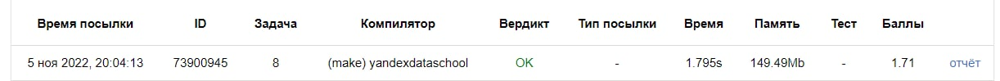